In [1]:
from src.utils import Models, DataType, make_features
import pandas as pd
import numpy as np

DATATYPE = DataType.BOTH

# Load csv data into pandas dataframes
if DATATYPE == DataType.PREGNANCY:
    exposome = pd.read_csv("data/preprocessed/preg_exposome.csv")
elif DATATYPE == DataType.POSTNATAL:
    exposome = pd.read_csv("data/preprocessed/postnatal_exposome.csv")
else:
    exposome = pd.read_csv("data/preprocessed/exposome.csv")
covariates = pd.read_csv("data/preprocessed/covariates.csv")
phenotype = pd.read_csv("data/preprocessed/phenotype.csv")

In [2]:
import optuna

from src.models.mlp import MLP
import tensorflow as tf

def define_model(trial):
    classification = (TARGET == Phenotypes.DIAGNOSED_ASTHMA or TARGET == Phenotypes.BODY_MASS_INDEX_CATEGORICAL)
    n_layers = trial.suggest_int("n_layers", 2, 6)
    dropout = trial.suggest_float("dropout", 0, 0.6, step=0.05)
    learning_rate = trial.suggest_float('lr', 2e-6, 1e-1, log=True)
    optimizer_type = trial.suggest_categorical("optimizer", ['Adam', 'RMSprop'])
    regularizer = trial.suggest_categorical("regularizer", ['None', 'l1', 'l2'])
    if regularizer == "None":
        regularizer = None
    
    # Select optimizer type
    if optimizer_type == "Adam":
        optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, name='Adam')
    else:
        momentum = trial.suggest_float('momentum', 0, 0.9)
        optimizer = tf.keras.optimizers.RMSprop(learning_rate=learning_rate, momentum=momentum, name='RMSprop')
    
    # Select network shape
    layers_sizes = ()
    for i in range(n_layers):
        hidden_size = trial.suggest_int(f"n_units_layers_{i}", 10, 500, step=10)
        layers_sizes = layers_sizes + (hidden_size,)
    
    model = MLP(layers_size=layers_sizes, 
                num_features=features.shape[1], 
                dropout=dropout,
                regularizer=regularizer,
                activation='elu',
                classifier=classification)
    if classification:
        loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False)
        metric_object, metric_name, mode = "accuracy", 'accuracy', 'max'
    else: # Classical regression task
        loss_object = tf.losses.MeanSquaredError()
        metric_object, metric_name, mode = tf.metrics.MeanAbsoluteError(), 'mean_absolute_error', 'min'
    model.compile(loss=loss_object, optimizer=optimizer, metrics=[metric_object])
    
    callbacks = [tf.keras.callbacks.EarlyStopping(monitor=metric_name,
                                              patience=10,
                                              min_delta=0.0002,
                                              mode=mode,
                                              verbose=0, 
                                              restore_best_weights=True)
                ]

    return model, callbacks

In [3]:
from sklearn.model_selection import KFold
import torch
import imblearn
from src.insights import print_classification_metrics
from sklearn.feature_selection import SelectFwe, SelectFromModel, SelectKBest, VarianceThreshold
from sklearn.feature_selection import f_regression
from sklearn.feature_selection import f_regression, f_classif
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier

def objective_cv(trial):
    cv = KFold(n_splits=5, shuffle=True, random_state=42)
    
    scores = []
    for train_fold_index, val_fold_index in cv.split(features, target):        
        # Get the training data
        X_train_fold, y_train_fold = features.iloc[train_fold_index], target[train_fold_index]
        # Get the validation data
        X_val_fold, y_val_fold = features.iloc[val_fold_index], target[val_fold_index]
        
        # Standardize data
        features_mean = X_train_fold.mean()
        features_std = X_train_fold.std()
        X_train_fold = (X_train_fold - features_mean) / features_std
        X_val_fold = (X_val_fold - features_mean) / features_std
        
        classification = True
        if TARGET != Phenotypes.BODY_MASS_INDEX_CATEGORICAL and TARGET != Phenotypes.DIAGNOSED_ASTHMA:
            labels_mean = y_train_fold.mean()
            labels_std = y_train_fold.std()
            y_train_fold = (y_train_fold - labels_mean) / labels_std
            y_val_fold = (y_val_fold - labels_mean) / labels_std
            classification = False
        
        feature_selector = trial.suggest_categorical('feature_selector', ["None", "fwe", "kbest", "tree", "corr"])
        # Feature selection
        if feature_selector == "fwe":
            transform_alpha = trial.suggest_float('transformer_alpha', 0.05, 1, step=0.05)
            feature_selector = SelectFwe(f_regression, alpha=transform_alpha).fit(X_train_fold, y_train_fold)
            X_train_fold = feature_selector.transform(X_train_fold)
            X_val_fold = feature_selector.transform(X_val_fold)
        elif feature_selector == "kbest":
            k = trial.suggest_int('k', 100, 200, step=20)
            score_func = f_regression
            if classification:
                score_func = f_classif
            features_selector = SelectKBest(score_func=score_func, k=k)
            features_selector = features_selector.fit(X_train_fold,y_train_fold)
            X_train_fold = features_selector.transform(X_train_fold)
            X_val_fold = features_selector.transform(X_val_fold)
        elif feature_selector == "tree":
            clf = RandomForestRegressor(n_estimators=100).fit(X_train_fold, y_train_fold)
            if classification:
                clf = RandomForestClassifier(n_estimators=100).fit(X_train_fold, y_train_fold)
                features_selector = SelectFromModel(clf, prefit=True)
                X_train_fold = features_selector.transform(X_train_fold)
                X_val_fold = features_selector.transform(X_val_fold)
        elif feature_selector == "corr":
            threshold = trial.suggest_float("threshold", 0.2, 1, step=0.1)
            col_corr = set()
            corr_matrix = X_train_fold.corr()
            for i in range(len(corr_matrix.columns)):
                for j in range(i):
                    if abs(corr_matrix.iloc[i, j]) > threshold:
                        colname = corr_matrix.columns[i]
                        col_corr.add(colname)
            X_train_fold = X_train_fold.drop(col_corr, axis = 1)
            X_val_fold = X_val_fold.drop(col_corr, axis = 1)
        
        # Oversampling
        if classification:
            if TARGET == Phenotypes.DIAGNOSED_ASTHMA:
                sampling_strat = 0.5
            elif TARGET == Phenotypes.BODY_MASS_INDEX_CATEGORICAL:
                sampling_strat = {0: np.max(np.bincount(y_train_fold))//4,
                                  1: np.max(np.bincount(y_train_fold)),
                                  2: np.max(np.bincount(y_train_fold)),
                                  3: np.max(np.bincount(y_train_fold))//2}
            else:
                raise SystemExit("Target non categorical:", TARGET.name)
            oversampler = imblearn.over_sampling.RandomOverSampler(sampling_strategy=sampling_strat,
                                                                   random_state=42)
            X_train_fold, y_train_fold = oversampler.fit_resample(X_train_fold, y_train_fold)
        
        # Train and predict
        model, callbacks = define_model(trial)
        model.fit(X_train_fold, y_train_fold, 
                  epochs=1000, 
                  batch_size=64, 
                  verbose=0, 
                  validation_split=0.2,
                  callbacks=callbacks)
        predictions = model.predict(X_val_fold)
        if classification:
            predictions = np.argmax(predictions, axis=1)
        
        # Inverse transform
        if not classification:
            predictions = (predictions * labels_std) + labels_mean
            y_val_fold = (y_val_fold * labels_std) + labels_mean
            
        if TARGET == Phenotypes.DIAGNOSED_ASTHMA or TARGET == Phenotypes.BODY_MASS_INDEX_CATEGORICAL:
            acc, macro_roc_auc_ovr, weighted_roc_auc_ovr = print_classification_metrics(ground_truth=y_val_fold,
                                                                                        predictions=predictions,
                                                                                        num_classes=target.nunique(),
                                                                                        verbose=False)
            scores.append(macro_roc_auc_ovr)
        else:
            absolute_error = abs(y_val_fold - predictions)
            mae = round(np.mean(absolute_error), 2)
            scores.append(mae)
    return np.mean(scores)

## IQ

In [4]:
from src.utils import Phenotypes

TARGET = Phenotypes.IQ

# Drop IQ covariates
# Post natal
# covariates.drop('hs_child_age_None', axis=1, inplace=True)
# covariates.drop('hs_c_height_None', axis=1, inplace=True)
# covariates.drop('hs_c_weight_None', axis=1, inplace=True)

# pregnancy
# covariates.drop('e3_yearbir_None', axis=1, inplace=True)

# Make features and target dataframes
features = make_features(exposome, covariates, phenotype)
target = features[TARGET.value]
features = features.drop(phenotype.columns, axis = 1)

print('target_name: ', target.name)

joining dataframes on same ID
dataframe of:
  * 1301 rows total
  * 264 features total
target_name:  hs_correct_raven


In [5]:
# from sklearn.decomposition import PCA

# pca = PCA(n_components=40, svd_solver="full", random_state=42)
# pca.fit(features)
# print(features.shape)
# print(pca.n_components_)
# print(pca.explained_variance_ratio_)
# features = pca.transform(features)
# features = pd.DataFrame(features)

### Launch bayesian optimization (with TPE sampler)

In [5]:
from optuna.trial import TrialState

direction = 'maximize'
if TARGET != Phenotypes.BODY_MASS_INDEX_CATEGORICAL and TARGET != Phenotypes.DIAGNOSED_ASTHMA:
    direction = 'minimize'
    
study = optuna.create_study(direction=direction)
study.optimize(objective_cv, n_trials=1000, timeout=None, n_jobs=1, gc_after_trial=False)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

print("Best trial:")
trial = study.best_trial

print("  Value: ", trial.value)

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

[I 2021-04-24 15:11:09,715] A new study created in memory with name: no-name-e116fddb-71f7-46b5-b2fd-94fca9226530
[I 2021-04-24 15:11:38,551] Trial 0 finished with value: 3.7060000000000004 and parameters: {'feature_selector': 'fwe', 'transformer_alpha': 0.9500000000000001, 'n_layers': 3, 'dropout': 0.55, 'lr': 1.1735168570327333e-05, 'optimizer': 'RMSprop', 'regularizer': 'l1', 'momentum': 0.09693213710426297, 'n_units_layers_0': 430, 'n_units_layers_1': 210, 'n_units_layers_2': 500}. Best is trial 0 with value: 3.7060000000000004.
[I 2021-04-24 15:12:06,552] Trial 1 finished with value: 3.6719999999999997 and parameters: {'feature_selector': 'None', 'n_layers': 2, 'dropout': 0.25, 'lr': 0.0013256873792002733, 'optimizer': 'RMSprop', 'regularizer': 'l2', 'momentum': 0.07170201055773849, 'n_units_layers_0': 270, 'n_units_layers_1': 170}. Best is trial 1 with value: 3.6719999999999997.
[I 2021-04-24 15:13:05,779] Trial 2 finished with value: 3.5340000000000003 and parameters: {'feature_

Study statistics: 
  Number of finished trials:  1000
  Number of pruned trials:  0
  Number of complete trials:  1000
Best trial:
  Value:  3.314
  Params: 
    feature_selector: kbest
    k: 120
    n_layers: 6
    dropout: 0.6
    lr: 0.00012788548413019183
    optimizer: RMSprop
    regularizer: l2
    momentum: 0.4221237228805783
    n_units_layers_0: 140
    n_units_layers_1: 40
    n_units_layers_2: 370
    n_units_layers_3: 180
    n_units_layers_4: 470
    n_units_layers_5: 280


### Save parameters

In [16]:
import configparser

config = configparser.ConfigParser()
config.read('config/config_mlp.ini')

params = {
    'feature_selector': 'None',
    'transformer_alpha': -1,
    'k': -1,
    'threshold': -1,
    
    'n_units' : (100,),
    'learning_rate' : 0.01,
    'momentum': -1,
    'regularizer': 'None',
    'dropout': 0,
    'optimizer': "Adam",
    'value': -1,
}

config['DEFAULT'] = params
params['n_layers'] = dict(trial.params.items())['n_layers']

n_units = ""
for i in range(params['n_layers']):
    n_units = n_units + str(dict(trial.params.items())[f"n_units_layers_{i}"]) + ', '
params['feature_selector'] = dict(trial.params.items())["feature_selector"]
if params['feature_selector'] == 'fwe':
    params['transformer_alpha'] =  dict(trial.params.items())['transformer_alpha']
elif params['feature_selector'] == 'kbest':
    params['k'] =  dict(trial.params.items())['k']
optimizer = dict(trial.params.items())["optimizer"]
params['optimizer'] = optimizer
if optimizer == 'RMSprop':
    params['momentum'] = dict(trial.params.items())["momentum"]

params['n_units'] = n_units
params['learning_rate'] = dict(trial.params.items())['lr']
params['dropout'] =  dict(trial.params.items())['dropout']
params['regularizer'] =  dict(trial.params.items())['regularizer']
params['value'] = trial.value
print(params)
config['IQ'] = params

with open('config/config_mlp.ini', 'w') as configfile:
    config.write(configfile)

{'feature_selector': 'kbest', 'transformer_alpha': -1, 'k': 140, 'threshold': -1, 'n_units': '320, 10, 250, 110, 460, 80, ', 'learning_rate': 3.730306156982876e-05, 'momentum': 0.6042497035335351, 'regularizer': 'l1', 'dropout': 0.5, 'optimizer': 'RMSprop', 'value': 3.3120000000000003, 'n_layers': 6}


## Body Mass Index

In [4]:
from src.utils import Phenotypes

TARGET = Phenotypes.BODY_MASS_INDEX

# Drop IQ covariates
# Post natal
# covariates.drop('hs_child_age_None', axis=1, inplace=True)
covariates.drop('hs_c_height_None', axis=1, inplace=True)
covariates.drop('hs_c_weight_None', axis=1, inplace=True)

# pregnancy
covariates.drop('e3_yearbir_None', axis=1, inplace=True)

# Make features and target dataframes
features = make_features(exposome, covariates, phenotype)
target = features[TARGET.value]
features = features.drop(phenotype.columns, axis = 1)

print('target_name: ', target.name)

joining dataframes on same ID
dataframe of:
  * 1301 rows total
  * 261 features total
target_name:  hs_zbmi_who


### Launch bayesian optimization (with TPE sampler)

In [ ]:
from optuna.trial import TrialState

direction = 'maximise'
if TARGET != Phenotypes.BODY_MASS_INDEX_CATEGORICAL and TARGET != Phenotypes.DIAGNOSED_ASTHMA:
    direction = 'minimize'
    
study = optuna.create_study(direction=direction)
study.optimize(objective_cv, n_trials=1000, timeout=None, n_jobs=1, gc_after_trial=False)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

print("Best trial:")
trial = study.best_trial

print("  Value: ", trial.value)

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

[I 2021-04-18 20:03:35,715] A new study created in memory with name: no-name-5ba1a01e-eb62-4620-b9fb-a8b743a5cbf3
[I 2021-04-18 20:03:53,918] Trial 0 finished with value: 0.852 and parameters: {'transformer_alpha': 0.47282730013011587, 'alpha': 0.042988012076007144, 'n_layers': 5, 'n_units_layers_0': 435, 'n_units_layers_1': 164, 'n_units_layers_2': 234, 'n_units_layers_3': 39, 'n_units_layers_4': 71, 'lr': 8.652049975924959e-05}. Best is trial 0 with value: 0.852.
[I 2021-04-18 20:04:09,988] Trial 1 finished with value: 0.842 and parameters: {'transformer_alpha': 0.028631321893758943, 'alpha': 0.05315293900208567, 'n_layers': 4, 'n_units_layers_0': 393, 'n_units_layers_1': 271, 'n_units_layers_2': 182, 'n_units_layers_3': 288, 'lr': 0.004402793872778822}. Best is trial 1 with value: 0.842.
[I 2021-04-18 20:04:42,915] Trial 2 finished with value: 0.8520000000000001 and parameters: {'transformer_alpha': 0.42930738727945206, 'alpha': 2.931281286005658e-06, 'n_layers': 3, 'n_units_layers_

### Save parameters

In [10]:
# [I 2021-04-18 21:38:28,216] Trial 124 finished with value: 0.8139999999999998 and parameters: {'transformer_alpha': 0.0025654071775451995, 'alpha': 0.0006572532552978203, 'n_layers': 3, 'n_units_layers_0': 491, 'n_units_layers_1': 54, 'n_units_layers_2': 185, 'lr': 4.106628297478395e-06}. Best is trial 124 with value: 0.8139999999999998.
import configparser

config = configparser.ConfigParser()
config.read('config/config_mlp.ini')

n_layers = dict(trial.params.items())['n_layers']
n_units = ""
for i in range(n_layers):
    n_units = n_units + str(dict(trial.params.items())[f"n_units_layers_{i}"]) + ', '

params = {
    'n_layers' : n_layers,
    'n_units' : n_units,
    'learning_rate' : dict(trial.params.items())['lr'],
    'alpha': dict(trial.params.items())['alpha'],
    'value' : trial.value
}
print(params)
config['BODY_MASS_INDEX'] = params

with open('config/config_mlp.ini', 'w') as configfile:
    config.write(configfile)

{'n_layers': 3, 'n_units': '351, 188, 420, ', 'learning_rate': 2.6578826261488505e-05, 'alpha': 8.895584529348441e-05, 'value': 0.8099999999999999}


## Birth Weight

In [ ]:
from src.utils import Phenotypes

TARGET = Phenotypes.BIRTH_WEIGHT

# Make features and target dataframes
features = make_features(exposome, covariates, phenotype)
target = features[TARGET.value]
features = features.drop(phenotype.columns, axis = 1)

print('target_name: ', target.name)

In [ ]:
from optuna.trial import TrialState

direction = 'maximize'
if TARGET != Phenotypes.BODY_MASS_INDEX_CATEGORICAL and TARGET != Phenotypes.DIAGNOSED_ASTHMA:
    direction = 'minimize'
    
study = optuna.create_study(direction=direction)
study.optimize(objective_cv, n_trials=1000, timeout=None, n_jobs=1, gc_after_trial=False)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

print("Best trial:")
trial = study.best_trial

print("  Value: ", trial.value)

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

In [ ]:
import configparser

config = configparser.ConfigParser()
config.read('config/config_mlp.ini')

params = {
    'feature_selector': 'None',
    'transformer_alpha': -1,
    'k': -1,
    'threshold': -1,
    
    'n_units' : (100,),
    'learning_rate' : 0.01,
    'momentum': -1,
    'regularizer': 'None',
    'dropout': 0,
    'optimizer': "Adam",
    'value': -1,
}

config['DEFAULT'] = params
params['n_layers'] = dict(trial.params.items())['n_layers']

n_units = ""
for i in range(params['n_layers']):
    n_units = n_units + str(dict(trial.params.items())[f"n_units_layers_{i}"]) + ', '
params['feature_selector'] = dict(trial.params.items())["feature_selector"]
if params['feature_selector'] == 'fwe':
    params['transformer_alpha'] =  dict(trial.params.items())['transformer_alpha']
elif params['feature_selector'] == 'kbest':
    params['k'] =  dict(trial.params.items())['k']
optimizer = dict(trial.params.items())["optimizer"]
params['optimizer'] = optimizer
if optimizer == 'RMSprop':
    params['momentum'] = dict(trial.params.items())["momentum"]

params['n_units'] = n_units
params['learning_rate'] = dict(trial.params.items())['lr']
params['dropout'] =  dict(trial.params.items())['dropout']
params['regularizer'] =  dict(trial.params.items())['regularizer']
params['value'] = trial.value
print(params)
config['BIRTH_WEIGHT'] = params

with open('config/config_mlp.ini', 'w') as configfile:
    config.write(configfile)

# Categorical predictions case

## Body Mass Index Categorical

In [4]:
from src.utils import Phenotypes

TARGET = Phenotypes.BODY_MASS_INDEX_CATEGORICAL
CLASSES = 4


covariates.drop('hs_c_height_None', axis=1, inplace=True)
covariates.drop('hs_c_weight_None', axis=1, inplace=True)

# Make features and target dataframes
features = make_features(exposome, covariates, phenotype)
target = features[TARGET.value]
features = features.drop(phenotype.columns, axis = 1)
print('target_name: ', target.name)

joining dataframes on same ID
dataframe of:
  * 1301 rows total
  * 262 features total
target_name:  hs_bmi_c_cat


### Launch bayesian optimization (with TPE sampler)

[I 2021-04-20 10:21:15,687] A new study created in memory with name: no-name-956980ff-5904-4b7b-a4c7-09e2fc1a18ab


Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 149  28   8]
 [  0  28   9   5]
 [  0  18  11   4]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.535923 (macro),
0.573240 (weighted by prevalence)


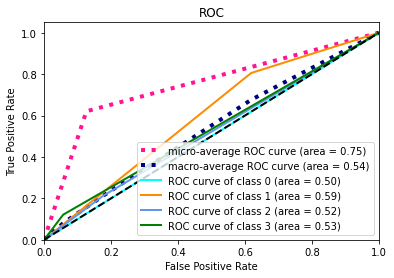

Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   1]
 [  1 146  22   6]
 [  0  45  11   9]
 [  0  10   6   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.530278 (macro),
0.563798 (weighted by prevalence)


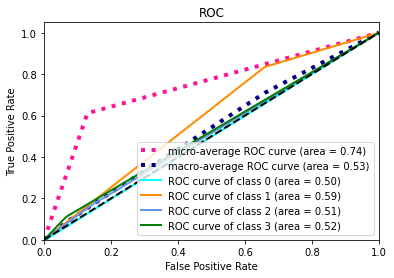

Accuracy: 61.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 144  31   9]
 [  0  30   6  11]
 [  0  10   5   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555983 (macro),
0.581299 (weighted by prevalence)


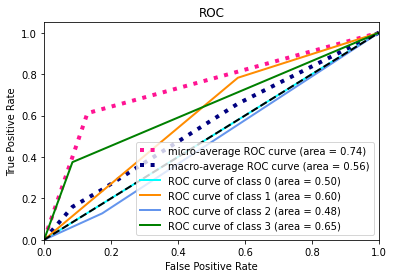

Accuracy: 61.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 144  29   8]
 [  0  35   9   3]
 [  0  17   7   5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.530831 (macro),
0.543582 (weighted by prevalence)


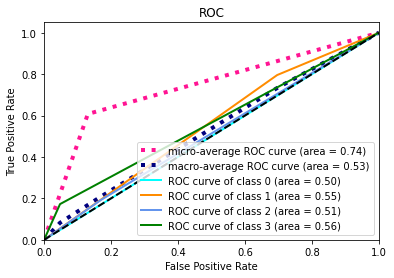

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 134  32  13]
 [  0  36   9   7]
 [  0  15   8   4]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.517170 (macro),
0.533767 (weighted by prevalence)


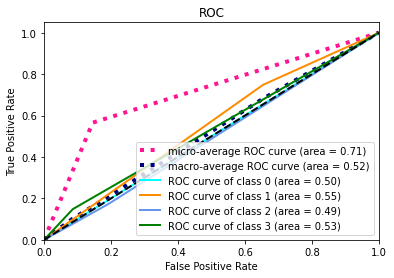

[I 2021-04-20 10:22:40,701] Trial 0 finished with value: 0.5340370439115878 and parameters: {'transformer_alpha': 0.2000767398624793, 'alpha': 0.005241364907155868, 'n_layers': 3, 'n_units_layers_0': 333, 'n_units_layers_1': 426, 'n_units_layers_2': 148, 'lr': 0.00022830487718478168}. Best is trial 0 with value: 0.5340370439115878.


Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 148  28   9]
 [  0  29   8   5]
 [  0  15  10   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550734 (macro),
0.586488 (weighted by prevalence)


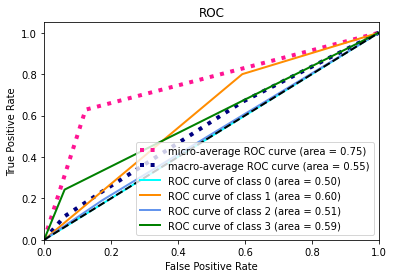

Accuracy: 57.0
Confusion matrix: 
[[  0   1   0   1]
 [  1 132  28  14]
 [  0  37  15  13]
 [  0  10   6   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.529690 (macro),
0.570678 (weighted by prevalence)


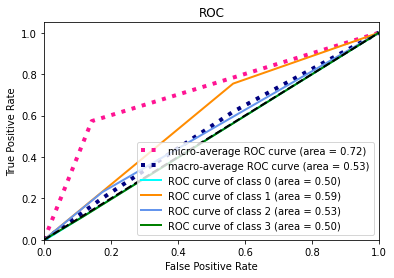

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 142  34   8]
 [  0  34   7   6]
 [  0   9   7   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.547385 (macro),
0.562537 (weighted by prevalence)


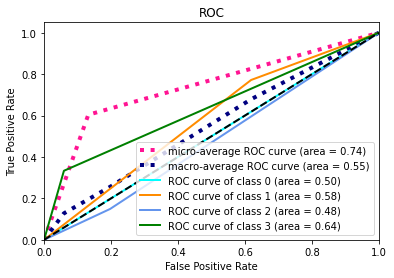

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  1 121  49  10]
 [  0  31  12   4]
 [  0   9  16   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.518474 (macro),
0.543017 (weighted by prevalence)


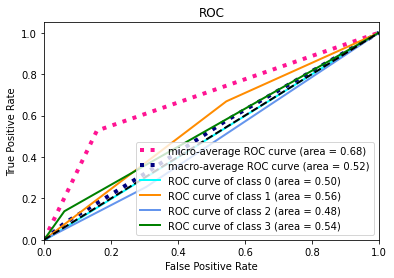

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 138  34   7]
 [  0  38   9   5]
 [  0  18   7   2]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.506679 (macro),
0.517667 (weighted by prevalence)


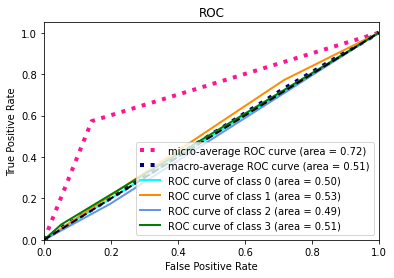

[I 2021-04-20 10:25:31,607] Trial 1 finished with value: 0.5305926981647501 and parameters: {'transformer_alpha': 0.46148465782642833, 'alpha': 1.9423051070313402e-06, 'n_layers': 5, 'n_units_layers_0': 459, 'n_units_layers_1': 384, 'n_units_layers_2': 157, 'n_units_layers_3': 422, 'n_units_layers_4': 268, 'lr': 0.008663008581936674}. Best is trial 0 with value: 0.5340370439115878.


Accuracy: 62.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 133  41  11]
 [  0  16  23   3]
 [  0   8  19   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.599078 (macro),
0.672134 (weighted by prevalence)


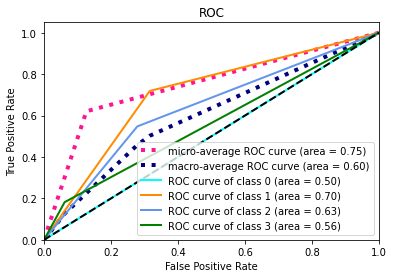

Accuracy: 52.0
Confusion matrix: 
[[ 0  0  2  0]
 [ 0 90 85  0]
 [ 0 21 44  0]
 [ 0  3 15  0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.548222 (macro),
0.597285 (weighted by prevalence)


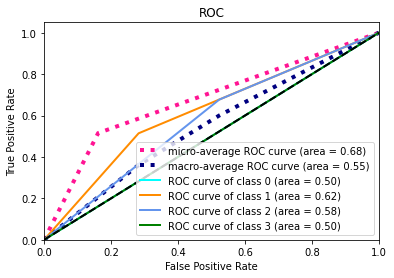

Accuracy: 16.0
Confusion matrix: 
[[  1   0   3   1]
 [  8   1 154  21]
 [  5   0  36   6]
 [  2   0  19   3]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.511579 (macro),
0.498121 (weighted by prevalence)


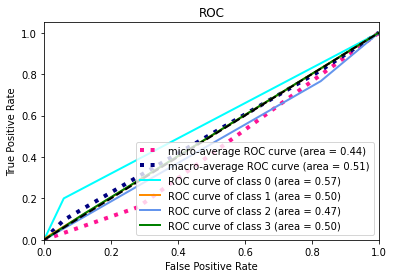

Accuracy: 52.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 111  69   1]
 [  0  22  24   1]
 [  0  10  19   0]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.532382 (macro),
0.567579 (weighted by prevalence)


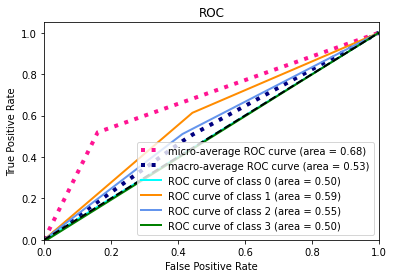

Accuracy: 44.0
Confusion matrix: 
[[ 0  0  2  0]
 [ 0 87 90  2]
 [ 0 24 27  1]
 [ 0  8 19  0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.507959 (macro),
0.529204 (weighted by prevalence)


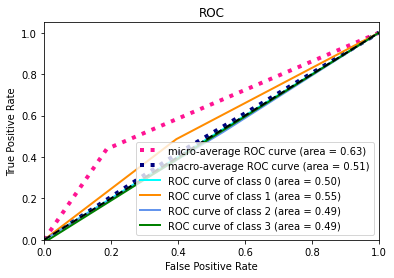

[I 2021-04-20 10:28:09,470] Trial 2 finished with value: 0.5398441613338465 and parameters: {'transformer_alpha': 0.9484052876509957, 'alpha': 0.03568369752665494, 'n_layers': 4, 'n_units_layers_0': 144, 'n_units_layers_1': 334, 'n_units_layers_2': 369, 'n_units_layers_3': 65, 'lr': 2.1126580333103286e-06}. Best is trial 2 with value: 0.5398441613338465.


Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 143  30  11]
 [  0  29  10   3]
 [  0  16  12   5]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537536 (macro),
0.568853 (weighted by prevalence)


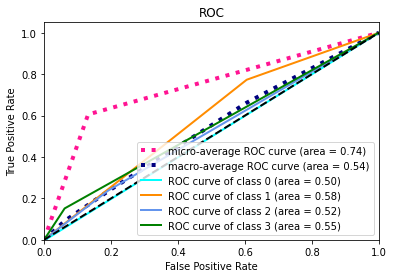

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 139  28   8]
 [  0  38  19   8]
 [  0   9   6   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555369 (macro),
0.594846 (weighted by prevalence)


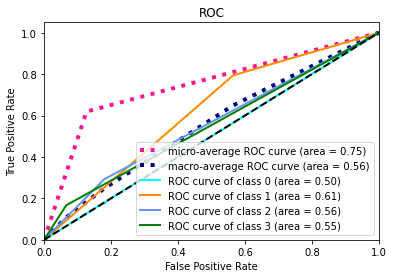

Accuracy: 60.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 139  33  12]
 [  0  29   7  11]
 [  0  10   4  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558865 (macro),
0.574943 (weighted by prevalence)


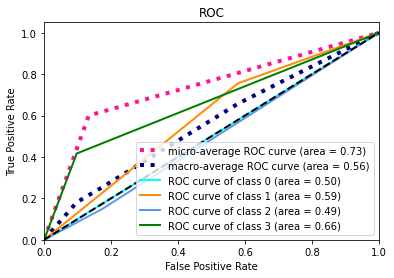

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 132  39  10]
 [  0  29  11   7]
 [  0  10  13   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540106 (macro),
0.575315 (weighted by prevalence)


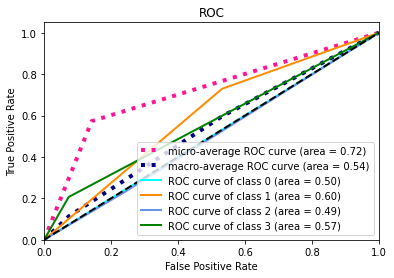

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 131  39   9]
 [  0  32  13   7]
 [  0   9   9   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560609 (macro),
0.584849 (weighted by prevalence)


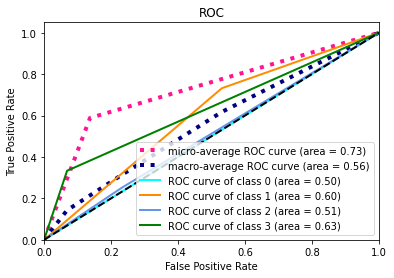

[I 2021-04-20 10:28:49,856] Trial 3 finished with value: 0.5504972364917066 and parameters: {'transformer_alpha': 0.21493993753367402, 'alpha': 0.0009836479168295559, 'n_layers': 2, 'n_units_layers_0': 187, 'n_units_layers_1': 220, 'lr': 0.0001675263859776419}. Best is trial 3 with value: 0.5504972364917066.


Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 146  34   5]
 [  0  26  13   3]
 [  1  19   7   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556140 (macro),
0.584294 (weighted by prevalence)


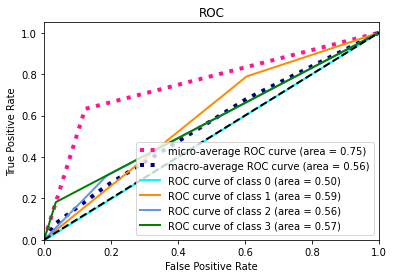

Accuracy: 62.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 144  25   5]
 [  0  42  13  10]
 [  0  10   4   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549401 (macro),
0.575064 (weighted by prevalence)


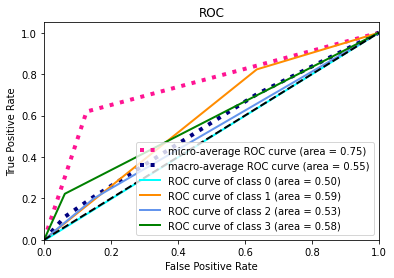

Accuracy: 63.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 146  27  11]
 [  0  29  11   7]
 [  0  12   5   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560927 (macro),
0.584115 (weighted by prevalence)


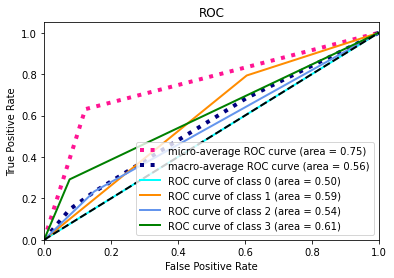

Accuracy: 63.0
Confusion matrix: 
[[  0   3   0   0]
 [  1 147  24   9]
 [  1  34  10   2]
 [  0  15   8   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545994 (macro),
0.568068 (weighted by prevalence)


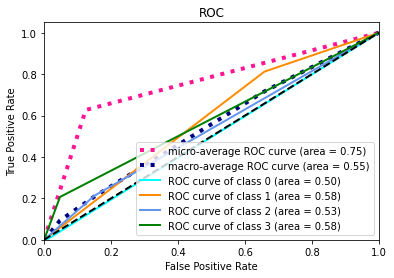

Accuracy: 62.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 140  26  13]
 [  0  34  13   5]
 [  0   8  11   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566259 (macro),
0.600826 (weighted by prevalence)


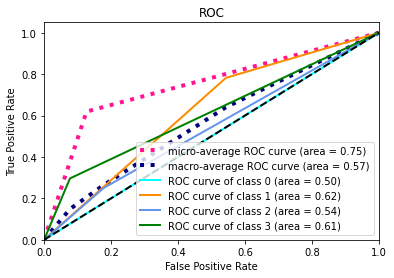

[I 2021-04-20 10:29:07,903] Trial 4 finished with value: 0.5557442687005014 and parameters: {'transformer_alpha': 0.46934103673818683, 'alpha': 0.00013403882864745323, 'n_layers': 4, 'n_units_layers_0': 51, 'n_units_layers_1': 439, 'n_units_layers_2': 25, 'n_units_layers_3': 24, 'lr': 0.0009927672723916035}. Best is trial 4 with value: 0.5557442687005014.


Accuracy: 64.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 150  25   9]
 [  0  26  11   5]
 [  0  17   9   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560674 (macro),
0.600276 (weighted by prevalence)


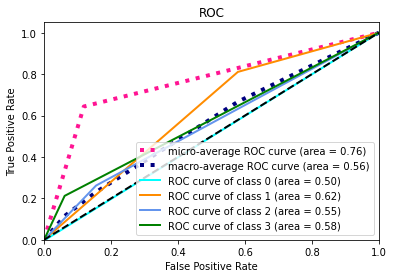

Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   1]
 [  2 142  24   7]
 [  0  46  11   8]
 [  0  11   2   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.546110 (macro),
0.555223 (weighted by prevalence)


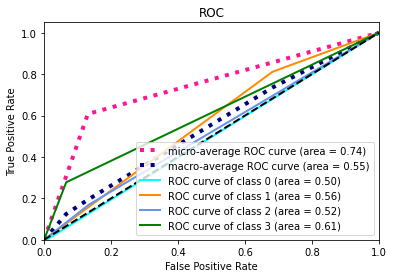

Accuracy: 62.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 140  34  10]
 [  0  25  13   9]
 [  0  10   5   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577818 (macro),
0.605039 (weighted by prevalence)


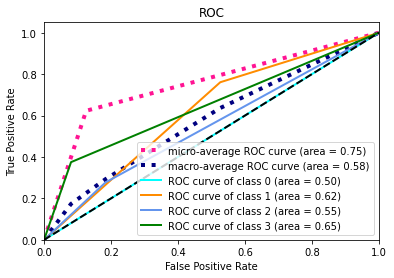

Accuracy: 60.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 136  33  12]
 [  0  27  17   3]
 [  0  12  13   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555804 (macro),
0.597710 (weighted by prevalence)


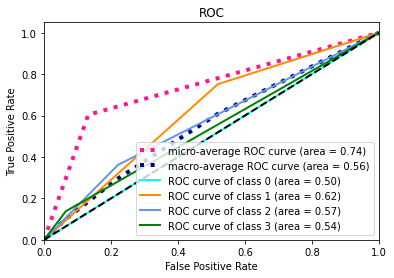

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  2 135  33   9]
 [  0  31  14   7]
 [  0  13   9   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545295 (macro),
0.576877 (weighted by prevalence)


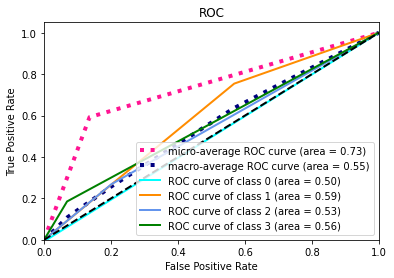

[I 2021-04-20 10:29:50,526] Trial 5 finished with value: 0.5571402271273649 and parameters: {'transformer_alpha': 0.04741785984971125, 'alpha': 0.0016585932678807893, 'n_layers': 2, 'n_units_layers_0': 215, 'n_units_layers_1': 278, 'lr': 0.00028192191763097834}. Best is trial 5 with value: 0.5571402271273649.


Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 139  37   9]
 [  0  23  15   4]
 [  0  16   7  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.578410 (macro),
0.607877 (weighted by prevalence)


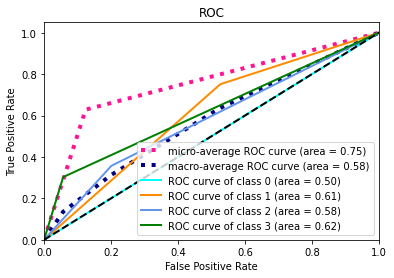

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 131  39   5]
 [  0  36  19  10]
 [  0   6   5   7]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.578892 (macro),
0.600682 (weighted by prevalence)


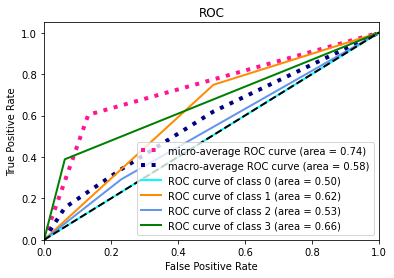

Accuracy: 59.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 135  40   9]
 [  0  24  11  12]
 [  0  12   5   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553518 (macro),
0.584369 (weighted by prevalence)


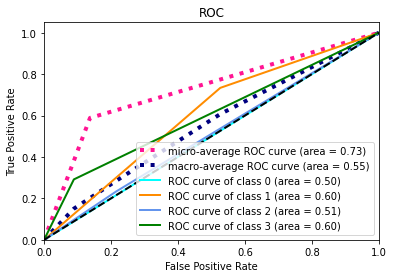

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   1]
 [  1 125  45  10]
 [  0  28  14   5]
 [  0  11   9   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556645 (macro),
0.577168 (weighted by prevalence)


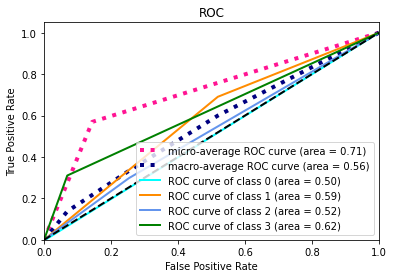

Accuracy: 60.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 131  37  11]
 [  0  27  18   7]
 [  0   9  10   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575243 (macro),
0.613825 (weighted by prevalence)


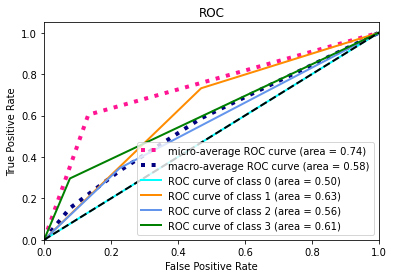

[I 2021-04-20 10:36:43,209] Trial 6 finished with value: 0.5685414738513479 and parameters: {'transformer_alpha': 0.12388629280772012, 'alpha': 0.005066035734165234, 'n_layers': 3, 'n_units_layers_0': 89, 'n_units_layers_1': 490, 'n_units_layers_2': 282, 'lr': 1.4571828263777002e-05}. Best is trial 6 with value: 0.5685414738513479.


Accuracy: 71.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 185   0   0]
 [  0  42   0   0]
 [  0  33   0   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


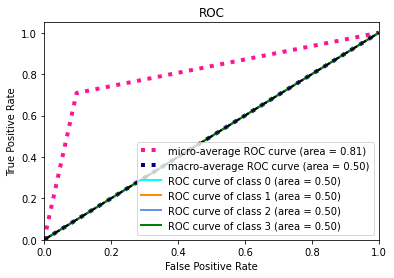

Accuracy: 25.0
Confusion matrix: 
[[  0   0   2   0]
 [  0   0 175   0]
 [  0   0  65   0]
 [  0   0  18   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


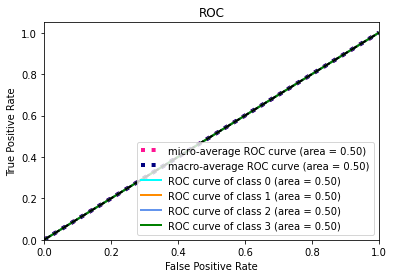

Accuracy: 71.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 184   0   0]
 [  0  47   0   0]
 [  0  24   0   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


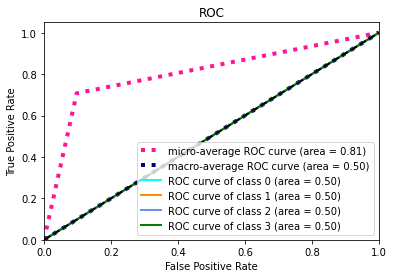

Accuracy: 70.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 181   0   0]
 [  0  47   0   0]
 [  0  29   0   0]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


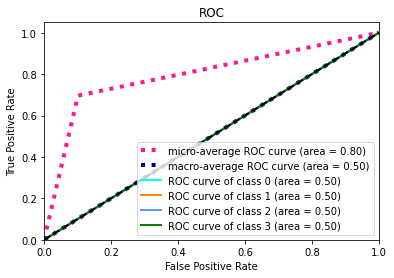

Accuracy: 20.0
Confusion matrix: 
[[  0   0   2   0]
 [  0   0 179   0]
 [  0   0  52   0]
 [  0   0  27   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


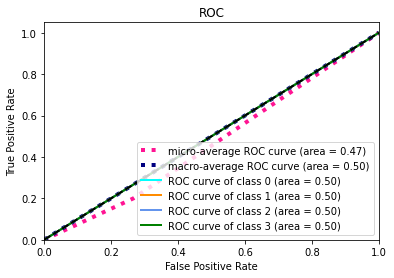

[I 2021-04-20 10:37:07,860] Trial 7 finished with value: 0.5 and parameters: {'transformer_alpha': 0.8877041215263166, 'alpha': 0.000705663382871135, 'n_layers': 5, 'n_units_layers_0': 363, 'n_units_layers_1': 286, 'n_units_layers_2': 34, 'n_units_layers_3': 57, 'n_units_layers_4': 487, 'lr': 0.06646757126598477}. Best is trial 6 with value: 0.5685414738513479.


Accuracy: 64.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 151  27   7]
 [  0  28  10   4]
 [  0  19   7   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553920 (macro),
0.582462 (weighted by prevalence)


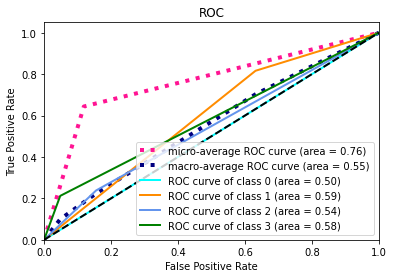

Accuracy: 64.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 148  21   6]
 [  0  41  15   9]
 [  0  10   5   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553038 (macro),
0.590577 (weighted by prevalence)


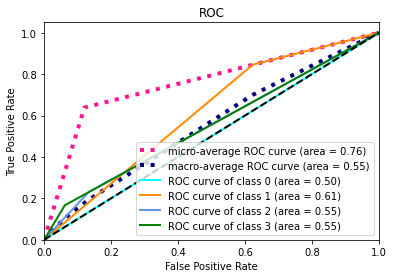

Accuracy: 62.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 143  32   9]
 [  0  29  11   7]
 [  0  12   5   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557014 (macro),
0.576616 (weighted by prevalence)


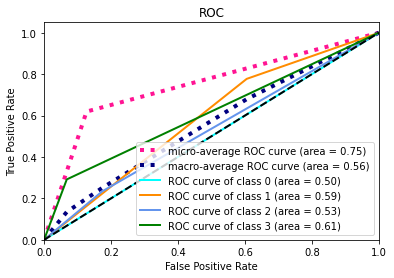

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 136  37   8]
 [  0  30  13   4]
 [  0  13  10   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.547499 (macro),
0.572558 (weighted by prevalence)


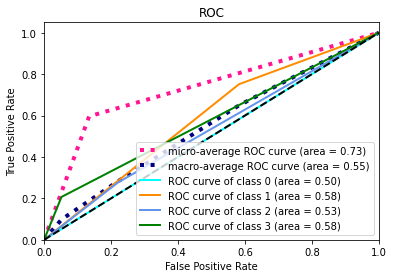

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 128  36  15]
 [  0  31  12   9]
 [  0  10  10   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544703 (macro),
0.576258 (weighted by prevalence)


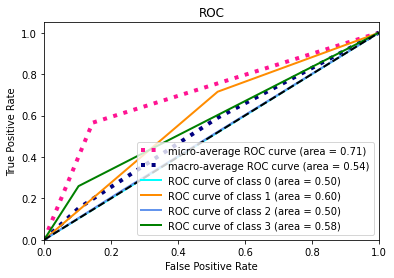

[I 2021-04-20 10:37:22,693] Trial 8 finished with value: 0.5512348254277057 and parameters: {'transformer_alpha': 0.42846636283422324, 'alpha': 0.00013641238834142695, 'n_layers': 2, 'n_units_layers_0': 208, 'n_units_layers_1': 58, 'lr': 0.0007927881169348062}. Best is trial 6 with value: 0.5685414738513479.


Accuracy: 62.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 142  36   6]
 [  0  29   9   4]
 [  0  13   9  11]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.563100 (macro),
0.594808 (weighted by prevalence)


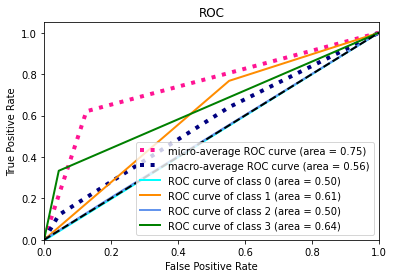

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 138  30   7]
 [  0  39  17   9]
 [  0   9   5   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555641 (macro),
0.586399 (weighted by prevalence)


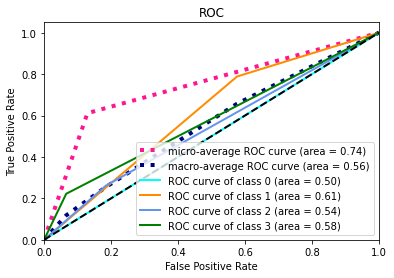

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 133  43   8]
 [  0  21  15  11]
 [  0   6  11   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573378 (macro),
0.626690 (weighted by prevalence)


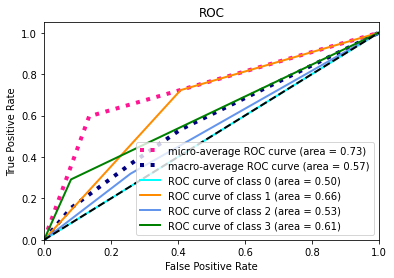

Accuracy: 58.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 122  52   7]
 [  0  23  19   5]
 [  0   9  11   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575730 (macro),
0.608601 (weighted by prevalence)


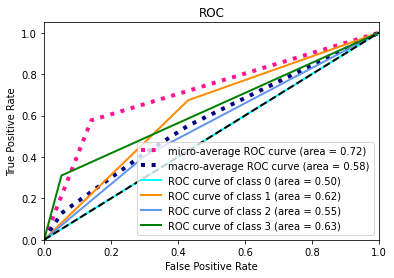

Accuracy: 62.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 134  35  10]
 [  1  27  15   9]
 [  0   8   6  13]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.597402 (macro),
0.630337 (weighted by prevalence)


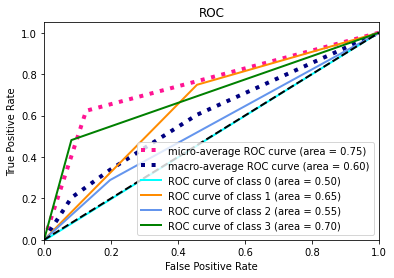

[I 2021-04-20 10:42:47,410] Trial 9 finished with value: 0.5730503092029174 and parameters: {'transformer_alpha': 0.14455921999997368, 'alpha': 0.005898868070450402, 'n_layers': 3, 'n_units_layers_0': 421, 'n_units_layers_1': 302, 'n_units_layers_2': 96, 'lr': 8.39716267555752e-06}. Best is trial 9 with value: 0.5730503092029174.


Accuracy: 61.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 130  48   7]
 [  0  21  18   3]
 [  0   7  16  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.590653 (macro),
0.645458 (weighted by prevalence)


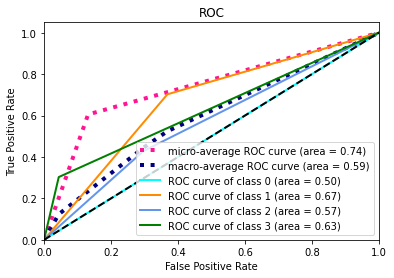

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 131  38   6]
 [  0  31  25   9]
 [  0   2   9   7]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.601742 (macro),
0.645931 (weighted by prevalence)


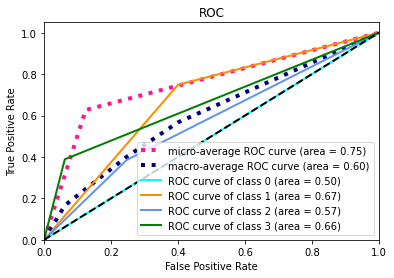

Accuracy: 58.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 119  56   9]
 [  0  21  20   6]
 [  0   4   9  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.596951 (macro),
0.622501 (weighted by prevalence)


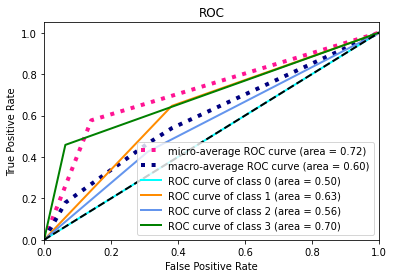

Accuracy: 52.0
Confusion matrix: 
[[ 0  3  0  0]
 [ 3 97 72  9]
 [ 0 12 32  3]
 [ 0  6 17  6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.584547 (macro),
0.626358 (weighted by prevalence)


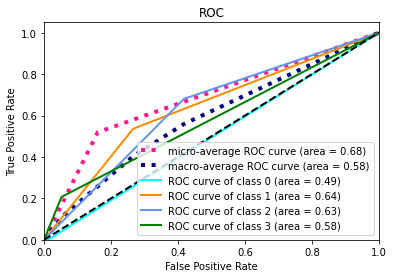

Accuracy: 49.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 102  68   9]
 [  0  22  21   9]
 [  0   3  20   4]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.536020 (macro),
0.583168 (weighted by prevalence)


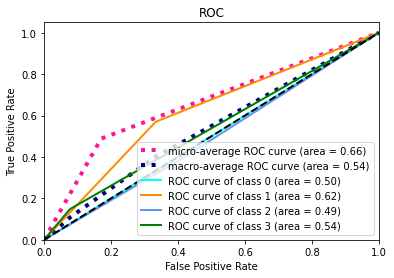

[I 2021-04-20 10:44:55,370] Trial 10 finished with value: 0.5819825875340439 and parameters: {'transformer_alpha': 0.7157695963594379, 'alpha': 0.09455853991035347, 'n_layers': 3, 'n_units_layers_0': 496, 'n_units_layers_1': 126, 'n_units_layers_2': 140, 'lr': 3.2599140111257624e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 50.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 107  77   1]
 [  0  18  24   0]
 [  0   5  28   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544846 (macro),
0.604482 (weighted by prevalence)


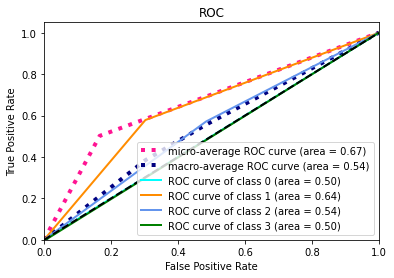

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 126  42   7]
 [  0  32  25   8]
 [  0   5   7   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.584062 (macro),
0.617274 (weighted by prevalence)


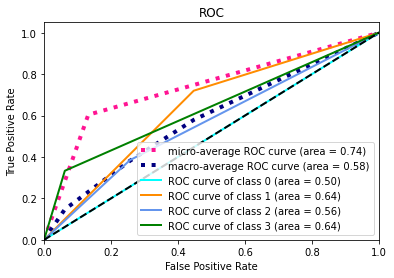

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 135  45   3]
 [  0  27  17   3]
 [  0  13   8   3]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544823 (macro),
0.569093 (weighted by prevalence)


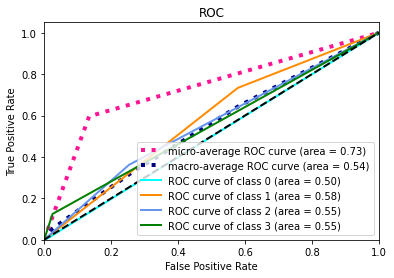

Accuracy: 54.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 112  59  10]
 [  0  17  25   5]
 [  0   7  18   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566048 (macro),
0.619877 (weighted by prevalence)


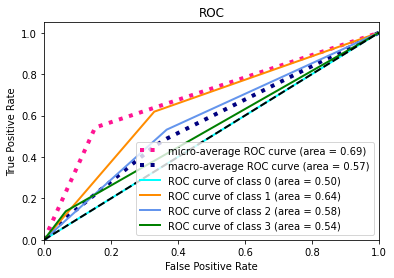

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 118  61   0]
 [  0  26  26   0]
 [  0   9  18   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540328 (macro),
0.581701 (weighted by prevalence)


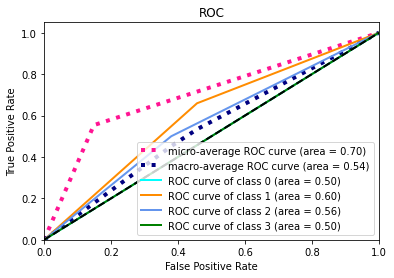

[I 2021-04-20 10:46:49,412] Trial 11 finished with value: 0.5560213910746341 and parameters: {'transformer_alpha': 0.7554216400752498, 'alpha': 0.0697995729165689, 'n_layers': 3, 'n_units_layers_0': 450, 'n_units_layers_1': 154, 'n_units_layers_2': 123, 'lr': 2.4540717138238557e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 56.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 133  40  11]
 [  0  29   6   7]
 [  0  15  10   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.525124 (macro),
0.548395 (weighted by prevalence)


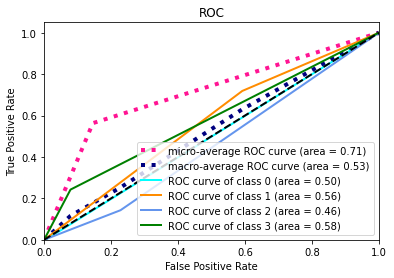

Accuracy: 51.0
Confusion matrix: 
[[ 0  0  2  0]
 [ 0 83 92  0]
 [ 0 14 50  1]
 [ 0  3 15  0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560051 (macro),
0.618447 (weighted by prevalence)


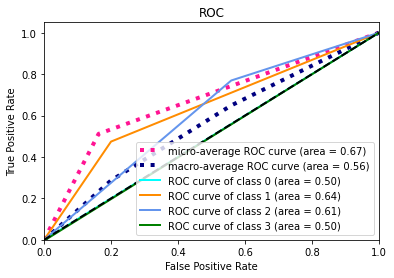

Accuracy: 62.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 137  40   6]
 [  0  23  14  10]
 [  0   5   8  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.597244 (macro),
0.638591 (weighted by prevalence)


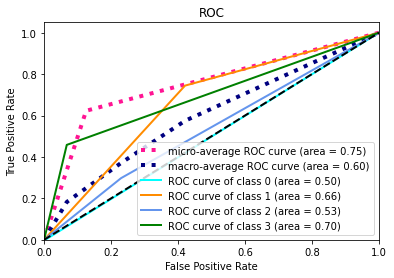

Accuracy: 58.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 135  38   8]
 [  2  34   9   2]
 [  0  11  10   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.541149 (macro),
0.557990 (weighted by prevalence)


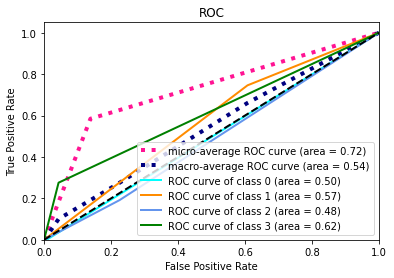

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 110  52  17]
 [  0  19  25   8]
 [  0   2  18   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.578346 (macro),
0.636107 (weighted by prevalence)


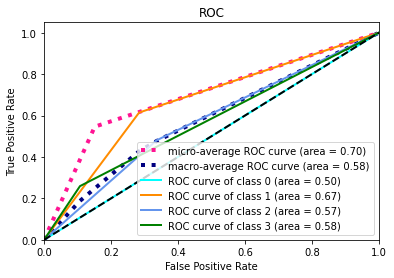

[I 2021-04-20 10:48:46,914] Trial 12 finished with value: 0.5603827761498773 and parameters: {'transformer_alpha': 0.6886513725207317, 'alpha': 0.09245827486056031, 'n_layers': 3, 'n_units_layers_0': 495, 'n_units_layers_1': 22, 'n_units_layers_2': 235, 'lr': 1.3697137072361378e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 64.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 150  28   7]
 [  0  24  11   7]
 [  0  15  13   5]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556162 (macro),
0.612533 (weighted by prevalence)


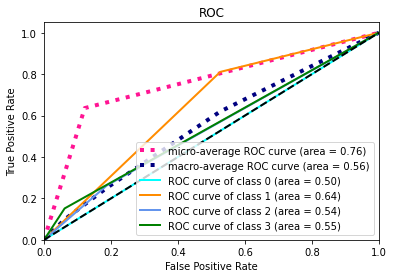

Accuracy: 60.0
Confusion matrix: 
[[  0   1   0   1]
 [  1 141  25   8]
 [  0  47  10   8]
 [  0  10   3   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542159 (macro),
0.549967 (weighted by prevalence)


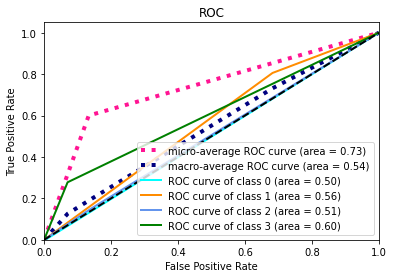

Accuracy: 63.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 143  31  10]
 [  0  24  13  10]
 [  0   8   7   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.585905 (macro),
0.629236 (weighted by prevalence)


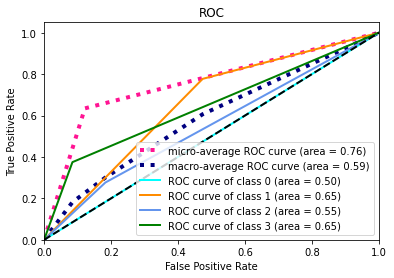

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 138  37   6]
 [  0  34  11   2]
 [  0  13   8   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549191 (macro),
0.560594 (weighted by prevalence)


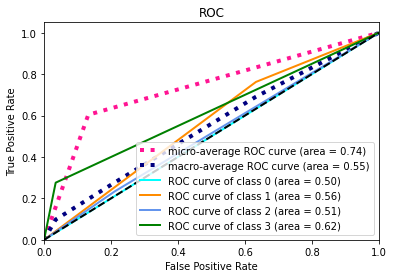

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 135  36   7]
 [  0  31  10  11]
 [  0   9   9   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557980 (macro),
0.592003 (weighted by prevalence)


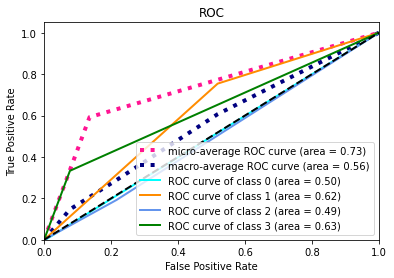

[I 2021-04-20 10:51:49,455] Trial 13 finished with value: 0.5582792793747992 and parameters: {'transformer_alpha': 0.6287564456048946, 'alpha': 0.011065611948517849, 'n_layers': 4, 'n_units_layers_0': 374, 'n_units_layers_1': 129, 'n_units_layers_2': 78, 'n_units_layers_3': 490, 'lr': 1.5557512457128687e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 135  41   9]
 [  0  25  12   5]
 [  0   8  17   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.561606 (macro),
0.617490 (weighted by prevalence)


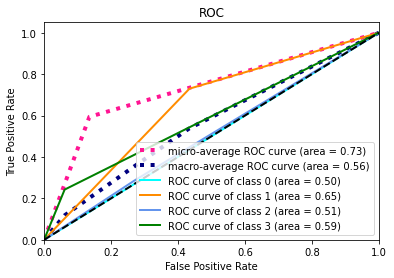

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 118  48   8]
 [  0  33  25   7]
 [  1   4   9   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558362 (macro),
0.592885 (weighted by prevalence)


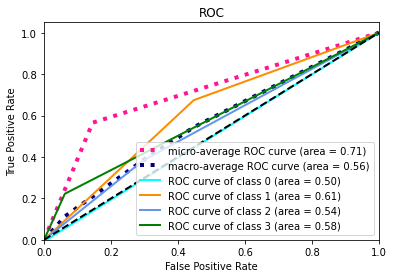

Accuracy: 50.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 104  80   0]
 [  0  21  25   1]
 [  0   9  15   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.523295 (macro),
0.544614 (weighted by prevalence)


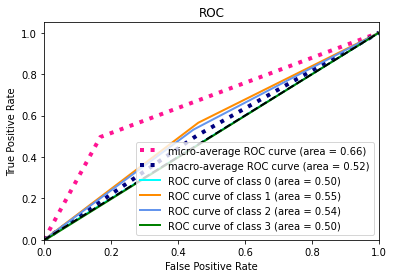

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 124  49   8]
 [  1  25  19   2]
 [  0  10  13   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.559620 (macro),
0.590363 (weighted by prevalence)


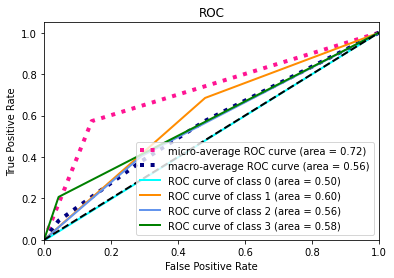

Accuracy: 52.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 110  61   8]
 [  0  22  24   6]
 [  0   8  17   2]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540941 (macro),
0.588695 (weighted by prevalence)


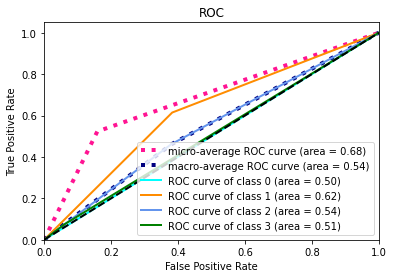

[I 2021-04-20 10:54:25,452] Trial 14 finished with value: 0.5487647397170184 and parameters: {'transformer_alpha': 0.8244664472321815, 'alpha': 2.582353954418592e-05, 'n_layers': 3, 'n_units_layers_0': 301, 'n_units_layers_1': 195, 'n_units_layers_2': 220, 'lr': 3.834211978374249e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 148  26  11]
 [  0  28  10   4]
 [  0  18   8   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551344 (macro),
0.580269 (weighted by prevalence)


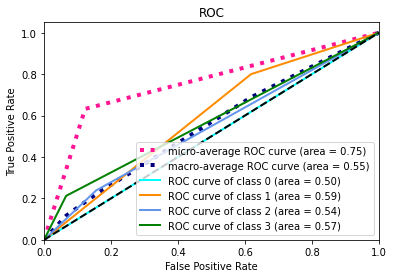

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 139  26  10]
 [  1  39  16   9]
 [  0   9   5   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.554963 (macro),
0.588519 (weighted by prevalence)


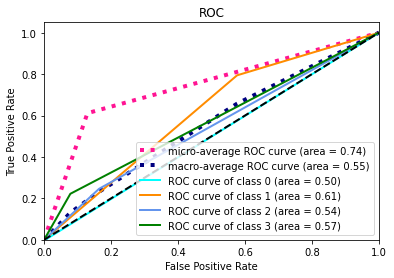

Accuracy: 63.0
Confusion matrix: 
[[  0   5   0   0]
 [  1 147  27   9]
 [  0  24  12  11]
 [  0  14   4   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.563029 (macro),
0.600002 (weighted by prevalence)


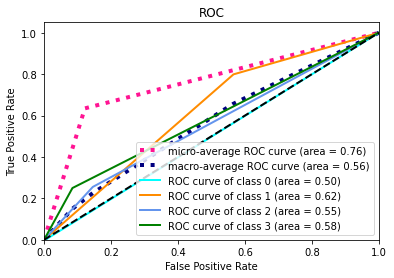

Accuracy: 62.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 144  28   9]
 [  0  33   9   5]
 [  0  11  11   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.548726 (macro),
0.580679 (weighted by prevalence)


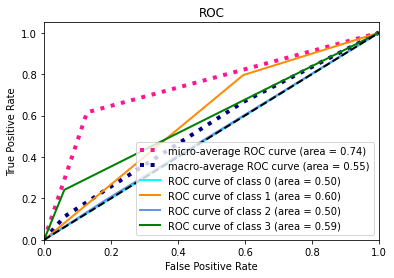

Accuracy: 59.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 138  32   9]
 [  0  34  10   8]
 [  0   9  12   6]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545063 (macro),
0.587510 (weighted by prevalence)


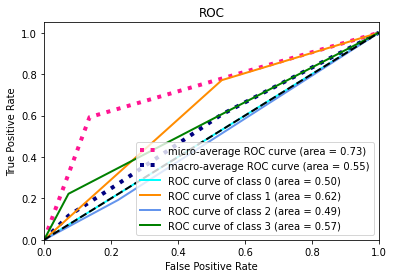

[I 2021-04-20 10:55:52,953] Trial 15 finished with value: 0.5526249541981586 and parameters: {'transformer_alpha': 0.2861790327471082, 'alpha': 0.017471126512540444, 'n_layers': 4, 'n_units_layers_0': 435, 'n_units_layers_1': 96, 'n_units_layers_2': 87, 'n_units_layers_3': 269, 'lr': 3.359124918504847e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 144  32   8]
 [  0  27  11   4]
 [  0  17  10   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.547717 (macro),
0.579818 (weighted by prevalence)


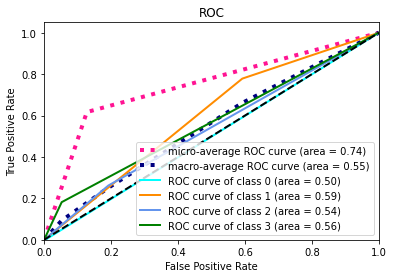

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 139  30   6]
 [  0  40  13  12]
 [  0  13   3   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.526841 (macro),
0.554665 (weighted by prevalence)


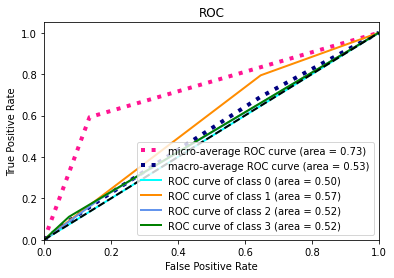

Accuracy: 62.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 143  28  13]
 [  0  26  11  10]
 [  0  10   6   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568499 (macro),
0.601722 (weighted by prevalence)


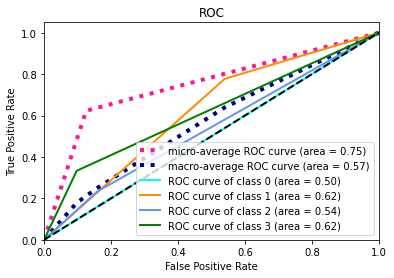

Accuracy: 58.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 138  32  11]
 [  1  34   8   4]
 [  0  15   8   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.528087 (macro),
0.542576 (weighted by prevalence)


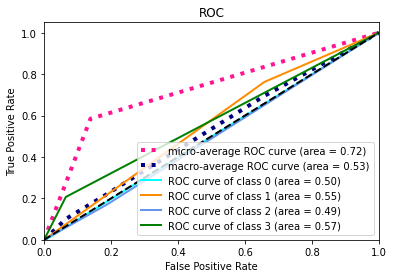

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 128  38  13]
 [  0  33  10   9]
 [  0   9   7  11]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557603 (macro),
0.573012 (weighted by prevalence)


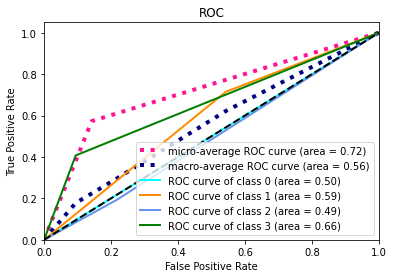

[I 2021-04-20 10:57:15,364] Trial 16 finished with value: 0.5457493445020297 and parameters: {'transformer_alpha': 0.6102394413041451, 'alpha': 0.07518532219284374, 'n_layers': 2, 'n_units_layers_0': 494, 'n_units_layers_1': 218, 'lr': 7.107024881515066e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 71.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 185   0   0]
 [  0  42   0   0]
 [  0  33   0   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


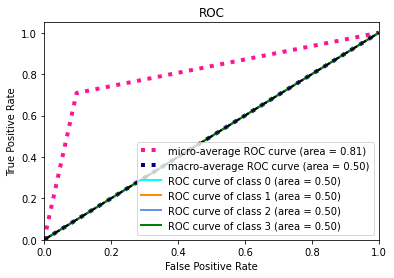

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 118  47  10]
 [  1  32  23   9]
 [  0   2  13   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.548478 (macro),
0.596513 (weighted by prevalence)


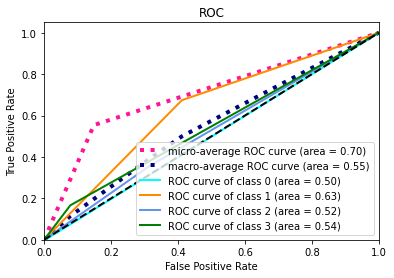

Accuracy: 57.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 128  52   4]
 [  0  24  14   9]
 [  0   9   9   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551315 (macro),
0.583497 (weighted by prevalence)


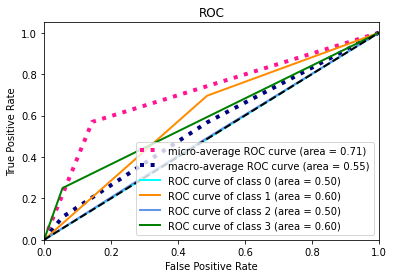

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 132  41   8]
 [  0  25  17   5]
 [  0  10  11   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573178 (macro),
0.609289 (weighted by prevalence)


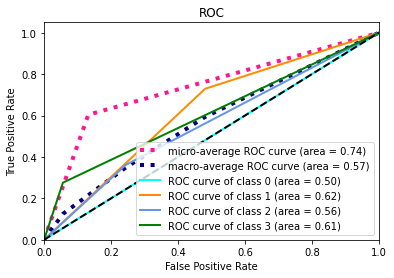

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 128  40  11]
 [  0  25  20   7]
 [  0   6  14   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577778 (macro),
0.631631 (weighted by prevalence)


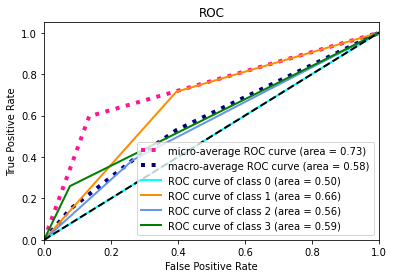

[I 2021-04-20 11:00:42,049] Trial 17 finished with value: 0.5501497003686834 and parameters: {'transformer_alpha': 0.3589943884876866, 'alpha': 0.003244564497065828, 'n_layers': 3, 'n_units_layers_0': 395, 'n_units_layers_1': 321, 'n_units_layers_2': 11, 'lr': 4.861986610239608e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 155  15  14]
 [  1  29   7   5]
 [  0  24   6   3]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.524746 (macro),
0.551279 (weighted by prevalence)


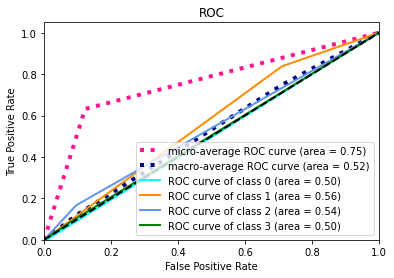

Accuracy: 66.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 151  17   6]
 [  0  42  18   5]
 [  0  13   3   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553551 (macro),
0.588759 (weighted by prevalence)


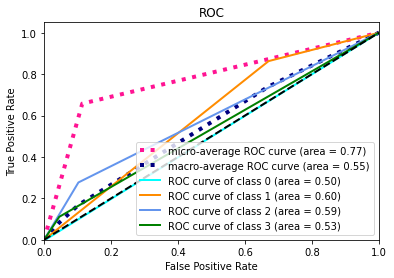

Accuracy: 66.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 155  20   9]
 [  0  32   6   9]
 [  0  11   2  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577156 (macro),
0.594432 (weighted by prevalence)


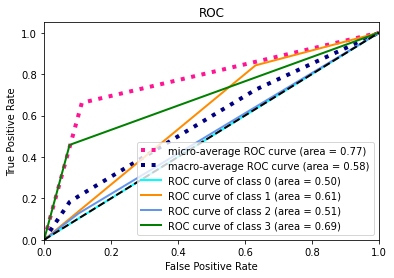

Accuracy: 64.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 147  25   9]
 [  0  33  10   4]
 [  0  13   6  10]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.569455 (macro),
0.592947 (weighted by prevalence)


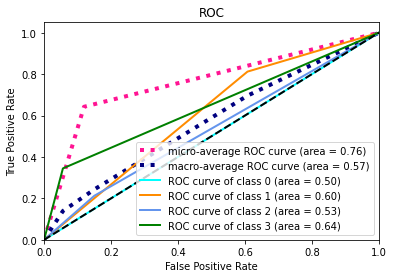

Accuracy: 66.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 155  19   5]
 [  1  32   9  10]
 [  0  11   8   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572710 (macro),
0.623192 (weighted by prevalence)


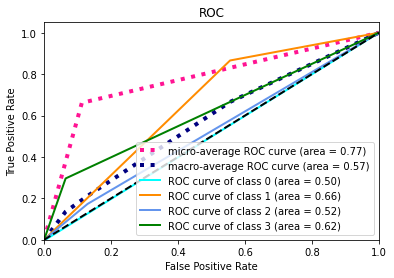

[I 2021-04-20 11:01:16,209] Trial 18 finished with value: 0.5595236753107412 and parameters: {'transformer_alpha': 0.016939246501805838, 'alpha': 0.03163979884175418, 'n_layers': 4, 'n_units_layers_0': 269, 'n_units_layers_1': 157, 'n_units_layers_2': 320, 'n_units_layers_3': 230, 'lr': 0.0022631220215216926}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 58.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 140  38   6]
 [  0  29   8   5]
 [  0  18  11   4]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.520129 (macro),
0.546292 (weighted by prevalence)


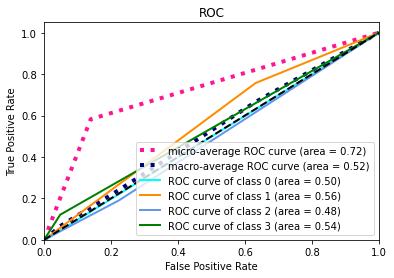

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 130  40   5]
 [  1  35  22   7]
 [  0   5  10   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556329 (macro),
0.601323 (weighted by prevalence)


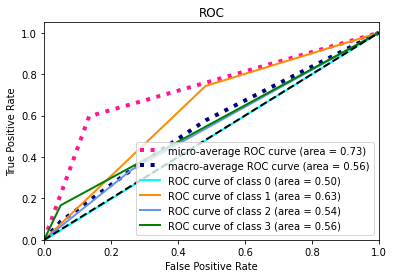

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 136  35  12]
 [  0  26  12   9]
 [  0   6  11   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562359 (macro),
0.606377 (weighted by prevalence)


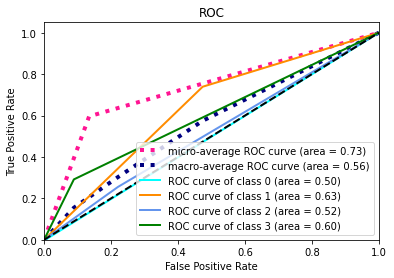

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 133  40   8]
 [  0  32   9   6]
 [  0  12  10   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.534674 (macro),
0.554858 (weighted by prevalence)


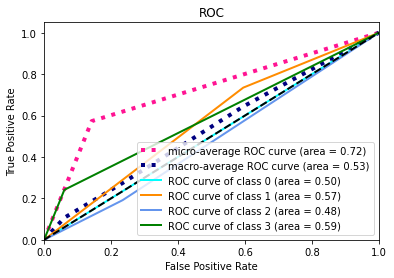

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 133  33  13]
 [  0  31  14   7]
 [  0  10   9   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562182 (macro),
0.594457 (weighted by prevalence)


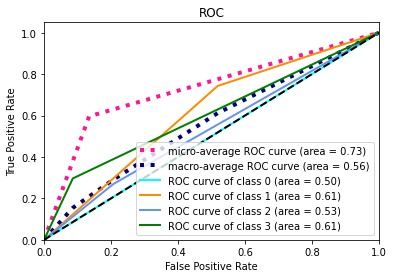

[I 2021-04-20 11:13:49,542] Trial 19 finished with value: 0.547134494495636 and parameters: {'transformer_alpha': 0.6382763854651443, 'alpha': 0.01051400695377365, 'n_layers': 3, 'n_units_layers_0': 417, 'n_units_layers_1': 356, 'n_units_layers_2': 494, 'lr': 7.383716574982764e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 136  40   8]
 [  0  27  12   3]
 [  0  17  11   5]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.536911 (macro),
0.561463 (weighted by prevalence)


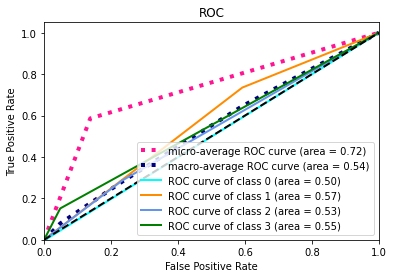

Accuracy: 59.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 128  40   7]
 [  0  38  20   7]
 [  0   7   6   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.559606 (macro),
0.579973 (weighted by prevalence)


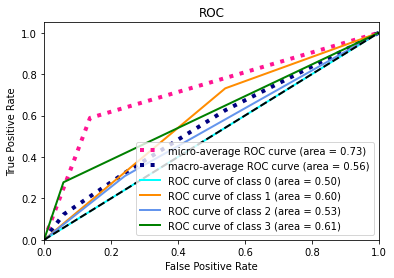

Accuracy: 60.0
Confusion matrix: 
[[  0   4   0   1]
 [  0 140  30  14]
 [  0  27   9  11]
 [  0  10   6   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558379 (macro),
0.590671 (weighted by prevalence)


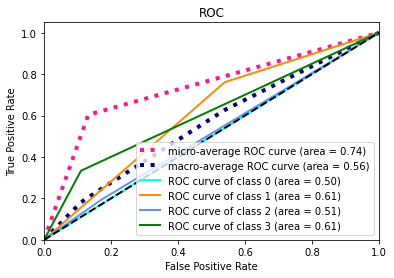

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  1 134  36  10]
 [  0  30  14   3]
 [  0  11   9   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565019 (macro),
0.585801 (weighted by prevalence)


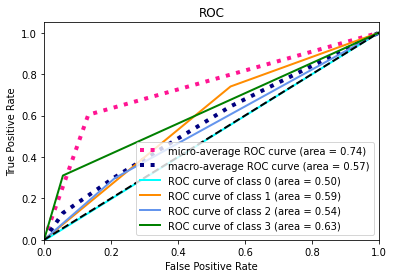

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 133  32  14]
 [  0  30  11  11]
 [  0   5  14   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558201 (macro),
0.607380 (weighted by prevalence)


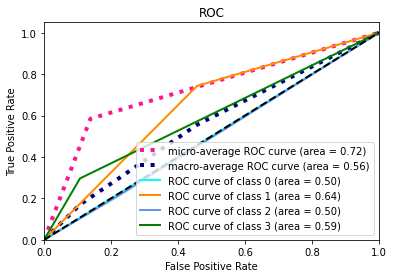

[I 2021-04-20 11:15:09,542] Trial 20 finished with value: 0.555623336679924 and parameters: {'transformer_alpha': 0.5427411699513194, 'alpha': 1.6037260543417786e-05, 'n_layers': 2, 'n_units_layers_0': 488, 'n_units_layers_1': 15, 'lr': 4.713292598434449e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   1   0]
 [  2 135  41   7]
 [  1  27   7   7]
 [  0  17  10   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.523610 (macro),
0.555334 (weighted by prevalence)


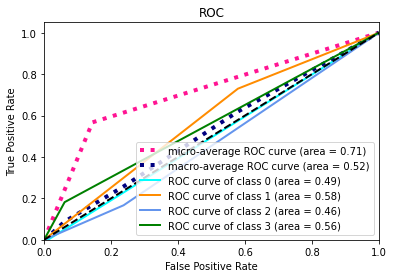

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  2 129  38   6]
 [  0  39  15  11]
 [  0   7   5   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555583 (macro),
0.571709 (weighted by prevalence)


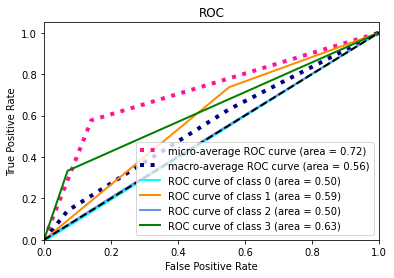

Accuracy: 62.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 136  40   8]
 [  0  23  15   9]
 [  0   7   6  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.597069 (macro),
0.629970 (weighted by prevalence)


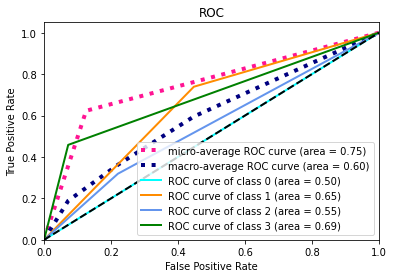

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 106  65  10]
 [  1  17  25   4]
 [  1   8  14   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566342 (macro),
0.603145 (weighted by prevalence)


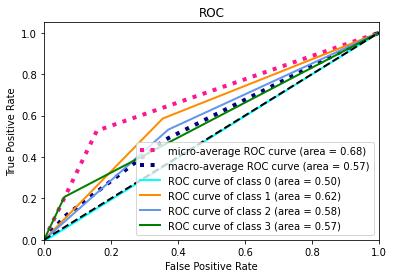

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 126  39  14]
 [  0  26  18   8]
 [  0   8  12   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566601 (macro),
0.611740 (weighted by prevalence)


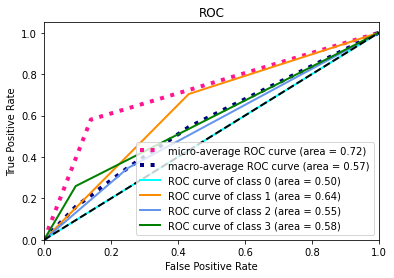

[I 2021-04-20 11:20:49,895] Trial 21 finished with value: 0.5618409842528064 and parameters: {'transformer_alpha': 0.10217024588131804, 'alpha': 0.0034212593991527506, 'n_layers': 3, 'n_units_layers_0': 41, 'n_units_layers_1': 478, 'n_units_layers_2': 304, 'lr': 2.076368189311613e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 51.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 114  64   7]
 [  0  23  17   2]
 [  0   9  22   2]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.527975 (macro),
0.571107 (weighted by prevalence)


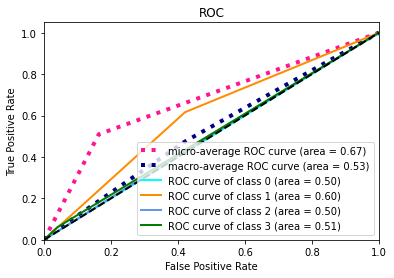

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 130  38   6]
 [  0  36  25   4]
 [  0   2  13   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565431 (macro),
0.614656 (weighted by prevalence)


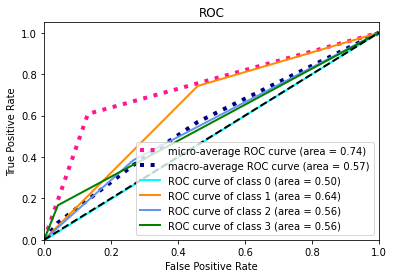

Accuracy: 57.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 127  48   9]
 [  0  23  13  11]
 [  0   4  11   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.570935 (macro),
0.612835 (weighted by prevalence)


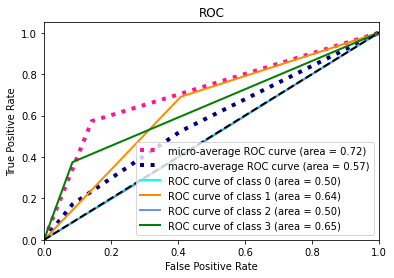

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   1]
 [  0 128  43  10]
 [  0  25  16   6]
 [  0  10   9  10]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575795 (macro),
0.606961 (weighted by prevalence)


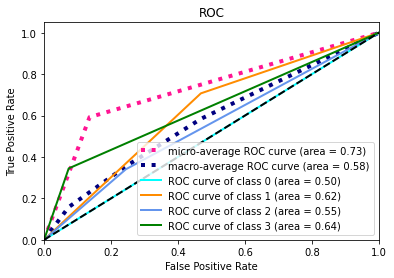

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 120  57   2]
 [  0  25  27   0]
 [  0   6  21   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550771 (macro),
0.608273 (weighted by prevalence)


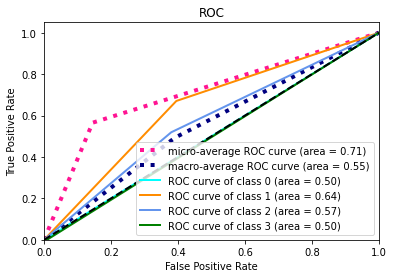

[I 2021-04-20 11:23:06,888] Trial 22 finished with value: 0.5581814000153125 and parameters: {'transformer_alpha': 0.12409037959131926, 'alpha': 0.00034407119490027717, 'n_layers': 3, 'n_units_layers_0': 105, 'n_units_layers_1': 470, 'n_units_layers_2': 204, 'lr': 7.229422035439191e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 40.0
Confusion matrix: 
[[  0   0   1   0]
 [  0  74 111   0]
 [  0  10  31   1]
 [  0   6  27   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.536060 (macro),
0.575192 (weighted by prevalence)


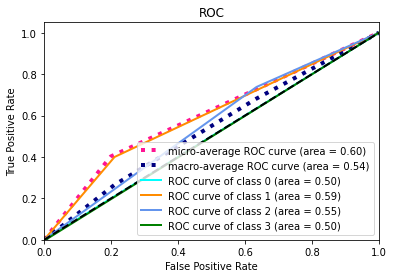

Accuracy: 52.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 106  65   4]
 [  0  33  30   2]
 [  0   4  14   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.523973 (macro),
0.562264 (weighted by prevalence)


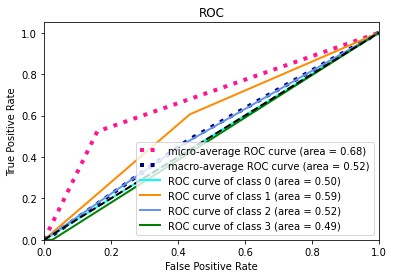

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 137  44   3]
 [  0  28  18   1]
 [  0  13  10   1]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537743 (macro),
0.566365 (weighted by prevalence)


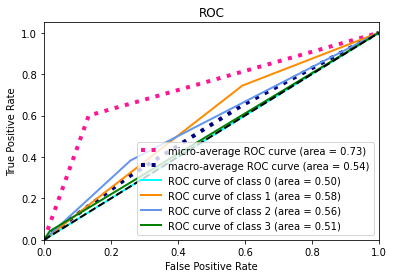

Accuracy: 50.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 115  66   0]
 [  0  32  15   0]
 [  0  15  14   0]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.493251 (macro),
0.495751 (weighted by prevalence)


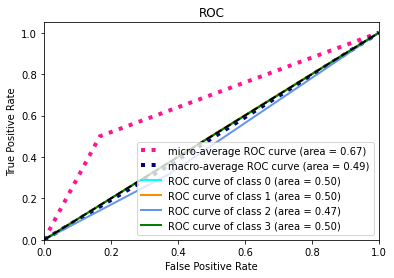

Accuracy: 54.0
Confusion matrix: 
[[  0   1   1   0]
 [  5 118  53   3]
 [  0  31  21   0]
 [  0  13  13   1]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.523772 (macro),
0.545037 (weighted by prevalence)


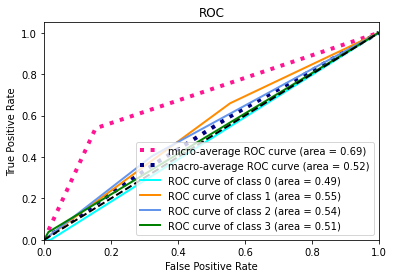

[I 2021-04-20 11:23:48,174] Trial 23 finished with value: 0.5229596291962716 and parameters: {'transformer_alpha': 0.3299511652294036, 'alpha': 0.007029186707795471, 'n_layers': 3, 'n_units_layers_0': 93, 'n_units_layers_1': 84, 'n_units_layers_2': 412, 'lr': 2.8073178429241603e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 147  30   8]
 [  0  30   9   3]
 [  0  19   9   5]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.534522 (macro),
0.557889 (weighted by prevalence)


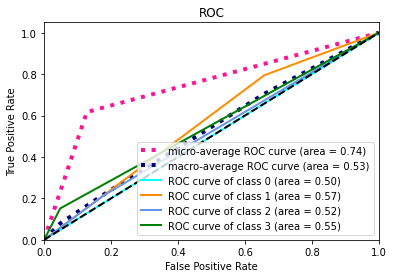

Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   1]
 [  2 143  21   9]
 [  0  40  18   7]
 [  0  11   3   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562931 (macro),
0.593579 (weighted by prevalence)


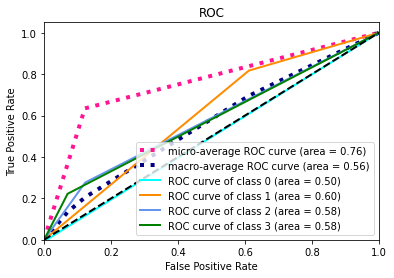

Accuracy: 65.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 148  24  12]
 [  0  25  11  11]
 [  0  11   2  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.593274 (macro),
0.624733 (weighted by prevalence)


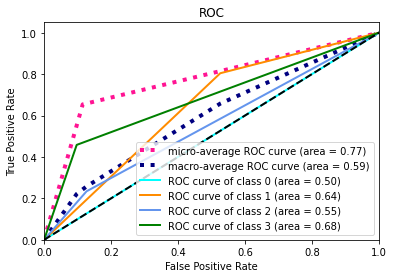

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 145  28   8]
 [  0  38   4   5]
 [  0  14   9   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.520865 (macro),
0.536906 (weighted by prevalence)


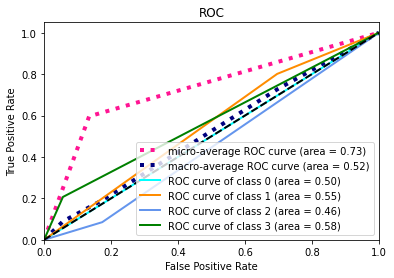

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 137  32  10]
 [  0  35  10   7]
 [  0   8  14   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.536648 (macro),
0.575165 (weighted by prevalence)


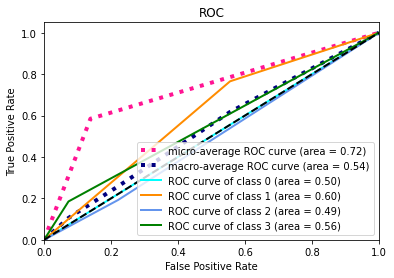

[I 2021-04-20 11:25:16,887] Trial 24 finished with value: 0.5496478483922344 and parameters: {'transformer_alpha': 0.2050018455995568, 'alpha': 0.02707624894190561, 'n_layers': 3, 'n_units_layers_0': 261, 'n_units_layers_1': 392, 'n_units_layers_2': 283, 'lr': 8.873138206607595e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 60.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 140  37   7]
 [  0  28  10   4]
 [  0  16  11   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.539162 (macro),
0.568312 (weighted by prevalence)


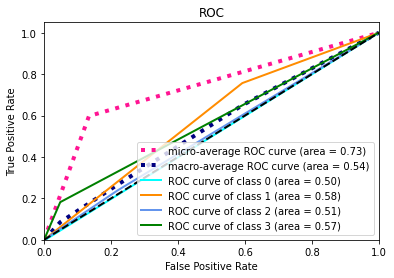

Accuracy: 64.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 144  27   4]
 [  0  38  18   9]
 [  0  11   3   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565134 (macro),
0.599536 (weighted by prevalence)


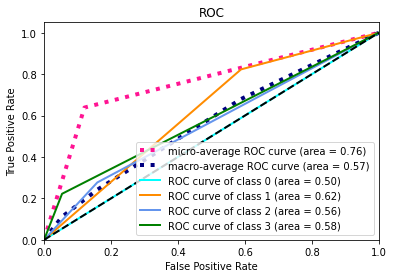

Accuracy: 61.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 138  36  10]
 [  0  28   9  10]
 [  0   9   4  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572889 (macro),
0.591646 (weighted by prevalence)


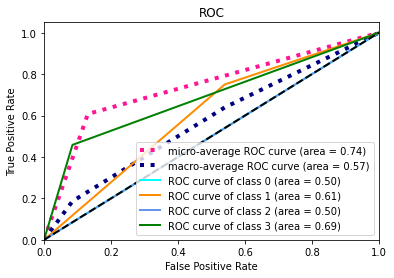

Accuracy: 57.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 133  35  13]
 [  1  34   9   3]
 [  0  15   8   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.525987 (macro),
0.537351 (weighted by prevalence)


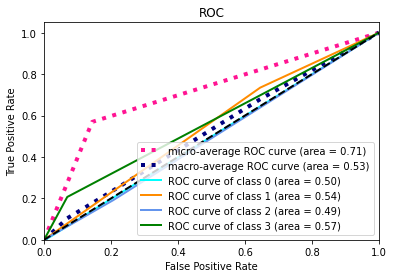

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 137  32  10]
 [  0  32  10  10]
 [  0  10  10   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.548245 (macro),
0.584515 (weighted by prevalence)


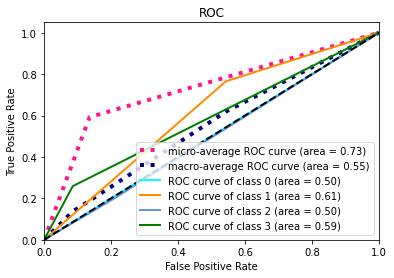

[I 2021-04-20 11:30:55,393] Trial 25 finished with value: 0.5502834769803779 and parameters: {'transformer_alpha': 0.7841158228583953, 'alpha': 0.001798711826783609, 'n_layers': 4, 'n_units_layers_0': 329, 'n_units_layers_1': 244, 'n_units_layers_2': 178, 'n_units_layers_3': 210, 'lr': 7.570866815172705e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 52.0
Confusion matrix: 
[[  0   1   0   0]
 [  3 113  63   6]
 [  0  20  19   3]
 [  0   8  21   4]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.546031 (macro),
0.591924 (weighted by prevalence)


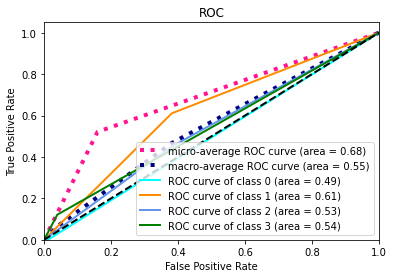

Accuracy: 53.0
Confusion matrix: 
[[ 0  1  1  0]
 [ 0 99 74  2]
 [ 0 28 37  0]
 [ 0  5 12  1]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542010 (macro),
0.572791 (weighted by prevalence)


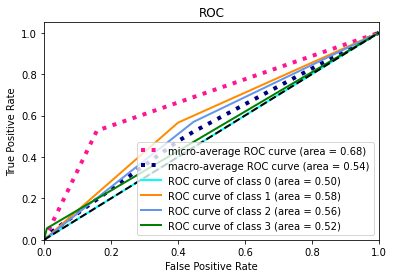

Accuracy: 13.0
Confusion matrix: 
[[ 0  0  3  2]
 [ 1  0 84 99]
 [ 0  0 16 31]
 [ 0  0  5 19]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.517115 (macro),
0.502416 (weighted by prevalence)


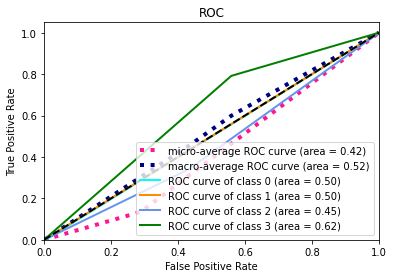

Accuracy: 49.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 100  74   7]
 [  0  20  25   2]
 [  0   5  22   2]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.538659 (macro),
0.577952 (weighted by prevalence)


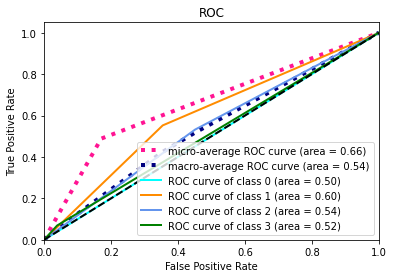

Accuracy: 40.0
Confusion matrix: 
[[  0   1   1   0]
 [  4  61 109   5]
 [  0  10  42   0]
 [  0   2  25   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537747 (macro),
0.576752 (weighted by prevalence)


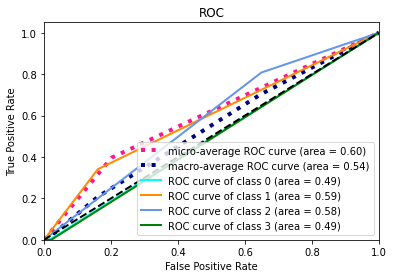

[I 2021-04-20 11:31:35,525] Trial 26 finished with value: 0.5363126788879924 and parameters: {'transformer_alpha': 0.0037400384063871472, 'alpha': 0.09356078410826908, 'n_layers': 2, 'n_units_layers_0': 162, 'n_units_layers_1': 167, 'lr': 2.0516883961460573e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   0]
 [  4 132  35  14]
 [  0  21  17   4]
 [  0  16   7  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.579399 (macro),
0.606944 (weighted by prevalence)


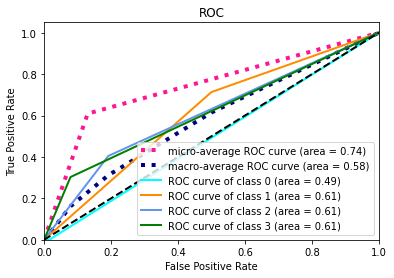

Accuracy: 54.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 109  58   8]
 [  1  29  28   7]
 [  0   2  12   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558677 (macro),
0.596784 (weighted by prevalence)


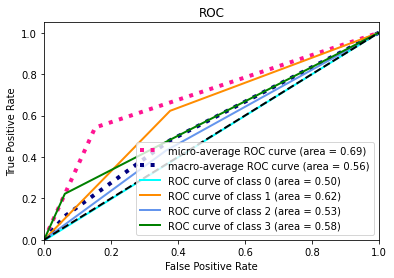

Accuracy: 58.0
Confusion matrix: 
[[  1   2   1   1]
 [  1 130  40  13]
 [  0  23  12  12]
 [  0   9   6   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.594341 (macro),
0.608942 (weighted by prevalence)


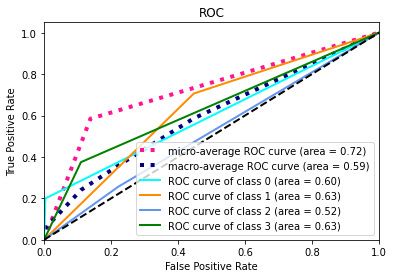

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  1 115  53  12]
 [  0  24  18   5]
 [  0  12  11   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544201 (macro),
0.564188 (weighted by prevalence)


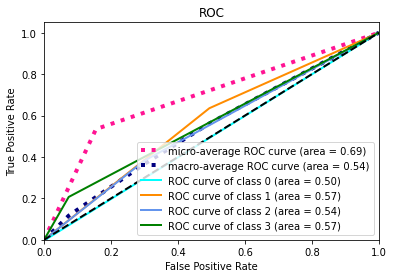

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  4 108  53  14]
 [  0  22  23   7]
 [  0   4  12  11]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.587099 (macro),
0.621863 (weighted by prevalence)


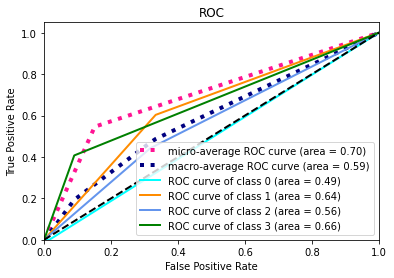

[I 2021-04-20 11:32:58,891] Trial 27 finished with value: 0.5727434086067354 and parameters: {'transformer_alpha': 0.09463658992907517, 'alpha': 0.0003183809335484713, 'n_layers': 3, 'n_units_layers_0': 18, 'n_units_layers_1': 289, 'n_units_layers_2': 95, 'lr': 2.49039921198911e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 125  49  11]
 [  0  18  19   5]
 [  0   6  18   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.588040 (macro),
0.651766 (weighted by prevalence)


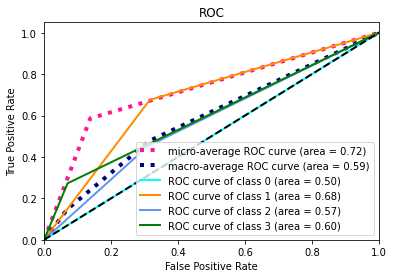

Accuracy: 56.0
Confusion matrix: 
[[  0   1   0   1]
 [  1 113  51  10]
 [  0  29  30   6]
 [  0   7   9   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550157 (macro),
0.591445 (weighted by prevalence)


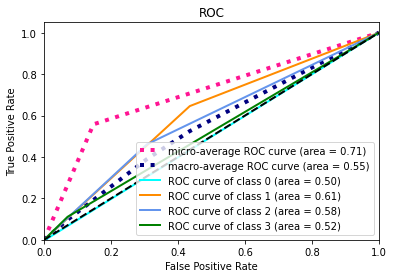

Accuracy: 45.0
Confusion matrix: 
[[ 0  5  0  0]
 [ 0 93 81 10]
 [ 0 18 22  7]
 [ 0  4 17  3]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.526391 (macro),
0.556305 (weighted by prevalence)


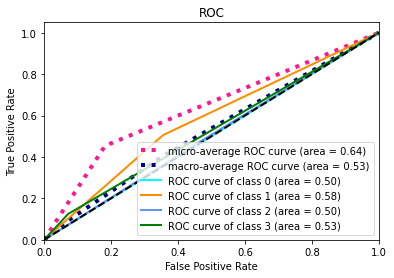

Accuracy: 50.0
Confusion matrix: 
[[  0   3   0   0]
 [  3 103  62  13]
 [  0  25  17   5]
 [  1   6  13   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545641 (macro),
0.562011 (weighted by prevalence)


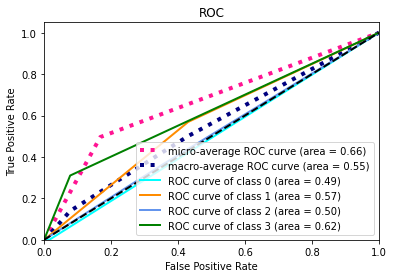

Accuracy: 49.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 100  74   5]
 [  0  23  27   2]
 [  0   5  22   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.526992 (macro),
0.569024 (weighted by prevalence)


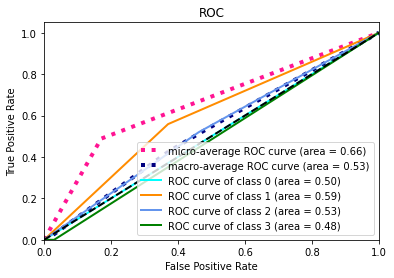

[I 2021-04-20 11:33:51,870] Trial 28 finished with value: 0.5474441608486603 and parameters: {'transformer_alpha': 0.5501686532206684, 'alpha': 2.7093498628896822e-05, 'n_layers': 3, 'n_units_layers_0': 11, 'n_units_layers_1': 318, 'n_units_layers_2': 88, 'lr': 3.155988895297522e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 65.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 152  27   6]
 [  0  26  12   4]
 [  0  20   7   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558953 (macro),
0.591234 (weighted by prevalence)


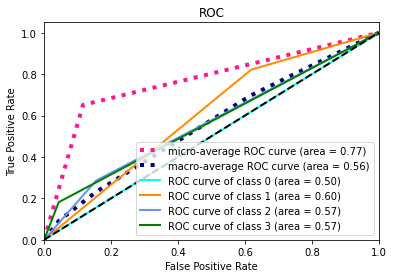

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 147  23   4]
 [  0  42  15   8]
 [  0  10   6   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.543880 (macro),
0.584581 (weighted by prevalence)


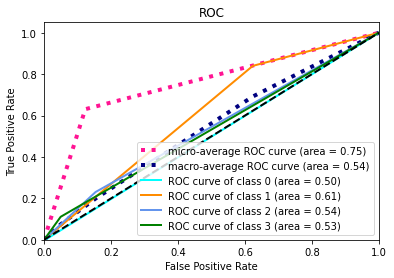

Accuracy: 61.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 141  27  16]
 [  0  26  10  11]
 [  0  10   7   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558212 (macro),
0.597479 (weighted by prevalence)


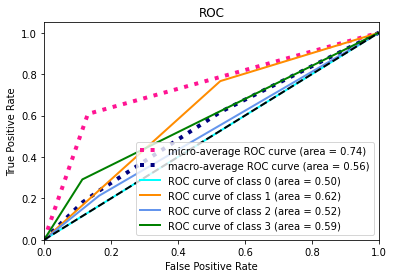

Accuracy: 64.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 150  26   5]
 [  0  36  10   1]
 [  0  12  10   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555290 (macro),
0.579721 (weighted by prevalence)


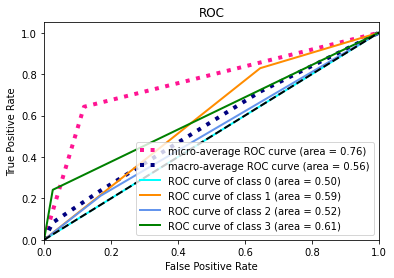

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 136  35   8]
 [  0  37   7   8]
 [  0  14   8   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.518732 (macro),
0.535139 (weighted by prevalence)


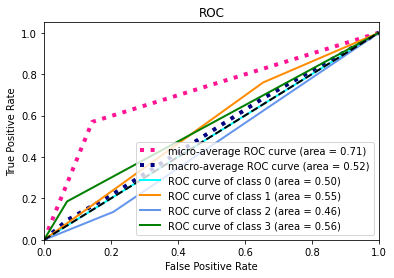

[I 2021-04-20 11:34:39,723] Trial 29 finished with value: 0.5470133017600045 and parameters: {'transformer_alpha': 0.3855994002771532, 'alpha': 0.0003108594801395852, 'n_layers': 4, 'n_units_layers_0': 345, 'n_units_layers_1': 274, 'n_units_layers_2': 57, 'n_units_layers_3': 363, 'lr': 0.00013995267145682172}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 58.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 132  45   8]
 [  0  24  13   5]
 [  0  15  11   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550589 (macro),
0.584775 (weighted by prevalence)


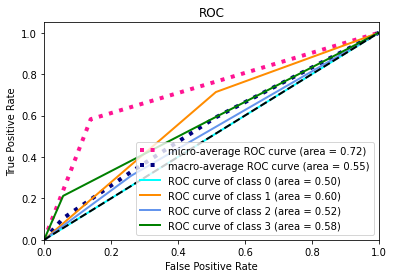

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 131  41   3]
 [  0  34  22   9]
 [  0   5  10   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558357 (macro),
0.606579 (weighted by prevalence)


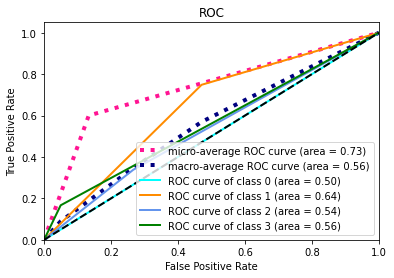

Accuracy: 62.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 140  32  12]
 [  0  23  12  12]
 [  0  10   6   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.571178 (macro),
0.609951 (weighted by prevalence)


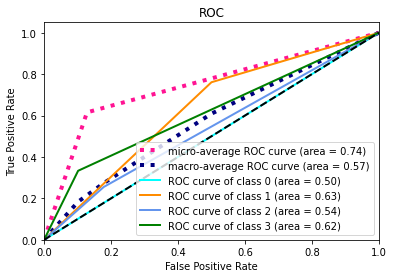

Accuracy: 59.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 137  35   9]
 [  0  30  11   6]
 [  0  11  12   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544411 (macro),
0.578723 (weighted by prevalence)


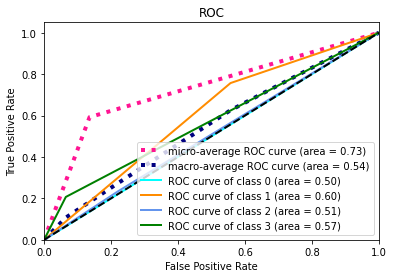

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 127  38  14]
 [  0  25  18   9]
 [  0   5  13   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.581252 (macro),
0.630517 (weighted by prevalence)


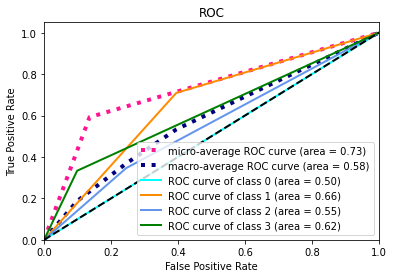

[I 2021-04-20 11:38:34,347] Trial 30 finished with value: 0.5611574793492855 and parameters: {'transformer_alpha': 0.2538592291900334, 'alpha': 7.189922015230183e-06, 'n_layers': 3, 'n_units_layers_0': 468, 'n_units_layers_1': 248, 'n_units_layers_2': 117, 'lr': 9.224940039621074e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 54.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 117  58  10]
 [  1  19  17   5]
 [  0   6  21   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556892 (macro),
0.618060 (weighted by prevalence)


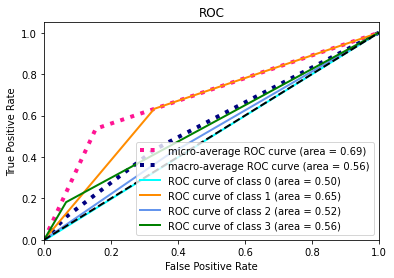

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 121  46   7]
 [  1  28  32   4]
 [  0   3  10   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.592441 (macro),
0.639008 (weighted by prevalence)


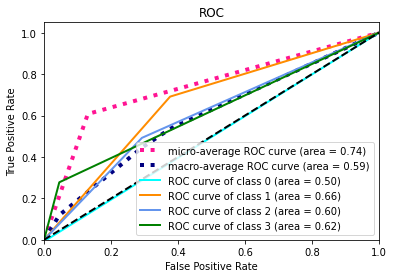

Accuracy: 55.0
Confusion matrix: 
[[  0   4   1   0]
 [  2 122  53   7]
 [  1  21  22   3]
 [  0   8  16   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.539268 (macro),
0.591507 (weighted by prevalence)


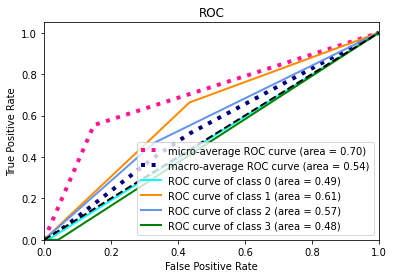

Accuracy: 51.0
Confusion matrix: 
[[  0   3   0   0]
 [  4 102  63  12]
 [  1  18  20   8]
 [  0   5  13  11]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572053 (macro),
0.604022 (weighted by prevalence)


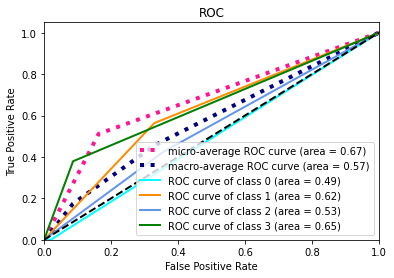

Accuracy: 52.0
Confusion matrix: 
[[  0   1   1   0]
 [  2 102  57  18]
 [  0  20  25   7]
 [  0   7  11   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573935 (macro),
0.603771 (weighted by prevalence)


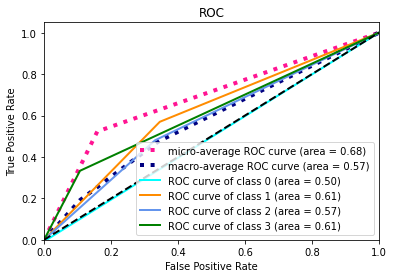

[I 2021-04-20 11:40:32,683] Trial 31 finished with value: 0.5669175618962964 and parameters: {'transformer_alpha': 0.09301337306894435, 'alpha': 0.00013808865703545216, 'n_layers': 3, 'n_units_layers_0': 12, 'n_units_layers_1': 420, 'n_units_layers_2': 266, 'lr': 1.958332348739602e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 57.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 120  56   9]
 [  0  17  21   4]
 [  0   6  18   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.588834 (macro),
0.644647 (weighted by prevalence)


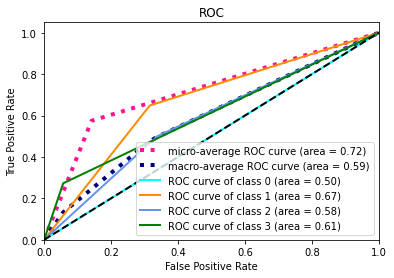

Accuracy: 58.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 120  46   9]
 [  0  33  28   4]
 [  0   5   9   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568203 (macro),
0.603457 (weighted by prevalence)


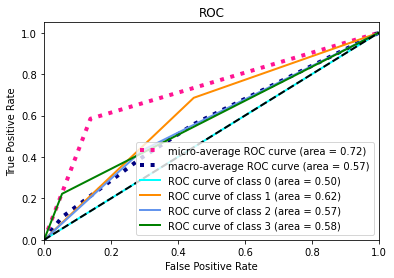

Accuracy: 56.0
Confusion matrix: 
[[  0   3   2   0]
 [  1 118  55  10]
 [  0  19  23   5]
 [  0   4  16   4]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568128 (macro),
0.623845 (weighted by prevalence)


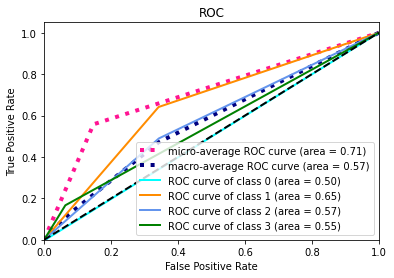

Accuracy: 50.0
Confusion matrix: 
[[ 0  2  1  0]
 [ 0 94 79  8]
 [ 0 15 31  1]
 [ 0  3 21  5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573128 (macro),
0.616848 (weighted by prevalence)


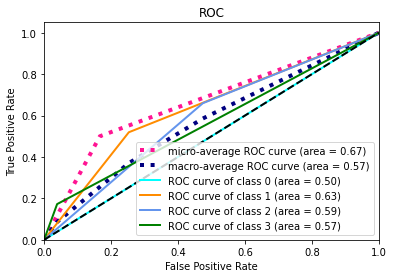

Accuracy: 51.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 108  64   7]
 [  0  23  22   7]
 [  0   3  21   3]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.541332 (macro),
0.596560 (weighted by prevalence)


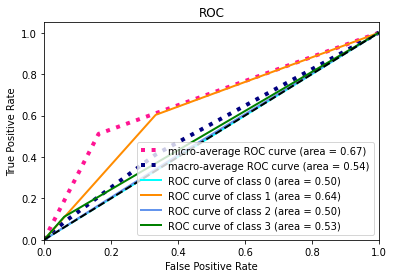

[I 2021-04-20 11:41:54,928] Trial 32 finished with value: 0.5679248423009584 and parameters: {'transformer_alpha': 0.16813051121754535, 'alpha': 0.0054615501865642796, 'n_layers': 3, 'n_units_layers_0': 77, 'n_units_layers_1': 367, 'n_units_layers_2': 119, 'lr': 4.414708308500329e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 61.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 143  35   6]
 [  0  27  10   5]
 [  0  17  10   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.543975 (macro),
0.579458 (weighted by prevalence)


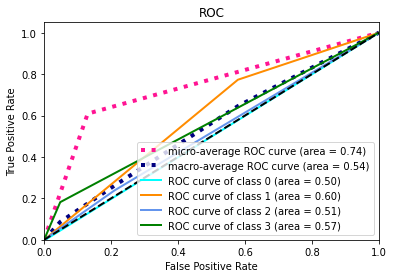

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 148  21   6]
 [  0  41  14  10]
 [  0  12   3   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549769 (macro),
0.585193 (weighted by prevalence)


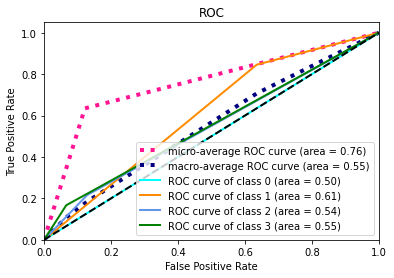

Accuracy: 61.0
Confusion matrix: 
[[  0   4   0   1]
 [  1 141  30  12]
 [  0  26  11  10]
 [  0   8  10   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557647 (macro),
0.605414 (weighted by prevalence)


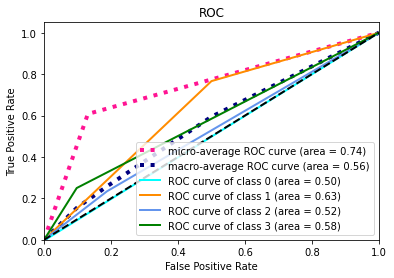

Accuracy: 61.0
Confusion matrix: 
[[  0   2   1   0]
 [  1 138  32  10]
 [  0  27  12   8]
 [  0  13   7   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565855 (macro),
0.599374 (weighted by prevalence)


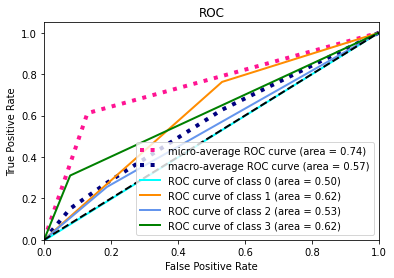

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 132  34  13]
 [  0  30  12  10]
 [  0  10  11   6]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544606 (macro),
0.583211 (weighted by prevalence)


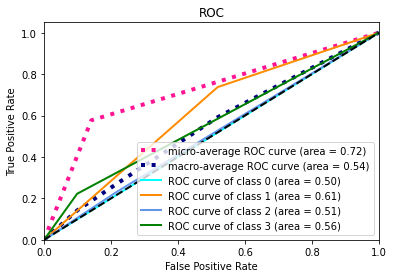

[I 2021-04-20 11:43:34,588] Trial 33 finished with value: 0.5523703446056148 and parameters: {'transformer_alpha': 0.06576406699036605, 'alpha': 0.00039753013864784006, 'n_layers': 3, 'n_units_layers_0': 134, 'n_units_layers_1': 300, 'n_units_layers_2': 183, 'lr': 5.77906497976263e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 57.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 121  52  11]
 [  0  17  21   4]
 [  0   8  18   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.579350 (macro),
0.634312 (weighted by prevalence)


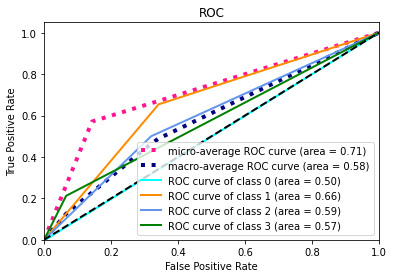

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 115  52   8]
 [  0  27  31   7]
 [  0   2  12   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.576004 (macro),
0.625871 (weighted by prevalence)


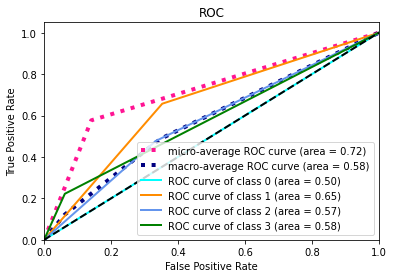

Accuracy: 51.0
Confusion matrix: 
[[  0   1   4   0]
 [  2 106  76   0]
 [  0  21  26   0]
 [  0   6  17   1]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542410 (macro),
0.584168 (weighted by prevalence)


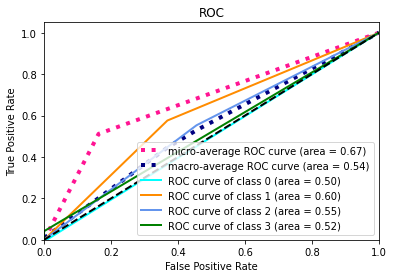

Accuracy: 51.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 104  75   2]
 [  0  20  24   3]
 [  0  10  14   5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550054 (macro),
0.571397 (weighted by prevalence)


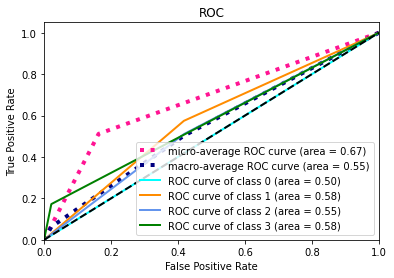

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 114  48  16]
 [  0  24  20   8]
 [  0   5  14   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566264 (macro),
0.606163 (weighted by prevalence)


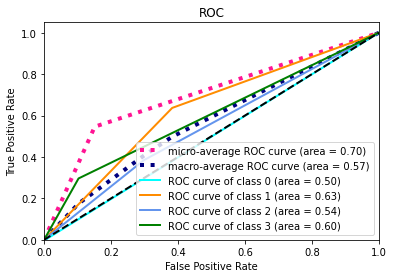

[I 2021-04-20 11:44:15,468] Trial 34 finished with value: 0.5628163118860289 and parameters: {'transformer_alpha': 0.15989262377207497, 'alpha': 0.001912078903177131, 'n_layers': 2, 'n_units_layers_0': 42, 'n_units_layers_1': 499, 'lr': 1.0593868174693225e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 60.0
Confusion matrix: 
[[  0   0   1   0]
 [  2 129  43  11]
 [  0  17  21   4]
 [  0  10  16   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.588338 (macro),
0.648641 (weighted by prevalence)


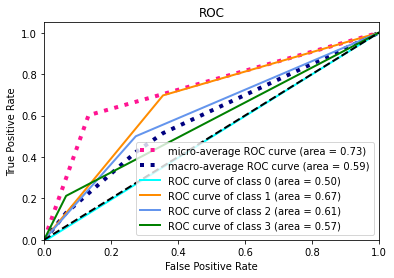

Accuracy: 51.0
Confusion matrix: 
[[ 0  0  2  0]
 [ 3 98 58 16]
 [ 4 26 30  5]
 [ 0  5  8  5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558998 (macro),
0.586334 (weighted by prevalence)


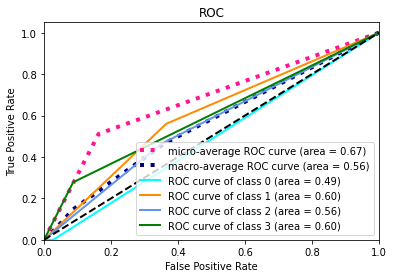

Accuracy: 45.0
Confusion matrix: 
[[ 0  3  2  0]
 [ 1 95 80  8]
 [ 0 20 19  8]
 [ 0  8 12  4]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.520787 (macro),
0.539536 (weighted by prevalence)


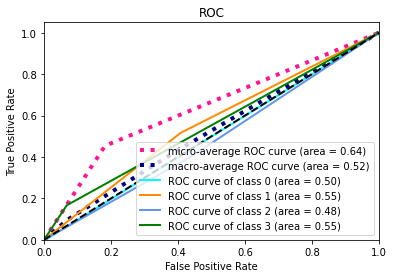

Accuracy: 56.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 117  64   0]
 [  0  22  25   0]
 [  0  11  15   3]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557893 (macro),
0.590688 (weighted by prevalence)


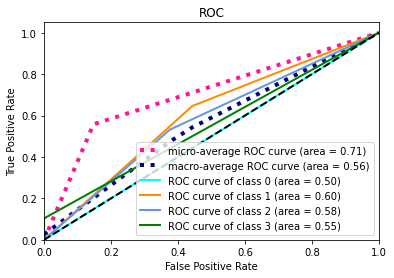

Accuracy: 54.0
Confusion matrix: 
[[  0   2   0   0]
 [  2 114  51  12]
 [  1  21  19  11]
 [  0   7  12   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564370 (macro),
0.608202 (weighted by prevalence)


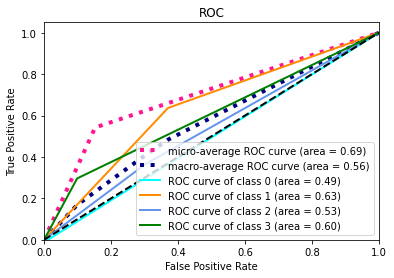

[I 2021-04-20 11:45:13,590] Trial 35 finished with value: 0.5580771964576658 and parameters: {'transformer_alpha': 0.2853447630662057, 'alpha': 5.366923099207055e-05, 'n_layers': 3, 'n_units_layers_0': 13, 'n_units_layers_1': 203, 'n_units_layers_2': 347, 'lr': 3.2248380977612746e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 66.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 154  18  13]
 [  0  28   6   8]
 [  0  16   5  12]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568712 (macro),
0.605383 (weighted by prevalence)


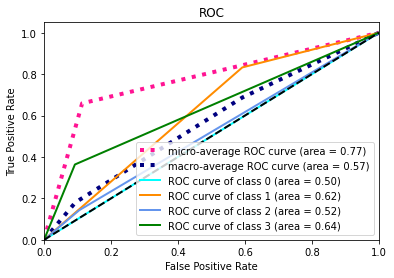

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 147  20   8]
 [  0  43  12  10]
 [  0  11   4   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542705 (macro),
0.575178 (weighted by prevalence)


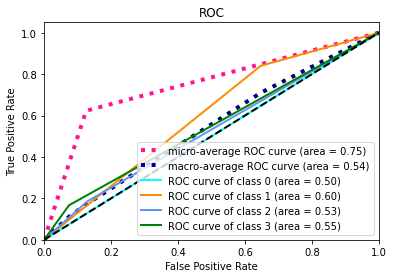

Accuracy: 61.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 142  29  13]
 [  0  28   9  10]
 [  0  10   6   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.559682 (macro),
0.590448 (weighted by prevalence)


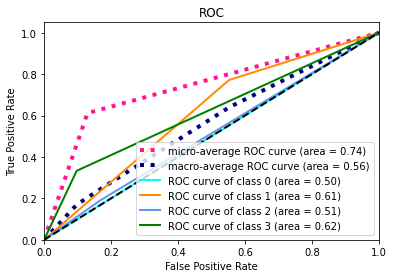

Accuracy: 63.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 144  31   6]
 [  0  33  12   2]
 [  0  15   6   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560102 (macro),
0.577026 (weighted by prevalence)


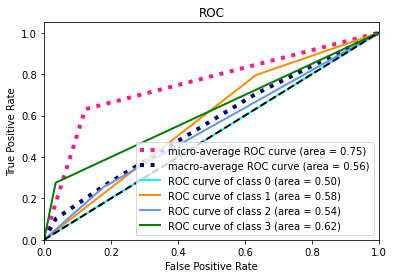

Accuracy: 61.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 144  29   6]
 [  0  34  10   8]
 [  0  12  10   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542723 (macro),
0.579911 (weighted by prevalence)


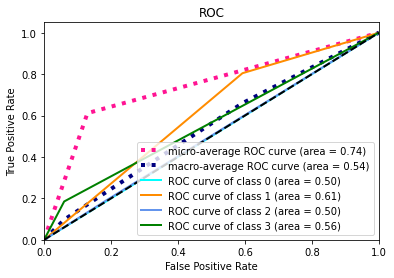

[I 2021-04-20 11:46:25,752] Trial 36 finished with value: 0.5547846729485519 and parameters: {'transformer_alpha': 0.9359005924786774, 'alpha': 3.4831419207016526e-06, 'n_layers': 4, 'n_units_layers_0': 410, 'n_units_layers_1': 398, 'n_units_layers_2': 53, 'n_units_layers_3': 131, 'lr': 0.0002830662212634096}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 52.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 120  63   2]
 [  0  24  16   2]
 [  0   8  25   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.523076 (macro),
0.577505 (weighted by prevalence)


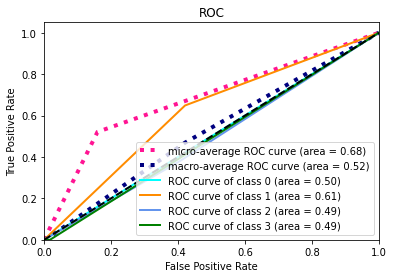

Accuracy: 52.0
Confusion matrix: 
[[ 0  0  2  0]
 [ 0 97 76  2]
 [ 0 28 35  2]
 [ 0  5 11  2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542835 (macro),
0.569413 (weighted by prevalence)


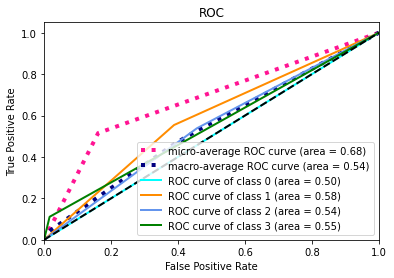

Accuracy: 46.0
Confusion matrix: 
[[ 0  3  2  0]
 [ 0 88 94  2]
 [ 0 16 30  1]
 [ 0  4 19  1]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537872 (macro),
0.572375 (weighted by prevalence)


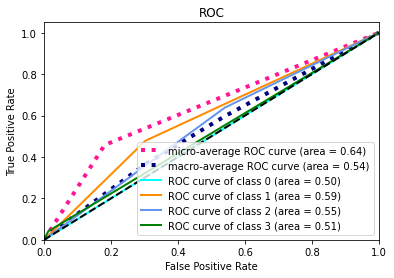

Accuracy: 47.0
Confusion matrix: 
[[ 0  2  1  0]
 [ 0 98 75  8]
 [ 0 23 22  2]
 [ 0 12 14  3]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.522349 (macro),
0.532910 (weighted by prevalence)


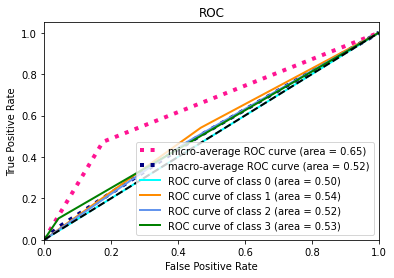

Accuracy: 54.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 116  59   4]
 [  0  27  25   0]
 [  0   7  20   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.535924 (macro),
0.579290 (weighted by prevalence)


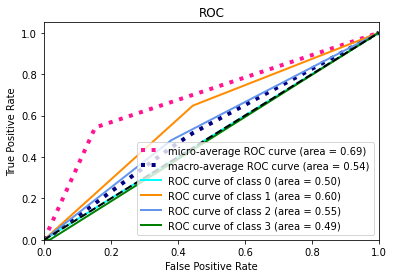

[I 2021-04-20 11:47:08,762] Trial 37 finished with value: 0.532411404003194 and parameters: {'transformer_alpha': 0.15705667704320647, 'alpha': 0.0006014771460160608, 'n_layers': 2, 'n_units_layers_0': 68, 'n_units_layers_1': 361, 'lr': 2.0815029854491532e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 62.0
Confusion matrix: 
[[  0   0   1   0]
 [  2 138  34  11]
 [  0  22  14   6]
 [  0  11  12  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.581404 (macro),
0.634462 (weighted by prevalence)


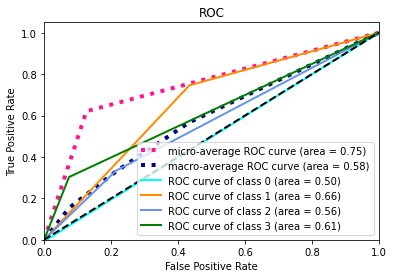

Accuracy: 25.0
Confusion matrix: 
[[  0   0   2   0]
 [  0   0 175   0]
 [  0   0  65   0]
 [  0   0  18   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


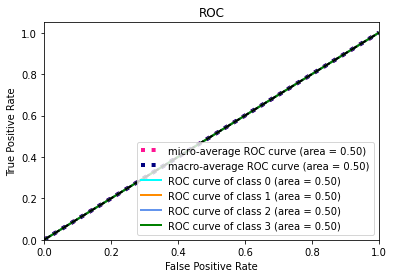

Accuracy: 54.0
Confusion matrix: 
[[  0   4   1   0]
 [  2 114  58  10]
 [  0  24  19   4]
 [  0   8   9   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556924 (macro),
0.569951 (weighted by prevalence)


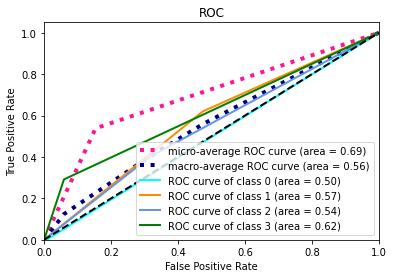

Accuracy: 54.0
Confusion matrix: 
[[  0   3   0   0]
 [  1 116  63   1]
 [  0  22  25   0]
 [  0   9  20   0]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.543066 (macro),
0.585864 (weighted by prevalence)


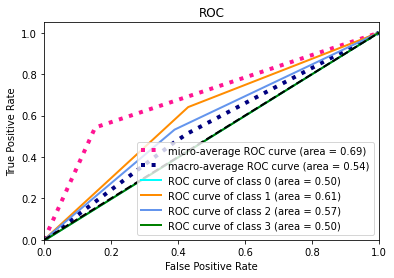

Accuracy: 67.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 164  15   0]
 [  0  42  10   0]
 [  0  25   2   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.521866 (macro),
0.533209 (weighted by prevalence)


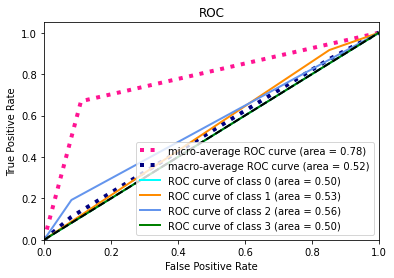

[I 2021-04-20 11:47:42,941] Trial 38 finished with value: 0.5406519091173383 and parameters: {'transformer_alpha': 0.007693699439625265, 'alpha': 0.043817921159372906, 'n_layers': 3, 'n_units_layers_0': 115, 'n_units_layers_1': 444, 'n_units_layers_2': 145, 'lr': 0.09825419419192999}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   1   0   0]
 [  2 138  35  10]
 [  0  25  11   6]
 [  0  14  13   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545788 (macro),
0.588319 (weighted by prevalence)


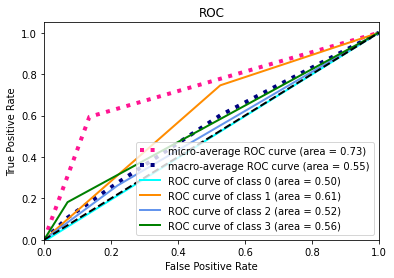

Accuracy: 65.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 146  26   3]
 [  1  39  20   5]
 [  0  11   5   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556507 (macro),
0.599482 (weighted by prevalence)


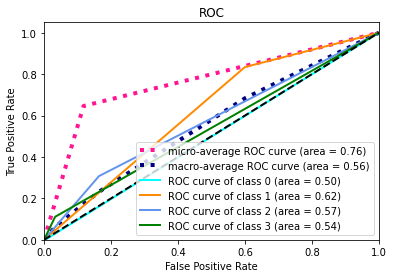

Accuracy: 61.0
Confusion matrix: 
[[  0   5   0   0]
 [  2 139  29  14]
 [  0  29   8  10]
 [  0  10   3  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568158 (macro),
0.580640 (weighted by prevalence)


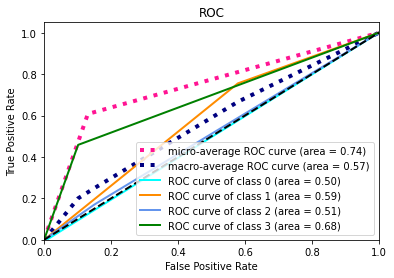

Accuracy: 55.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 130  40  11]
 [  0  35   8   4]
 [  0  12  13   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.510958 (macro),
0.530645 (weighted by prevalence)


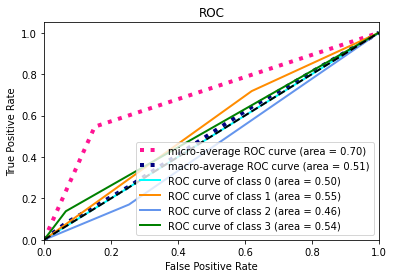

Accuracy: 61.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 140  26  12]
 [  0  34  10   8]
 [  0  14   5   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551836 (macro),
0.571982 (weighted by prevalence)


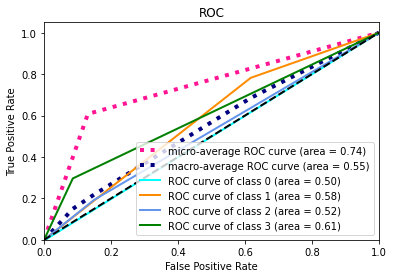

[I 2021-04-20 11:50:20,226] Trial 39 finished with value: 0.546649470766343 and parameters: {'transformer_alpha': 0.42912004709408275, 'alpha': 0.0010472080044812977, 'n_layers': 5, 'n_units_layers_0': 466, 'n_units_layers_1': 343, 'n_units_layers_2': 235, 'n_units_layers_3': 335, 'n_units_layers_4': 16, 'lr': 0.008566823918864182}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 142  34   9]
 [  0  29   8   5]
 [  0  21   7   5]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.523736 (macro),
0.540165 (weighted by prevalence)


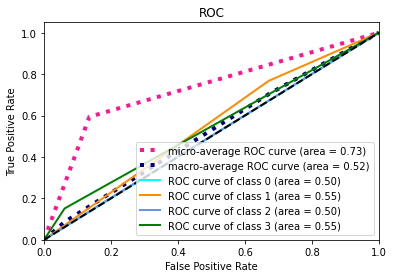

Accuracy: 65.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 153  17   5]
 [  0  45  11   9]
 [  0  12   2   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552871 (macro),
0.578616 (weighted by prevalence)


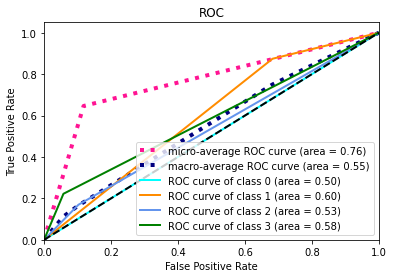

Accuracy: 63.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 143  28  12]
 [  0  27  11   9]
 [  0   8   5  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.587983 (macro),
0.617157 (weighted by prevalence)


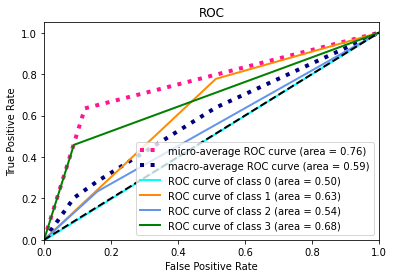

Accuracy: 61.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 138  34   9]
 [  0  28  14   5]
 [  0  12  10   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.561275 (macro),
0.594259 (weighted by prevalence)


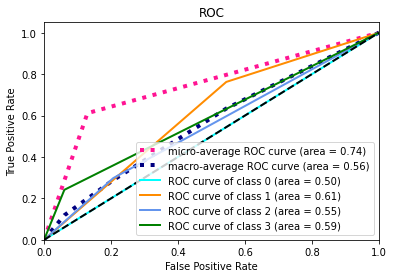

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 131  40   8]
 [  0  29  14   9]
 [  0   9  11   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556044 (macro),
0.594010 (weighted by prevalence)


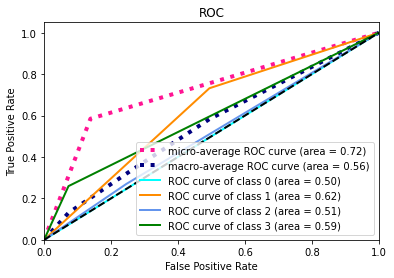

[I 2021-04-20 11:51:27,597] Trial 40 finished with value: 0.5563818544044337 and parameters: {'transformer_alpha': 0.23908948054208268, 'alpha': 0.015944962831093305, 'n_layers': 4, 'n_units_layers_0': 217, 'n_units_layers_1': 235, 'n_units_layers_2': 157, 'n_units_layers_3': 499, 'lr': 9.785998366249996e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 146  37   2]
 [  0  30  11   1]
 [  0  23   9   1]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.518458 (macro),
0.533135 (weighted by prevalence)


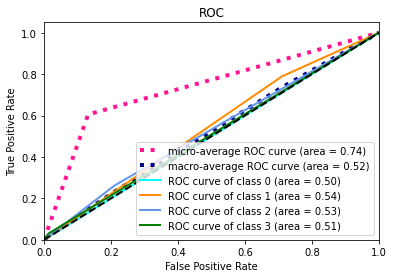

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 134  39   2]
 [  0  43  20   2]
 [  0  11   7   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.520270 (macro),
0.544375 (weighted by prevalence)


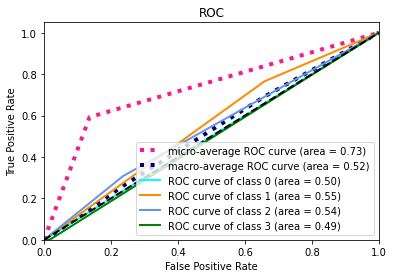

Accuracy: 49.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 100  81   3]
 [  0  17  26   4]
 [  0   4  18   2]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.543989 (macro),
0.585954 (weighted by prevalence)


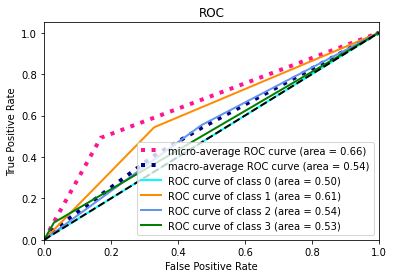

Accuracy: 54.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 113  65   3]
 [  0  20  26   1]
 [  0  10  18   1]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549405 (macro),
0.591627 (weighted by prevalence)


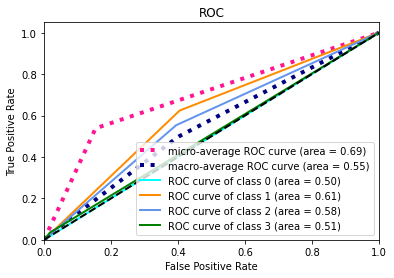

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 115  58   6]
 [  0  24  25   3]
 [  0   7  17   3]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.554408 (macro),
0.600464 (weighted by prevalence)


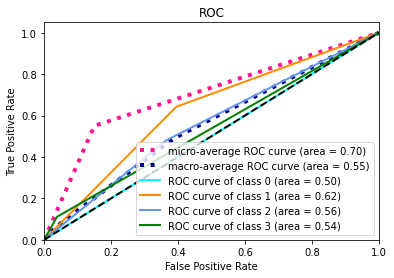

[I 2021-04-20 11:52:16,154] Trial 41 finished with value: 0.5373059641298384 and parameters: {'transformer_alpha': 0.14124317388038649, 'alpha': 0.00460717286561304, 'n_layers': 3, 'n_units_layers_0': 58, 'n_units_layers_1': 295, 'n_units_layers_2': 113, 'lr': 3.5365974610830746e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 64.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 141  36   8]
 [  0  22  15   5]
 [  0  12  11  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.587346 (macro),
0.638218 (weighted by prevalence)


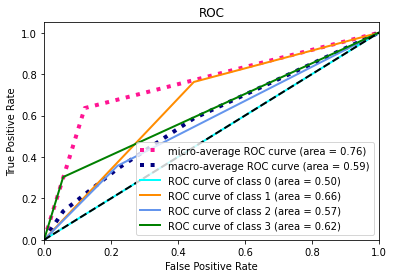

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 129  42   4]
 [  0  29  32   4]
 [  0   4  11   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.585767 (macro),
0.645010 (weighted by prevalence)


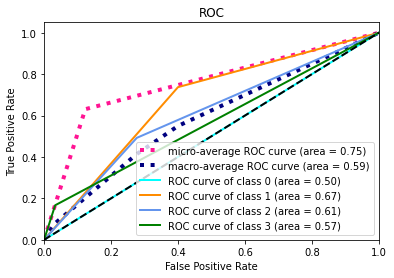

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 126  50   8]
 [  0  20  21   6]
 [  0   5  11   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.591618 (macro),
0.634010 (weighted by prevalence)


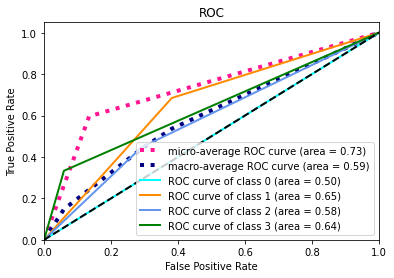

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 115  61   5]
 [  0  26  17   4]
 [  0   7  17   5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.538578 (macro),
0.569573 (weighted by prevalence)


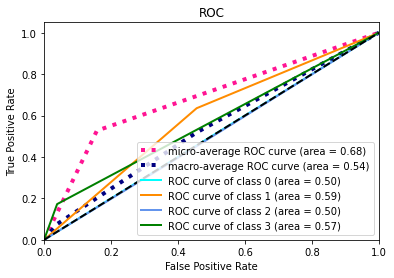

Accuracy: 56.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 110  59   9]
 [  0  21  26   5]
 [  0   5  12  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.591739 (macro),
0.624507 (weighted by prevalence)


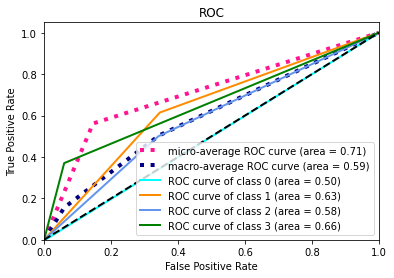

[I 2021-04-20 11:54:56,190] Trial 42 finished with value: 0.5790095093128695 and parameters: {'transformer_alpha': 0.18917461009532432, 'alpha': 0.006931312400088508, 'n_layers': 3, 'n_units_layers_0': 167, 'n_units_layers_1': 273, 'n_units_layers_2': 140, 'lr': 4.629835896264345e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 129  47   8]
 [  0  25  14   3]
 [  0  11  16   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549304 (macro),
0.590993 (weighted by prevalence)


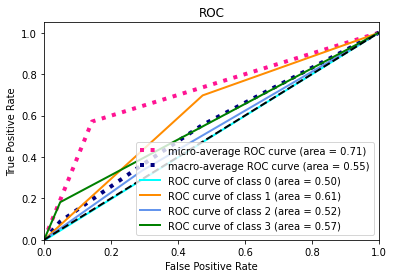

Accuracy: 55.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 111  64   0]
 [  0  32  33   0]
 [  0   6  12   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.536865 (macro),
0.576471 (weighted by prevalence)


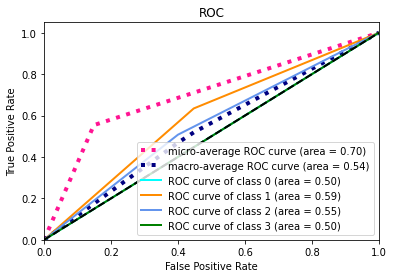

Accuracy: 57.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 132  41  11]
 [  0  24  11  12]
 [  0   6  12   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550386 (macro),
0.600826 (weighted by prevalence)


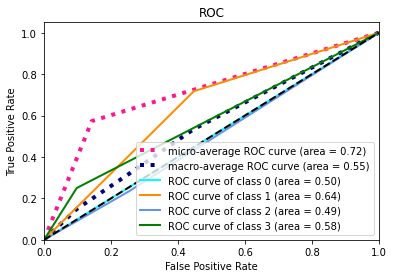

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 121  51   9]
 [  0  28  17   2]
 [  0   9   9  11]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.571735 (macro),
0.582181 (weighted by prevalence)


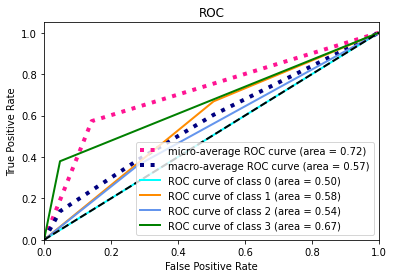

Accuracy: 57.0
Confusion matrix: 
[[  0   0   2   0]
 [  2 115  48  14]
 [  0  20  22  10]
 [  0   3  12  12]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.602149 (macro),
0.653608 (weighted by prevalence)


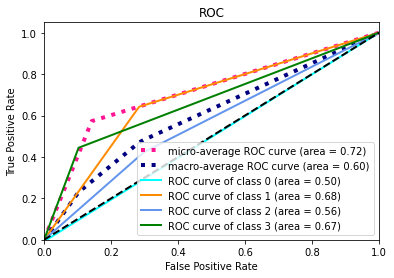

[I 2021-04-20 11:58:10,679] Trial 43 finished with value: 0.5620879856863985 and parameters: {'transformer_alpha': 0.1946514188710776, 'alpha': 0.008548974136160304, 'n_layers': 3, 'n_units_layers_0': 179, 'n_units_layers_1': 271, 'n_units_layers_2': 185, 'lr': 5.7078325254271044e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 64.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 142  38   5]
 [  0  23  15   4]
 [  0  10  14   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.584144 (macro),
0.637857 (weighted by prevalence)


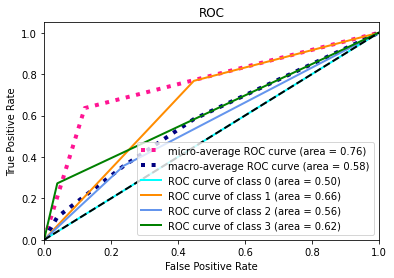

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 138  31   6]
 [  0  36  21   8]
 [  0   9   5   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568137 (macro),
0.605614 (weighted by prevalence)


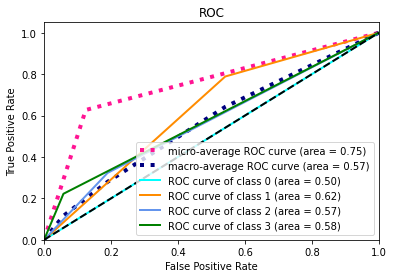

Accuracy: 59.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 135  35  14]
 [  0  24  12  11]
 [  0   7  10   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562283 (macro),
0.608790 (weighted by prevalence)


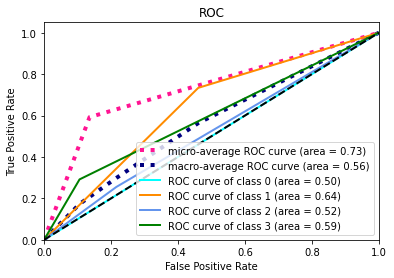

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 110  63   8]
 [  1  22  20   4]
 [  0  11   9   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.561756 (macro),
0.575218 (weighted by prevalence)


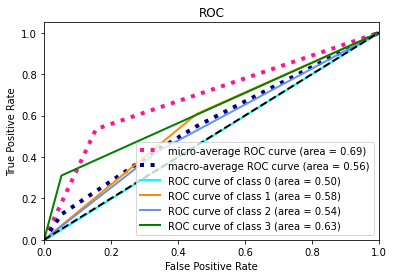

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 123  44  11]
 [  0  26  17   9]
 [  0   4  13  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.578204 (macro),
0.620593 (weighted by prevalence)


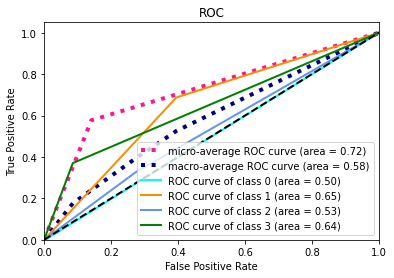

[I 2021-04-20 12:00:10,849] Trial 44 finished with value: 0.5709047935617451 and parameters: {'transformer_alpha': 0.06464936867680228, 'alpha': 0.0029855075423826263, 'n_layers': 3, 'n_units_layers_0': 125, 'n_units_layers_1': 176, 'n_units_layers_2': 143, 'lr': 1.494149365643696e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 145  30  10]
 [  0  27  11   4]
 [  0  17   8   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557636 (macro),
0.586488 (weighted by prevalence)


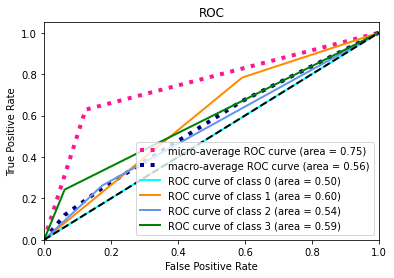

Accuracy: 59.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 125  43   7]
 [  0  31  25   9]
 [  0   4  10   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.569319 (macro),
0.616716 (weighted by prevalence)


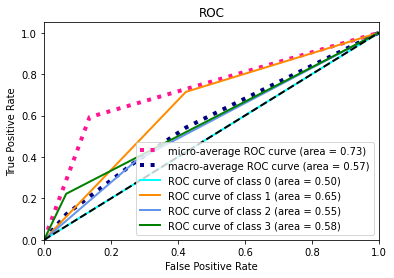

Accuracy: 60.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 135  33  16]
 [  0  23  13  11]
 [  0   6  10   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572496 (macro),
0.618173 (weighted by prevalence)


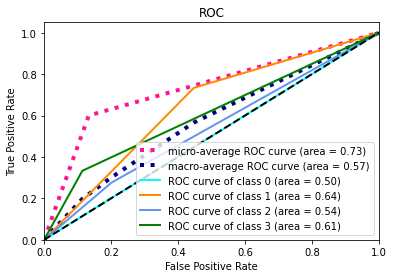

Accuracy: 60.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 135  40   6]
 [  0  32  13   2]
 [  0  11  10   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556828 (macro),
0.578156 (weighted by prevalence)


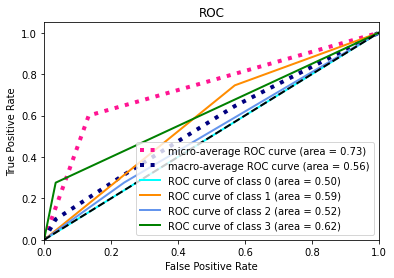

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  2 135  37   5]
 [  0  31  10  11]
 [  0  10   9   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551794 (macro),
0.585780 (weighted by prevalence)


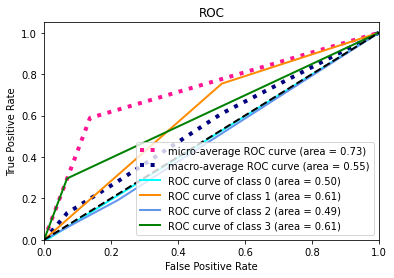

[I 2021-04-20 12:02:23,369] Trial 45 finished with value: 0.5616148610625161 and parameters: {'transformer_alpha': 0.051519320033194135, 'alpha': 0.0027158567690902724, 'n_layers': 3, 'n_units_layers_0': 235, 'n_units_layers_1': 116, 'n_units_layers_2': 138, 'lr': 2.0339047091352576e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 135  36  14]
 [  0  22  13   7]
 [  0  11  11  11]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577313 (macro),
0.622957 (weighted by prevalence)


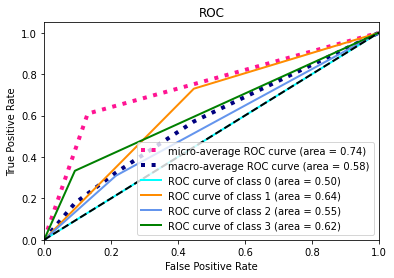

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 123  43   9]
 [  0  37  21   7]
 [  0   4   9   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558960 (macro),
0.583986 (weighted by prevalence)


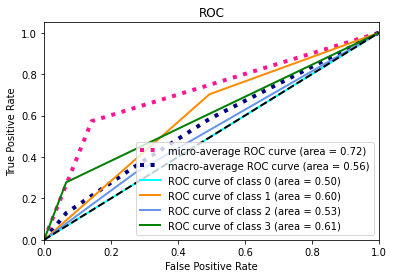

Accuracy: 62.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 135  43   6]
 [  0  23  17   7]
 [  0   6  10   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.585739 (macro),
0.628592 (weighted by prevalence)


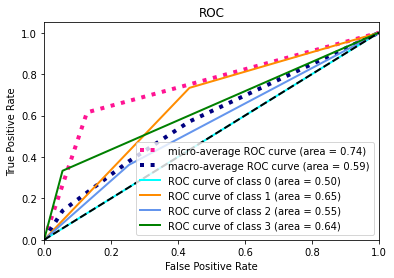

Accuracy: 54.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 116  55  10]
 [  1  22  18   6]
 [  0  10  12   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555307 (macro),
0.588608 (weighted by prevalence)


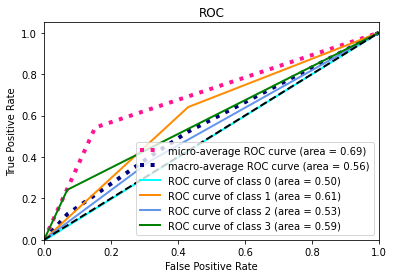

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 128  38  12]
 [  0  28  15   9]
 [  0   6  11  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.574986 (macro),
0.612987 (weighted by prevalence)


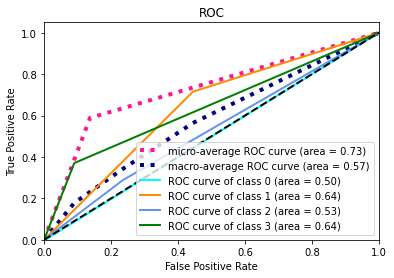

[I 2021-04-20 12:03:31,564] Trial 46 finished with value: 0.5704611896862086 and parameters: {'transformer_alpha': 0.9895211773504691, 'alpha': 0.0008032957964725978, 'n_layers': 2, 'n_units_layers_0': 148, 'n_units_layers_1': 181, 'lr': 1.2883023269021716e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 48.0
Confusion matrix: 
[[  0   0   0   1]
 [  0 106  60  19]
 [  0  20  15   7]
 [  0  18  11   4]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.513588 (macro),
0.528689 (weighted by prevalence)


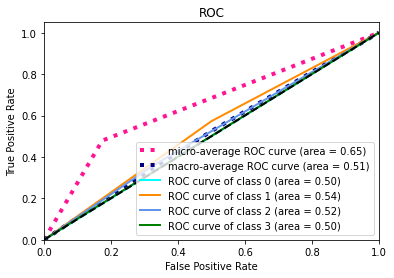

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 111  61   3]
 [  0  31  32   2]
 [  0   6  12   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.534923 (macro),
0.576396 (weighted by prevalence)


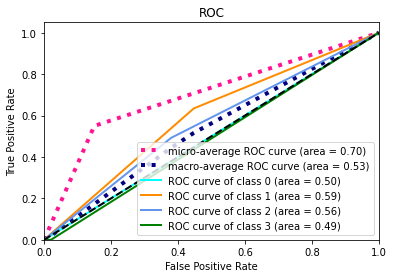

Accuracy: 55.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 115  59  10]
 [  0  20  20   7]
 [  0   6  10   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572499 (macro),
0.598064 (weighted by prevalence)


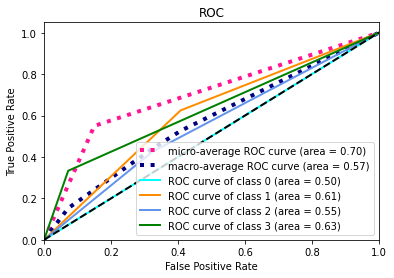

Accuracy: 52.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 117  58   6]
 [  0  31  14   2]
 [  0  11  15   3]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.513590 (macro),
0.530494 (weighted by prevalence)


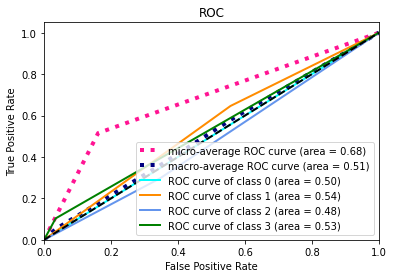

Accuracy: 48.0
Confusion matrix: 
[[ 0  2  0  0]
 [ 0 91 79  9]
 [ 0 18 28  6]
 [ 0  3 18  6]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556799 (macro),
0.592663 (weighted by prevalence)


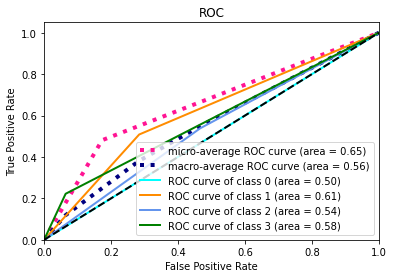

[I 2021-04-20 12:04:37,015] Trial 47 finished with value: 0.5382797983568806 and parameters: {'transformer_alpha': 0.07243915355273749, 'alpha': 0.00018430418028620742, 'n_layers': 3, 'n_units_layers_0': 186, 'n_units_layers_1': 140, 'n_units_layers_2': 95, 'lr': 3.0065560762620407e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 67.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 159  17   9]
 [  0  32   8   2]
 [  0  20   5   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555786 (macro),
0.576965 (weighted by prevalence)


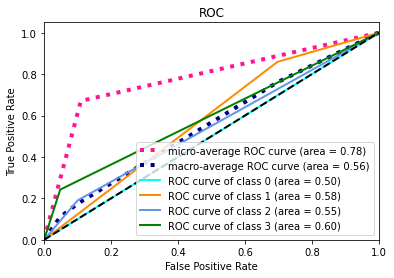

Accuracy: 64.0
Confusion matrix: 
[[  0   2   0   0]
 [  2 152  16   5]
 [  1  43  12   9]
 [  0  12   3   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.547794 (macro),
0.581248 (weighted by prevalence)


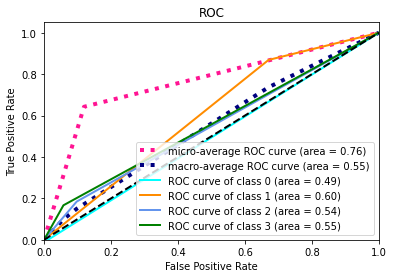

Accuracy: 63.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 151  23  10]
 [  0  34   5   8]
 [  0  12   4   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.548286 (macro),
0.562958 (weighted by prevalence)


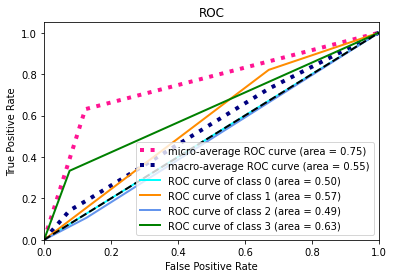

Accuracy: 62.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 139  28  14]
 [  0  30  11   6]
 [  0  10   9  10]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.567779 (macro),
0.597704 (weighted by prevalence)


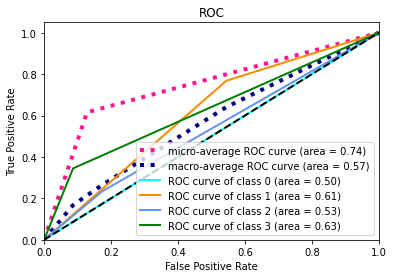

Accuracy: 64.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 152  22   5]
 [  0  32   9  11]
 [  0  15   7   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549299 (macro),
0.593485 (weighted by prevalence)


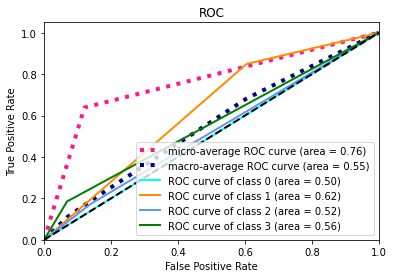

[I 2021-04-20 12:04:59,818] Trial 48 finished with value: 0.5537887480148046 and parameters: {'transformer_alpha': 0.03364406382249765, 'alpha': 0.01680490977456894, 'n_layers': 3, 'n_units_layers_0': 282, 'n_units_layers_1': 225, 'n_units_layers_2': 50, 'lr': 0.0006517591615136706}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 144  41   0]
 [  0  32  10   0]
 [  0  16  17   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.513362 (macro),
0.545211 (weighted by prevalence)


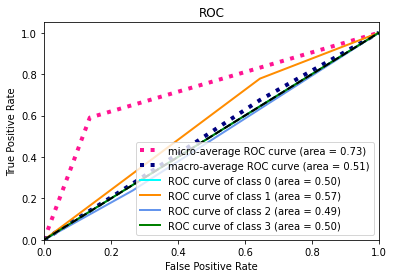

Accuracy: 50.0
Confusion matrix: 
[[ 0  0  2  0]
 [ 0 94 79  2]
 [ 0 29 35  1]
 [ 0  3 15  0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.524304 (macro),
0.559413 (weighted by prevalence)


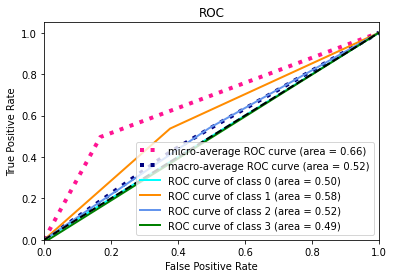

Accuracy: 47.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 101  82   1]
 [  0  26  21   0]
 [  0   9  15   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.501221 (macro),
0.507024 (weighted by prevalence)


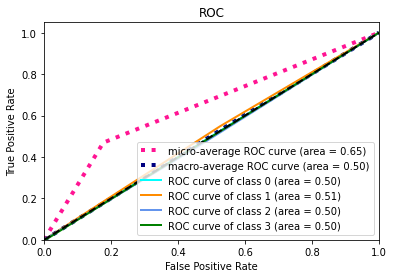

Accuracy: 52.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 105  69   7]
 [  0  20  22   5]
 [  0   5  16   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565823 (macro),
0.601262 (weighted by prevalence)


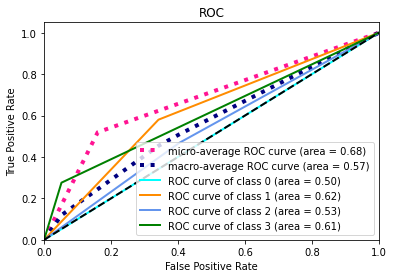

Accuracy: 56.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 122  57   0]
 [  0  28  24   0]
 [  0   8  19   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.538573 (macro),
0.582740 (weighted by prevalence)


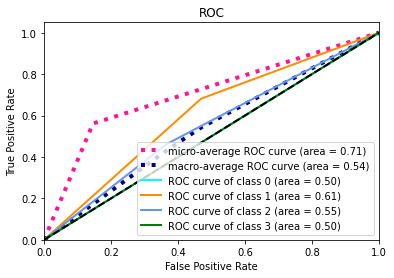

[I 2021-04-20 12:07:05,982] Trial 49 finished with value: 0.5286564829432586 and parameters: {'transformer_alpha': 0.7320417827570058, 'alpha': 0.05258378729131165, 'n_layers': 4, 'n_units_layers_0': 129, 'n_units_layers_1': 312, 'n_units_layers_2': 165, 'n_units_layers_3': 152, 'lr': 2.0511131313670656e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 60.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 130  49   6]
 [  0  18  21   3]
 [  0   9  18   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.584910 (macro),
0.647380 (weighted by prevalence)


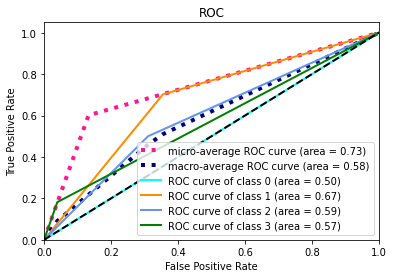

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 123  43   9]
 [  0  35  19  11]
 [  0   6   6   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.561916 (macro),
0.583414 (weighted by prevalence)


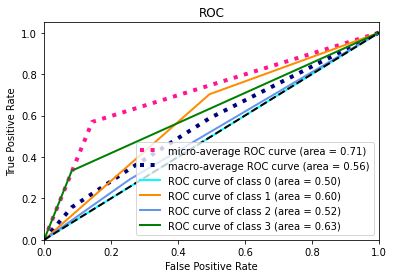

Accuracy: 55.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 116  58  10]
 [  0  22  17   8]
 [  0   3  11  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577789 (macro),
0.606756 (weighted by prevalence)


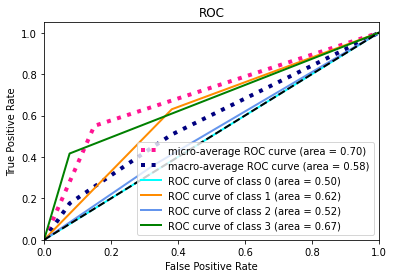

Accuracy: 54.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 109  61  11]
 [  0  17  24   6]
 [  0   9  13   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.571761 (macro),
0.609932 (weighted by prevalence)


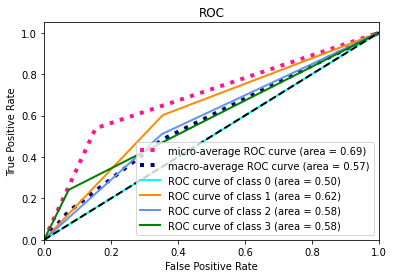

Accuracy: 21.0
Confusion matrix: 
[[  0   0   2   0]
 [  0   0 164  15]
 [  1   0  51   0]
 [  0   0  23   4]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.519001 (macro),
0.511546 (weighted by prevalence)


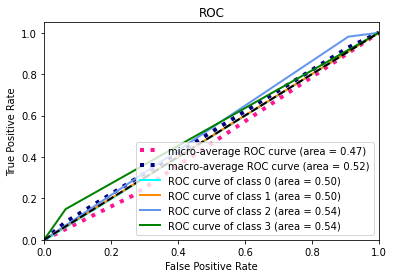

[I 2021-04-20 12:08:06,609] Trial 50 finished with value: 0.563075591166348 and parameters: {'transformer_alpha': 0.8568712779186797, 'alpha': 0.0012636055898338455, 'n_layers': 3, 'n_units_layers_0': 239, 'n_units_layers_1': 63, 'n_units_layers_2': 69, 'lr': 5.215209036197533e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 121  55   9]
 [  0  22  17   3]
 [  0   9  13  11]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577069 (macro),
0.612203 (weighted by prevalence)


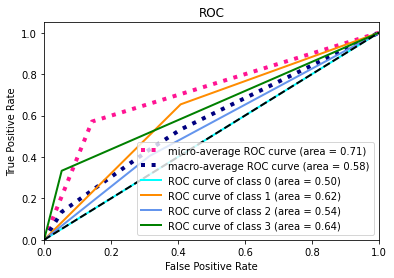

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 122  46   7]
 [  0  36  22   7]
 [  0   8   7   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542261 (macro),
0.567907 (weighted by prevalence)


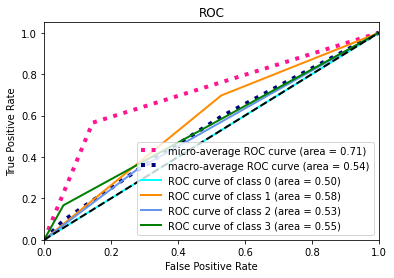

Accuracy: 56.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 121  54   8]
 [  0  22  17   8]
 [  0   7   9   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568281 (macro),
0.596801 (weighted by prevalence)


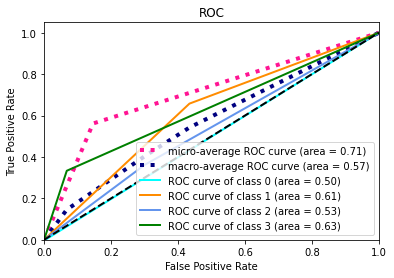

Accuracy: 59.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 133  40   8]
 [  0  29  12   6]
 [  0  11   9   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558189 (macro),
0.582522 (weighted by prevalence)


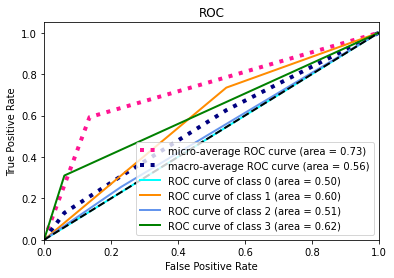

Accuracy: 51.0
Confusion matrix: 
[[  0   2   0   0]
 [  2 114  51  12]
 [  0  29  11  12]
 [  0   7  13   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.527511 (macro),
0.556208 (weighted by prevalence)


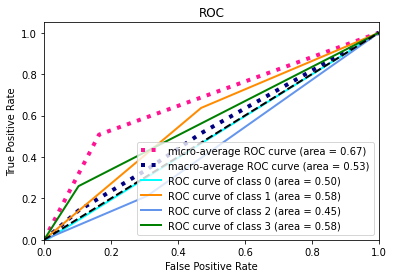

[I 2021-04-20 12:09:31,191] Trial 51 finished with value: 0.5546621030314419 and parameters: {'transformer_alpha': 0.9871971357021376, 'alpha': 0.0007622897422362718, 'n_layers': 2, 'n_units_layers_0': 174, 'n_units_layers_1': 177, 'lr': 1.2642534490333993e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 135  41   9]
 [  0  26  10   6]
 [  0  13  11   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552449 (macro),
0.589522 (weighted by prevalence)


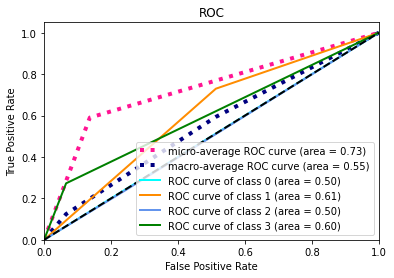

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 126  41   8]
 [  0  37  21   7]
 [  0   8   7   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544413 (macro),
0.572779 (weighted by prevalence)


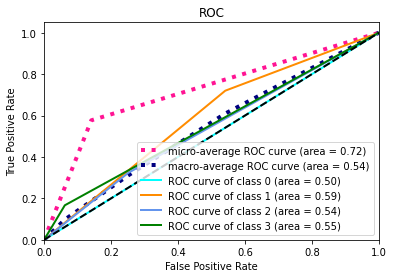

Accuracy: 56.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 115  60   9]
 [  0  18  23   6]
 [  0   6  10   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.585298 (macro),
0.617343 (weighted by prevalence)


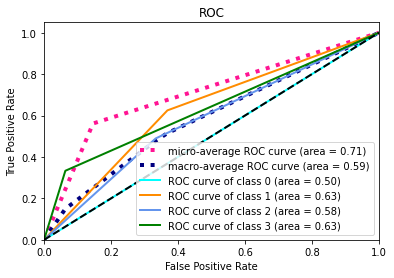

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 121  54   6]
 [  1  24  18   4]
 [  0   9  12   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564327 (macro),
0.593632 (weighted by prevalence)


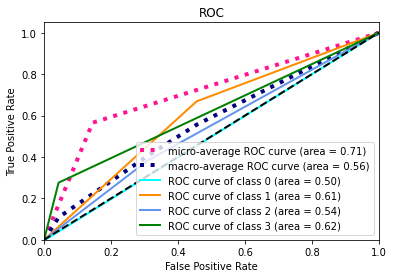

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 129  39  11]
 [  0  27  13  12]
 [  0   2  15  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575000 (macro),
0.629478 (weighted by prevalence)


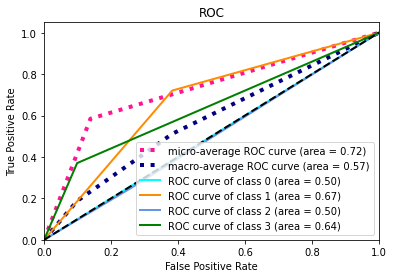

[I 2021-04-20 12:10:44,050] Trial 52 finished with value: 0.5642972043345414 and parameters: {'transformer_alpha': 0.9258170968281215, 'alpha': 0.000489534936321779, 'n_layers': 2, 'n_units_layers_0': 153, 'n_units_layers_1': 193, 'lr': 1.2198860705041889e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 61.0
Confusion matrix: 
[[  0   0   0   1]
 [  0 139  34  12]
 [  0  26  13   3]
 [  0  20   6   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551864 (macro),
0.570957 (weighted by prevalence)


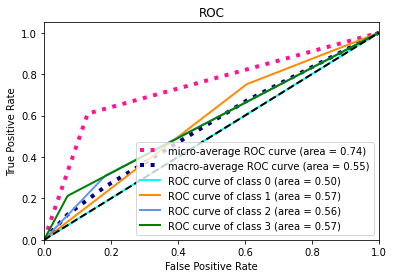

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 145  24   6]
 [  0  44  12   9]
 [  0  11   2   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553962 (macro),
0.570366 (weighted by prevalence)


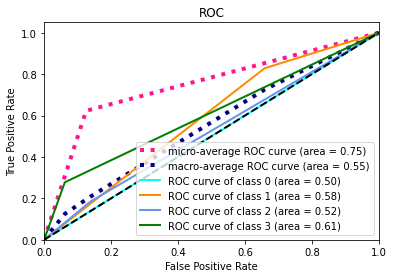

Accuracy: 58.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 127  43  13]
 [  0  26  14   7]
 [  0   5   9  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575842 (macro),
0.600990 (weighted by prevalence)


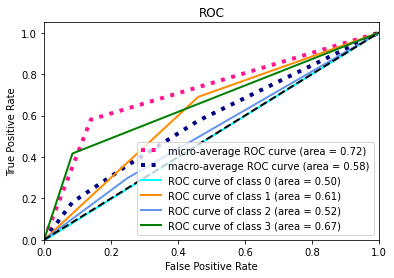

Accuracy: 58.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 130  39  12]
 [  1  29  12   5]
 [  0   8  13   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552684 (macro),
0.586028 (weighted by prevalence)


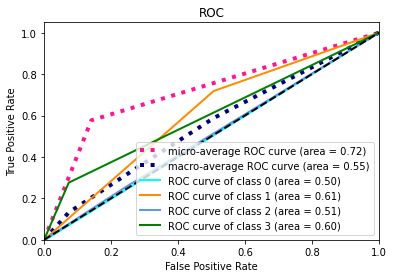

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 125  40  14]
 [  0  30  11  11]
 [  0   6  14   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542577 (macro),
0.585745 (weighted by prevalence)


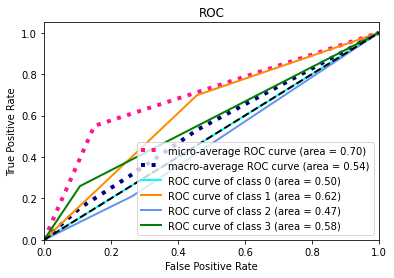

[I 2021-04-20 12:12:34,355] Trial 53 finished with value: 0.5553855715227355 and parameters: {'transformer_alpha': 0.9853775082323674, 'alpha': 7.984981872465051e-05, 'n_layers': 2, 'n_units_layers_0': 201, 'n_units_layers_1': 262, 'lr': 2.634334858130189e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 64.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 151  24   9]
 [  0  29   9   4]
 [  0  16  10   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552656 (macro),
0.589311 (weighted by prevalence)


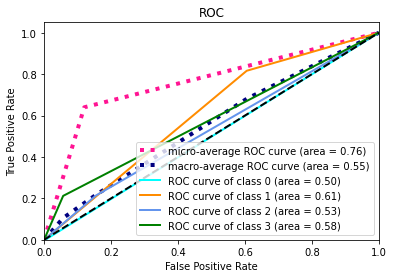

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 142  28   5]
 [  0  40  13  12]
 [  0   5   7   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568590 (macro),
0.601980 (weighted by prevalence)


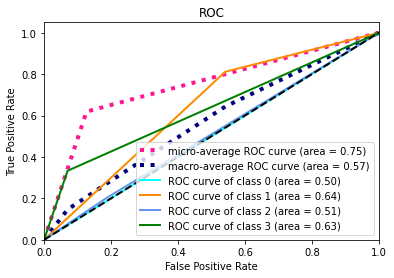

Accuracy: 61.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 143  32   9]
 [  0  32   7   8]
 [  0   9   6   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555676 (macro),
0.572150 (weighted by prevalence)


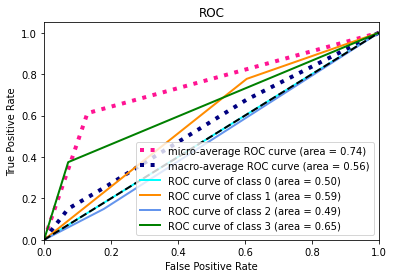

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   1]
 [  0 126  42  13]
 [  1  24  17   5]
 [  0   9  13   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.563977 (macro),
0.606302 (weighted by prevalence)


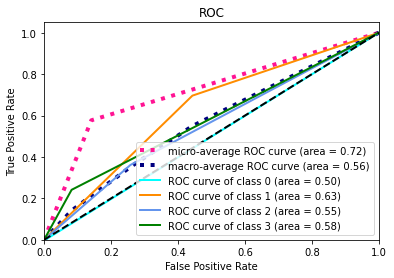

Accuracy: 60.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 131  41   7]
 [  0  28  14  10]
 [  0   9   8  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572678 (macro),
0.604990 (weighted by prevalence)


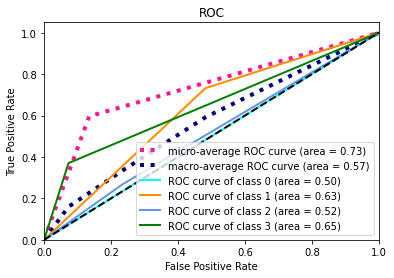

[I 2021-04-20 12:13:41,066] Trial 54 finished with value: 0.5627154858533254 and parameters: {'transformer_alpha': 0.10564078193733915, 'alpha': 0.00022591313713537608, 'n_layers': 3, 'n_units_layers_0': 149, 'n_units_layers_1': 123, 'n_units_layers_2': 26, 'lr': 5.089026222430538e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 61.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 133  42   9]
 [  0  22  15   5]
 [  0  11  12  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.578561 (macro),
0.624699 (weighted by prevalence)


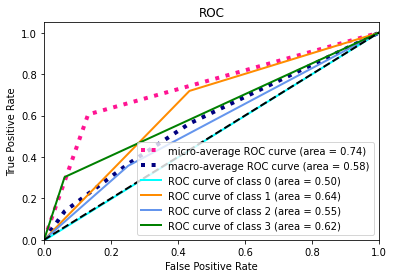

Accuracy: 58.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 115  57   3]
 [  0  25  35   5]
 [  0   5  13   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555047 (macro),
0.622385 (weighted by prevalence)


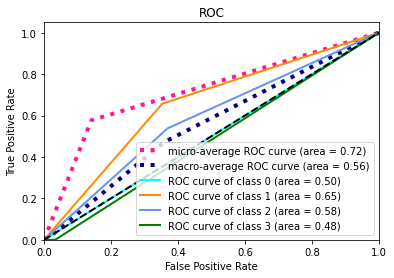

Accuracy: 48.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 105  73   6]
 [  0  23  20   4]
 [  0   5  19   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.512017 (macro),
0.549977 (weighted by prevalence)


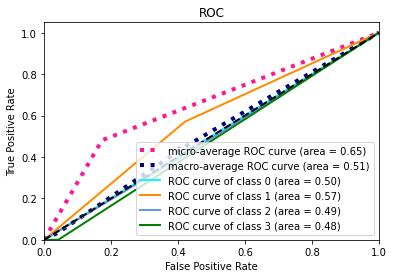

Accuracy: 50.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 105  74   2]
 [  0  24  23   0]
 [  0   6  22   1]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.529354 (macro),
0.565440 (weighted by prevalence)


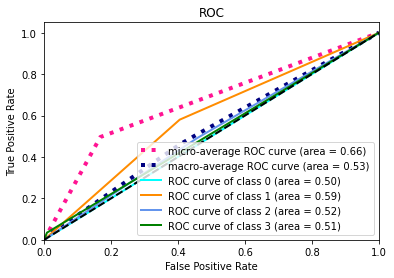

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 114  57   8]
 [  0  21  25   6]
 [  0   3  20   4]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564315 (macro),
0.624367 (weighted by prevalence)


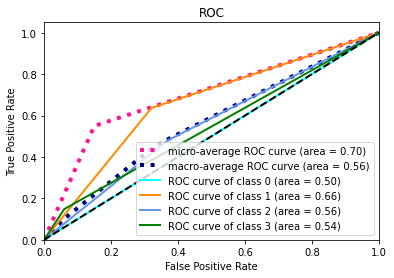

[I 2021-04-20 12:14:43,255] Trial 55 finished with value: 0.5478590369850497 and parameters: {'transformer_alpha': 0.31420443714682805, 'alpha': 0.0023836632317958384, 'n_layers': 3, 'n_units_layers_0': 99, 'n_units_layers_1': 216, 'n_units_layers_2': 145, 'lr': 6.31463061318121e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 132  42  11]
 [  0  24  16   2]
 [  0  12  14   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564451 (macro),
0.604512 (weighted by prevalence)


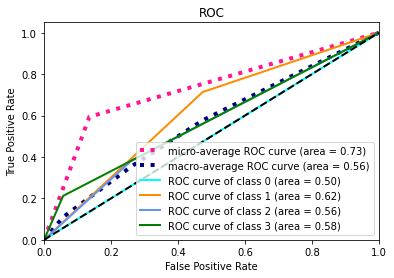

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 126  43   6]
 [  0  33  23   9]
 [  0   8   7   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552859 (macro),
0.591180 (weighted by prevalence)


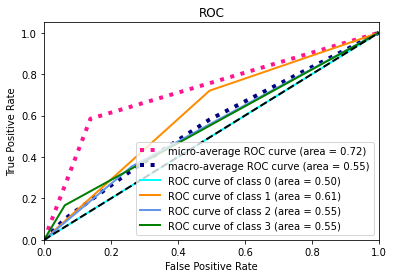

Accuracy: 57.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 120  57   6]
 [  0  19  18  10]
 [  0   5   8  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.592936 (macro),
0.625001 (weighted by prevalence)


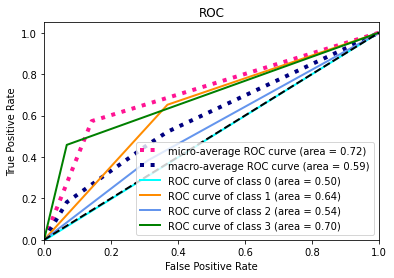

Accuracy: 55.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 119  51  11]
 [  1  24  21   1]
 [  0  10  15   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551018 (macro),
0.582974 (weighted by prevalence)


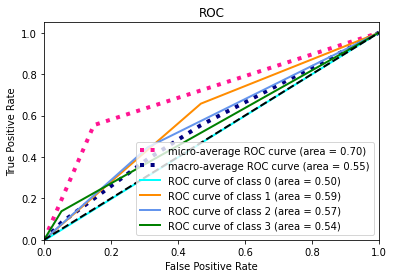

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  2 115  51  11]
 [  0  22  21   9]
 [  0   6  14   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566138 (macro),
0.611770 (weighted by prevalence)


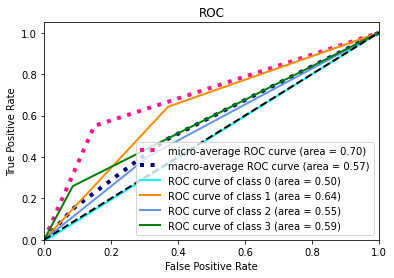

[I 2021-04-20 12:15:31,104] Trial 56 finished with value: 0.5654805480029105 and parameters: {'transformer_alpha': 0.6925490799843139, 'alpha': 0.0011333540222785313, 'n_layers': 2, 'n_units_layers_0': 116, 'n_units_layers_1': 144, 'lr': 1.6351296212345545e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 51.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 108  76   0]
 [  0  17  25   0]
 [  0  13  19   1]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.546548 (macro),
0.581530 (weighted by prevalence)


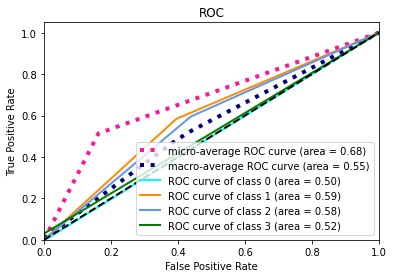

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 127  44   4]
 [  0  35  23   7]
 [  0   4   9   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.570547 (macro),
0.603517 (weighted by prevalence)


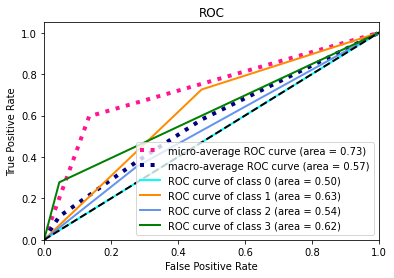

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 130  48   5]
 [  0  20  19   8]
 [  0   6  10   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.589171 (macro),
0.634631 (weighted by prevalence)


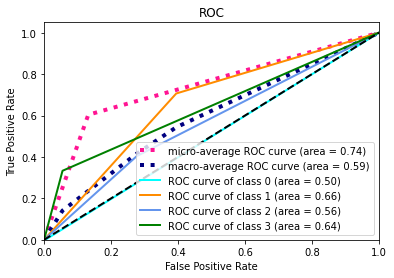

Accuracy: 56.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 126  47   8]
 [  0  32  12   3]
 [  0  10  11   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542222 (macro),
0.555230 (weighted by prevalence)


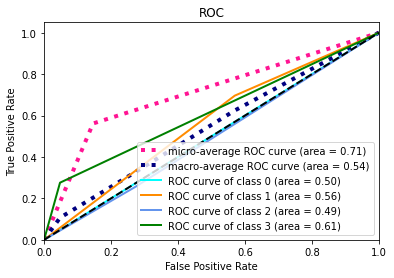

Accuracy: 51.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 101  74   4]
 [  0  20  31   1]
 [  0   8  19   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540182 (macro),
0.580528 (weighted by prevalence)


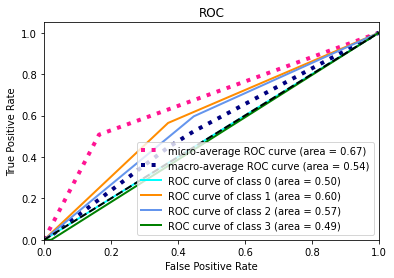

[I 2021-04-20 12:18:55,871] Trial 57 finished with value: 0.5577339689171278 and parameters: {'transformer_alpha': 0.49307696572286275, 'alpha': 0.004144636631696926, 'n_layers': 3, 'n_units_layers_0': 435, 'n_units_layers_1': 191, 'n_units_layers_2': 101, 'lr': 3.823198292737871e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 55.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 123  62   0]
 [  0  21  21   0]
 [  0  12  21   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.543387 (macro),
0.591114 (weighted by prevalence)


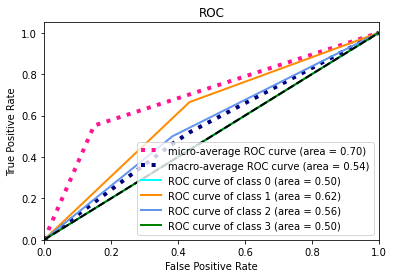

Accuracy: 53.0
Confusion matrix: 
[[ 0  1  0  1]
 [ 0 99 71  5]
 [ 0 26 35  4]
 [ 0  1 14  3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558026 (macro),
0.596684 (weighted by prevalence)


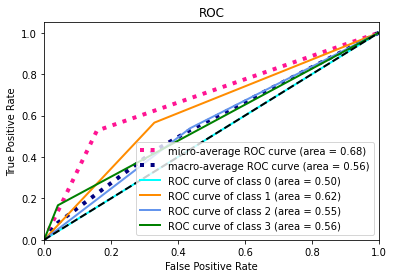

Accuracy: 58.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 135  49   0]
 [  0  31  16   0]
 [  0  12  12   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.520578 (macro),
0.545250 (weighted by prevalence)


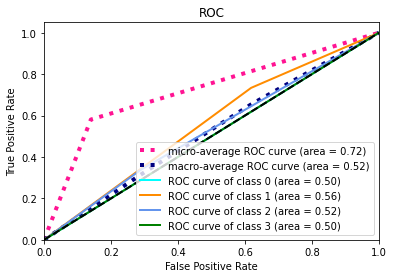

Accuracy: 42.0
Confusion matrix: 
[[  0   2   1   0]
 [  0  80 100   1]
 [  0  17  30   0]
 [  0   4  25   0]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.524159 (macro),
0.556491 (weighted by prevalence)


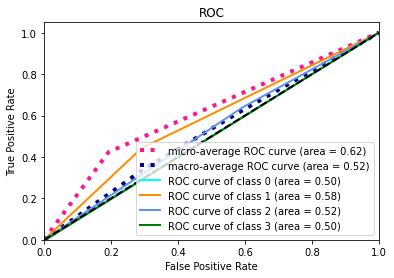

Accuracy: 40.0
Confusion matrix: 
[[  0   0   1   1]
 [  3  75 100   1]
 [  0  21  30   1]
 [  0  17  10   0]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.496078 (macro),
0.486353 (weighted by prevalence)


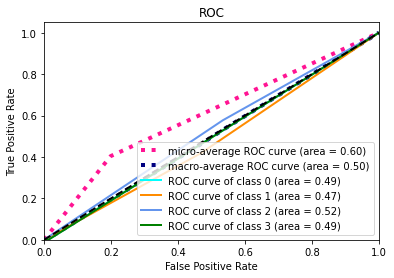

[I 2021-04-20 12:19:15,289] Trial 58 finished with value: 0.5284454417602718 and parameters: {'transformer_alpha': 0.21698543947726204, 'alpha': 0.024628066399437085, 'n_layers': 3, 'n_units_layers_0': 28, 'n_units_layers_1': 108, 'n_units_layers_2': 211, 'lr': 9.124074171729694e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 145  32   8]
 [  0  27  12   3]
 [  0  18  11   4]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542607 (macro),
0.575072 (weighted by prevalence)


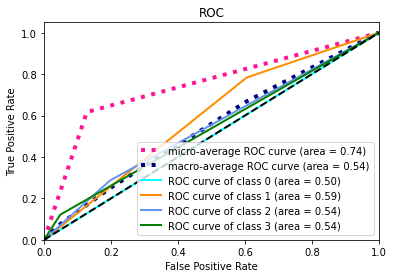

Accuracy: 59.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 138  28   9]
 [  0  43  12  10]
 [  0   8   6   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540706 (macro),
0.565118 (weighted by prevalence)


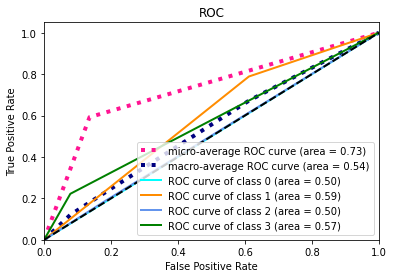

Accuracy: 62.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 144  28  12]
 [  0  26   8  13]
 [  0  12   3   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.563820 (macro),
0.591369 (weighted by prevalence)


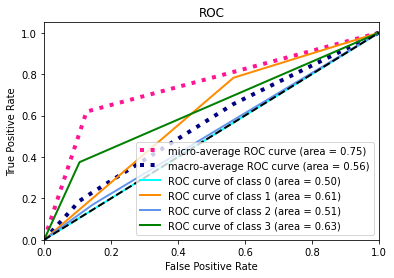

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 134  38   9]
 [  1  38   7   1]
 [  0  11  11   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.524399 (macro),
0.532272 (weighted by prevalence)


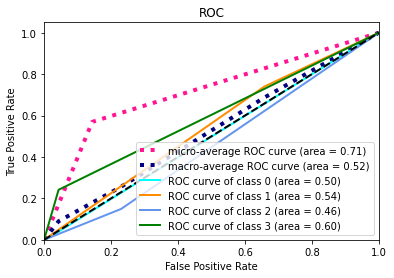

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 134  32  13]
 [  0  32   9  11]
 [  0  11   8   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545889 (macro),
0.574566 (weighted by prevalence)


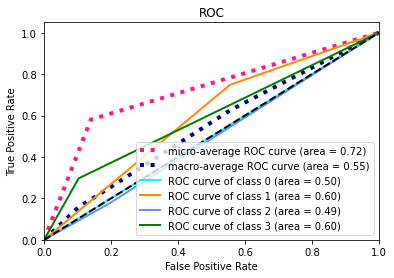

[I 2021-04-20 12:20:50,767] Trial 59 finished with value: 0.5434839783038197 and parameters: {'transformer_alpha': 0.5719087723186185, 'alpha': 0.0008019613960501765, 'n_layers': 4, 'n_units_layers_0': 319, 'n_units_layers_1': 173, 'n_units_layers_2': 132, 'n_units_layers_3': 437, 'lr': 4.0356660277900224e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 54.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 129  48   8]
 [  1  31   5   5]
 [  0  16  11   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.504539 (macro),
0.519075 (weighted by prevalence)


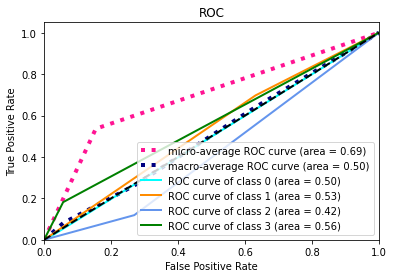

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 134  37   4]
 [  0  36  19  10]
 [  0   9   3   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572759 (macro),
0.595358 (weighted by prevalence)


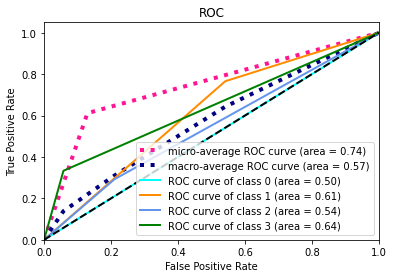

Accuracy: 65.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 148  27   9]
 [  0  28  11   8]
 [  0   5   9  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.590309 (macro),
0.633708 (weighted by prevalence)


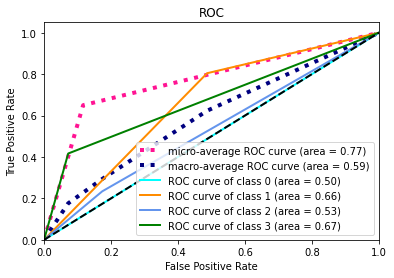

Accuracy: 56.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 132  40   9]
 [  1  33   9   4]
 [  0  12  12   5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.522661 (macro),
0.544053 (weighted by prevalence)


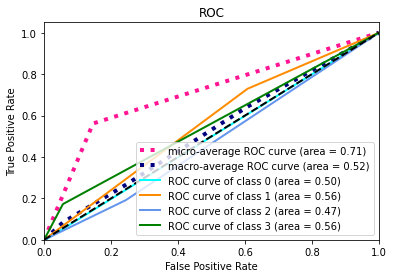

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 131  34  14]
 [  0  29  13  10]
 [  0   9   9   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.563952 (macro),
0.598219 (weighted by prevalence)


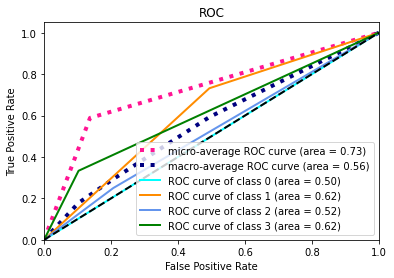

[I 2021-04-20 12:22:59,021] Trial 60 finished with value: 0.5508440621100028 and parameters: {'transformer_alpha': 0.798360643176258, 'alpha': 0.006412576579792581, 'n_layers': 2, 'n_units_layers_0': 201, 'n_units_layers_1': 256, 'lr': 2.4853849763411368e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 62.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 134  37  13]
 [  0  22  16   4]
 [  0  10  10  13]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.597572 (macro),
0.640681 (weighted by prevalence)


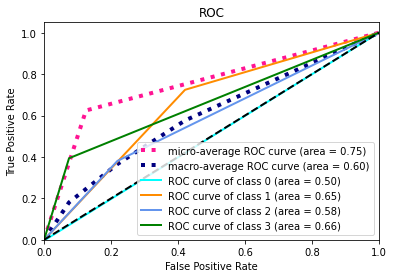

Accuracy: 55.0
Confusion matrix: 
[[  0   0   2   0]
 [  1 114  52   8]
 [  0  29  25  11]
 [  0   3  11   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558259 (macro),
0.603904 (weighted by prevalence)


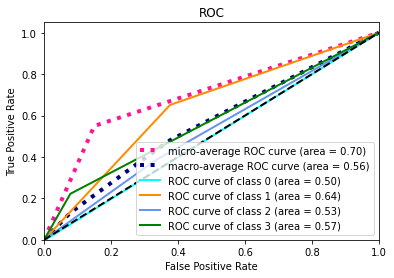

Accuracy: 59.0
Confusion matrix: 
[[  0   4   0   1]
 [  1 128  43  12]
 [  0  26  14   7]
 [  0   9   4  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.578672 (macro),
0.588759 (weighted by prevalence)


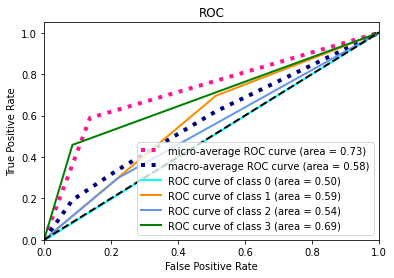

Accuracy: 38.0
Confusion matrix: 
[[  0   2   1   0]
 [  0  66 115   0]
 [  0  15  32   0]
 [  0   5  24   0]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.513717 (macro),
0.532121 (weighted by prevalence)


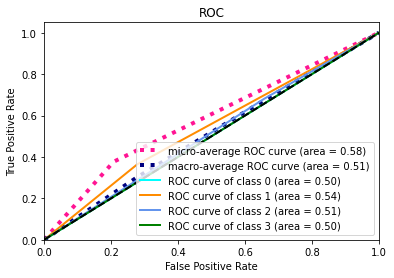

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  2 119  43  15]
 [  0  21  22   9]
 [  0   4  15   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.582655 (macro),
0.638532 (weighted by prevalence)


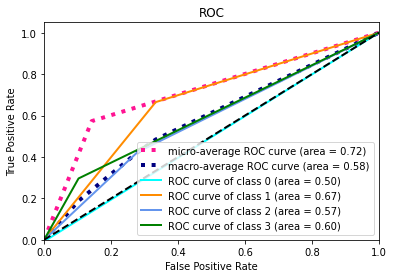

[I 2021-04-20 12:24:16,730] Trial 61 finished with value: 0.566175074379594 and parameters: {'transformer_alpha': 0.1262467979055928, 'alpha': 0.009914673654961428, 'n_layers': 3, 'n_units_layers_0': 91, 'n_units_layers_1': 55, 'n_units_layers_2': 260, 'lr': 1.454732429299949e-05}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 61.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 135  38  12]
 [  0  21  15   6]
 [  0  12  13   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572337 (macro),
0.624700 (weighted by prevalence)


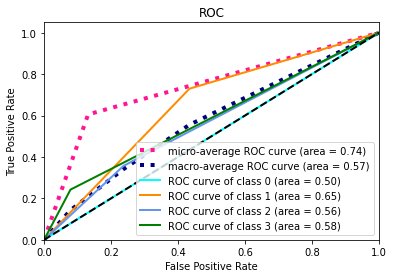

Accuracy: 57.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 116  53   6]
 [  0  31  28   6]
 [  0   4  11   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557560 (macro),
0.600093 (weighted by prevalence)


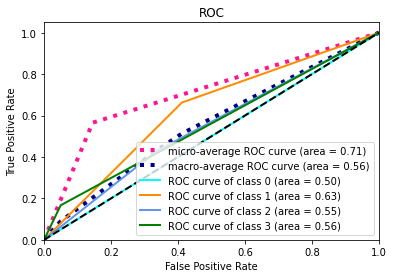

Accuracy: 52.0
Confusion matrix: 
[[  0   2   3   0]
 [  0 105  72   7]
 [  0  19  28   0]
 [  0   7  16   1]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.547844 (macro),
0.587344 (weighted by prevalence)


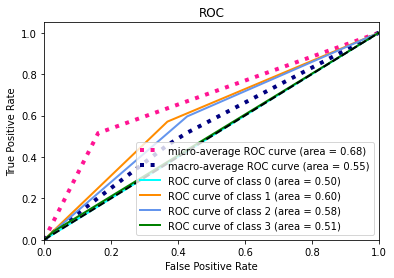

Accuracy: 55.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 108  62  11]
 [  0  17  27   3]
 [  0   5  15   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.593862 (macro),
0.634700 (weighted by prevalence)


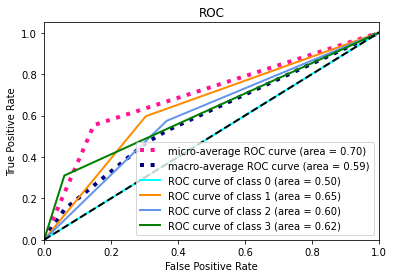

Accuracy: 54.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 105  68   6]
 [  0  15  31   6]
 [  0   2  21   4]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577117 (macro),
0.643023 (weighted by prevalence)


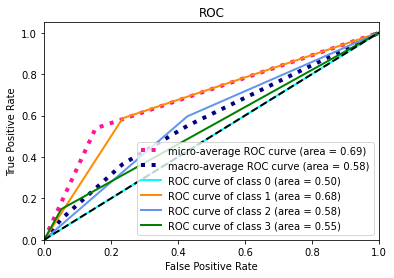

[I 2021-04-20 12:25:14,105] Trial 62 finished with value: 0.5697441057553585 and parameters: {'transformer_alpha': 0.18690069770771367, 'alpha': 0.001585758640007928, 'n_layers': 3, 'n_units_layers_0': 82, 'n_units_layers_1': 92, 'n_units_layers_2': 241, 'lr': 8.469216088694125e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 123  49  13]
 [  0  24  16   2]
 [  0   8  15  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.570650 (macro),
0.608177 (weighted by prevalence)


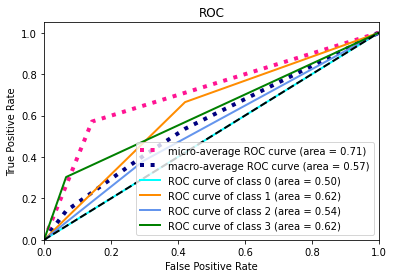

Accuracy: 52.0
Confusion matrix: 
[[ 0  1  1  0]
 [ 0 96 78  1]
 [ 0 27 38  0]
 [ 0  5 13  0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.533628 (macro),
0.567919 (weighted by prevalence)


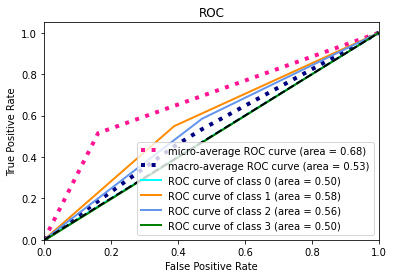

Accuracy: 32.0
Confusion matrix: 
[[  0   0   5   0]
 [  0  39 142   3]
 [  0   3  41   3]
 [  0   1  19   4]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549196 (macro),
0.571301 (weighted by prevalence)


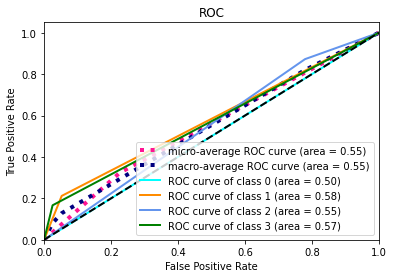

Accuracy: 51.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 103  72   6]
 [  0  16  27   4]
 [  0   6  20   3]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556913 (macro),
0.604165 (weighted by prevalence)


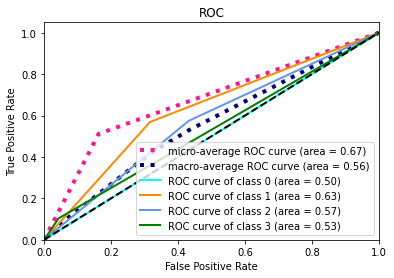

Accuracy: 54.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 113  55  10]
 [  0  24  22   6]
 [  0   3  19   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556651 (macro),
0.606830 (weighted by prevalence)


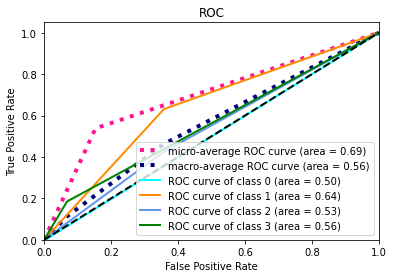

[I 2021-04-20 12:26:03,304] Trial 63 finished with value: 0.5534076476857985 and parameters: {'transformer_alpha': 0.18397798363471063, 'alpha': 0.0017112040949214837, 'n_layers': 3, 'n_units_layers_0': 73, 'n_units_layers_1': 92, 'n_units_layers_2': 163, 'lr': 8.105820233941082e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 58.0
Confusion matrix: 
[[  0   0   1   0]
 [  4 138  38   5]
 [  0  32   7   3]
 [  0  19   8   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.519787 (macro),
0.531932 (weighted by prevalence)


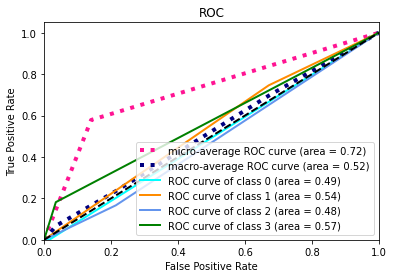

Accuracy: 60.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 132  43   0]
 [  0  41  23   1]
 [  0   6  12   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.532344 (macro),
0.575309 (weighted by prevalence)


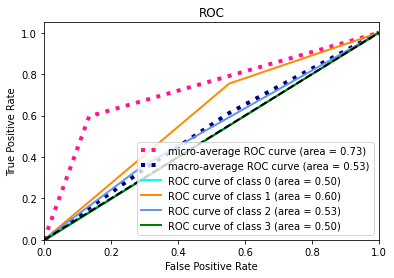

Accuracy: 61.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 137  47   0]
 [  0  25  22   0]
 [  0   9  15   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551052 (macro),
0.597881 (weighted by prevalence)


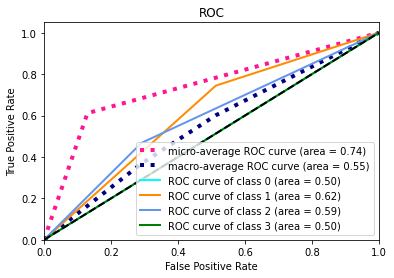

Accuracy: 55.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 114  67   0]
 [  0  17  29   1]
 [  0   7  21   1]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566257 (macro),
0.624358 (weighted by prevalence)


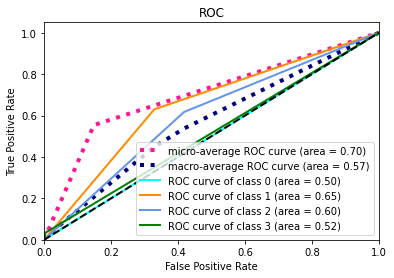

Accuracy: 35.0
Confusion matrix: 
[[  0   0   2   0]
 [  6  53 118   2]
 [  2  13  36   1]
 [  1   0  24   2]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.520239 (macro),
0.549720 (weighted by prevalence)


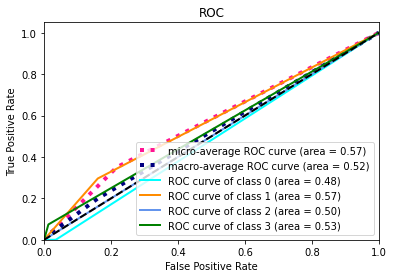

[I 2021-04-20 12:26:48,005] Trial 64 finished with value: 0.537935567529337 and parameters: {'transformer_alpha': 0.07203126472063577, 'alpha': 0.0028910218319979845, 'n_layers': 3, 'n_units_layers_0': 135, 'n_units_layers_1': 72, 'n_units_layers_2': 199, 'lr': 3.1284114585244606e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 63.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 151  34   0]
 [  0  29  13   0]
 [  0  23  10   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.528432 (macro),
0.550859 (weighted by prevalence)


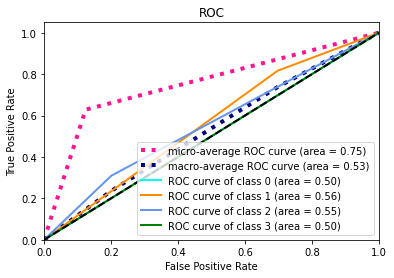

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 117  55   3]
 [  0  38  26   1]
 [  0   4  14   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.523398 (macro),
0.559307 (weighted by prevalence)


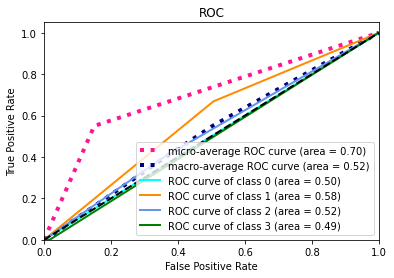

Accuracy: 48.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 100  75   9]
 [  0  24  18   5]
 [  0   6  11   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537873 (macro),
0.542429 (weighted by prevalence)


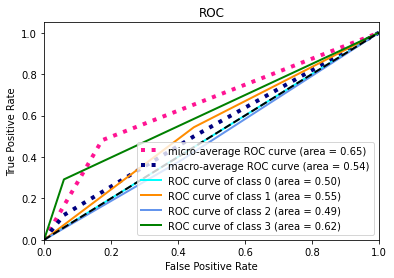

Accuracy: 52.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 107  68   6]
 [  0  20  23   4]
 [  0   6  18   5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.554850 (macro),
0.592933 (weighted by prevalence)


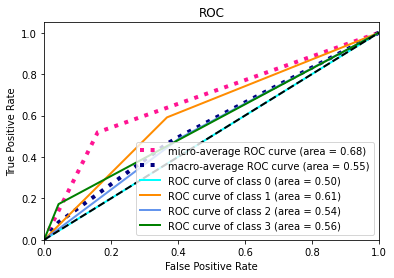

Accuracy: 59.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 130  49   0]
 [  0  29  22   1]
 [  0   5  21   1]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.551079 (macro),
0.611132 (weighted by prevalence)


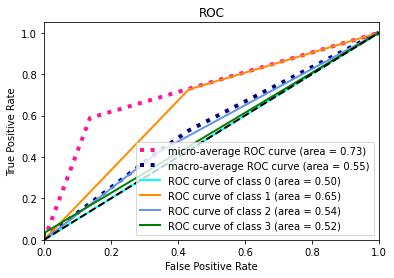

[I 2021-04-20 12:27:37,607] Trial 65 finished with value: 0.5391265505214222 and parameters: {'transformer_alpha': 0.25496755351735656, 'alpha': 0.0013716316642003637, 'n_layers': 3, 'n_units_layers_0': 117, 'n_units_layers_1': 46, 'n_units_layers_2': 239, 'lr': 4.6569275845109815e-06}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 150  29   6]
 [  1  31   6   4]
 [  0  20   8   5]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.525540 (macro),
0.549567 (weighted by prevalence)


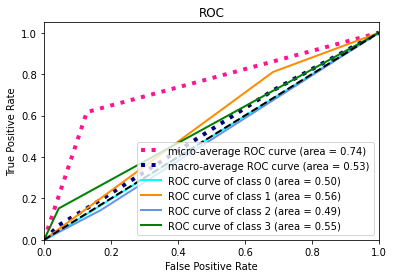

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 150  18   7]
 [  0  47  10   8]
 [  0  11   5   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.530365 (macro),
0.560411 (weighted by prevalence)


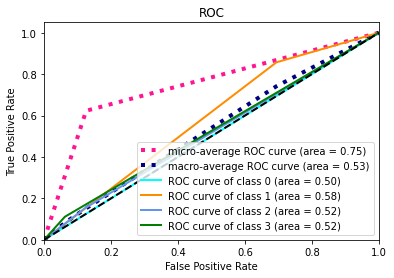

Accuracy: 67.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 158  16  10]
 [  0  28   9  10]
 [  0  13   5   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.563948 (macro),
0.605700 (weighted by prevalence)


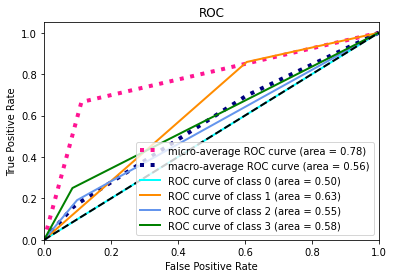

Accuracy: 64.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 148  27   6]
 [  1  30  15   1]
 [  0  16   9   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557408 (macro),
0.592251 (weighted by prevalence)


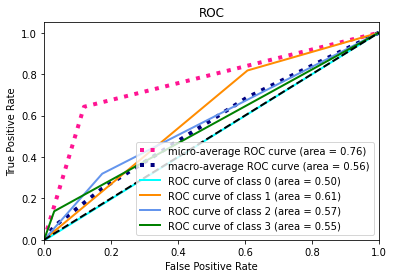

Accuracy: 61.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 144  22  12]
 [  0  39   5   8]
 [  0  13   5   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.543471 (macro),
0.556906 (weighted by prevalence)


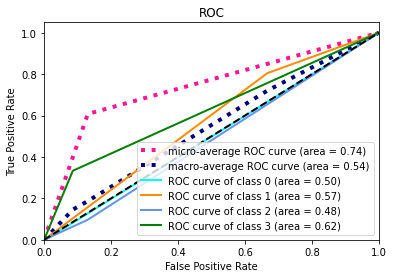

[I 2021-04-20 12:27:47,230] Trial 66 finished with value: 0.5441463608836385 and parameters: {'transformer_alpha': 0.10018468938507219, 'alpha': 0.00025905952622811183, 'n_layers': 3, 'n_units_layers_0': 167, 'n_units_layers_1': 32, 'n_units_layers_2': 105, 'lr': 0.0018211805797819984}. Best is trial 10 with value: 0.5819825875340439.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 122  53  10]
 [  0  19  17   6]
 [  0   5  14  14]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.599000 (macro),
0.651766 (weighted by prevalence)


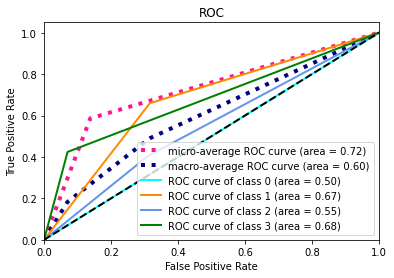

Accuracy: 52.0
Confusion matrix: 
[[ 0  0  2  0]
 [ 0 91 72 12]
 [ 0 18 42  5]
 [ 0  3 13  2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564226 (macro),
0.618270 (weighted by prevalence)


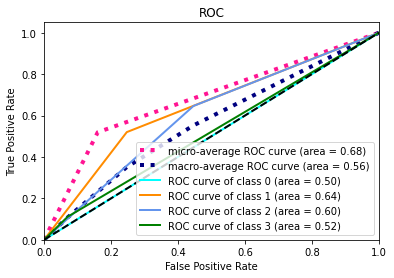

Accuracy: 59.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 118  53  13]
 [  0  15  25   7]
 [  0   8   5  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.614319 (macro),
0.641498 (weighted by prevalence)


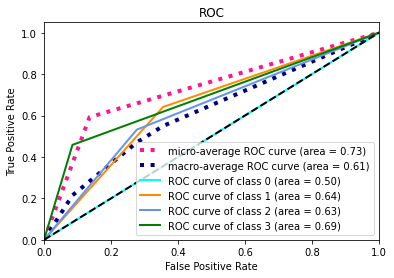

Accuracy: 51.0
Confusion matrix: 
[[  0   1   2   0]
 [  2 101  69   9]
 [  0  17  25   5]
 [  0   7  16   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562941 (macro),
0.603353 (weighted by prevalence)


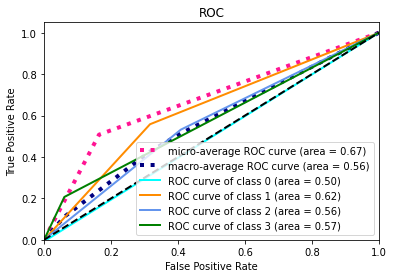

Accuracy: 54.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 109  59  11]
 [  0  25  18   9]
 [  0   1  13  13]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.582363 (macro),
0.611165 (weighted by prevalence)


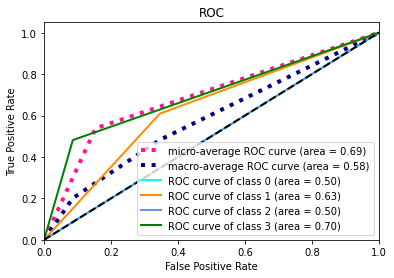

[I 2021-04-20 12:28:55,046] Trial 67 finished with value: 0.5845695333848809 and parameters: {'transformer_alpha': 0.22924204724601027, 'alpha': 0.0004677514030472196, 'n_layers': 3, 'n_units_layers_0': 29, 'n_units_layers_1': 336, 'n_units_layers_2': 65, 'lr': 1.0579781645837789e-05}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 145  32   8]
 [  0  30   8   4]
 [  0  19   8   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.532863 (macro),
0.553413 (weighted by prevalence)


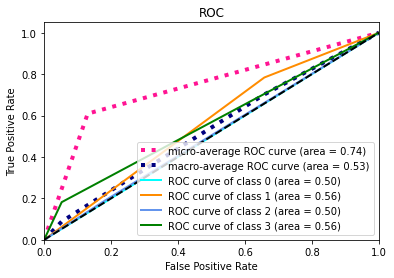

Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   1]
 [  0 140  26   9]
 [  0  39  18   8]
 [  0  10   5   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552750 (macro),
0.589205 (weighted by prevalence)


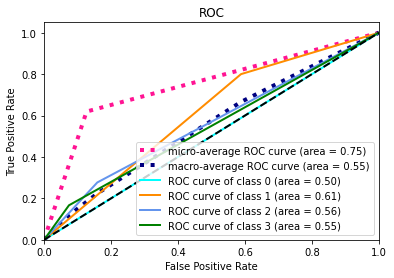

Accuracy: 59.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 136  38  10]
 [  0  28   8  11]
 [  0  10   5   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.554519 (macro),
0.575906 (weighted by prevalence)


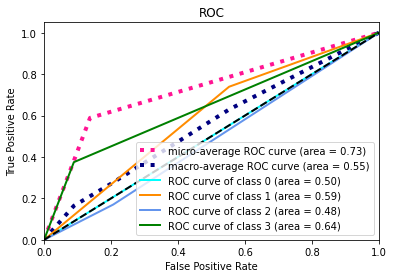

Accuracy: 63.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 144  28   9]
 [  0  30  15   2]
 [  0  11  12   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566156 (macro),
0.603813 (weighted by prevalence)


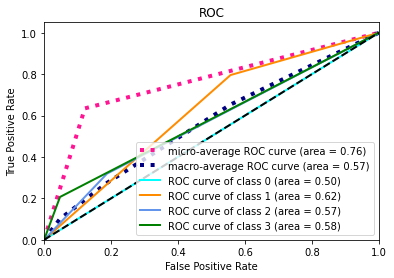

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 128  39  12]
 [  0  24  18  10]
 [  0   9  15   3]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.548277 (macro),
0.606933 (weighted by prevalence)


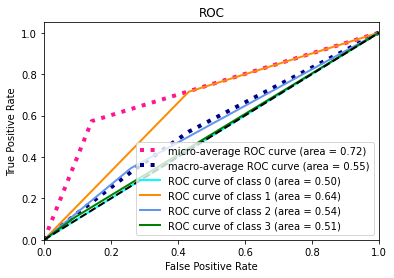

[I 2021-04-20 12:32:13,160] Trial 68 finished with value: 0.550913106703267 and parameters: {'transformer_alpha': 0.36532873113265274, 'alpha': 0.0004033179190202914, 'n_layers': 3, 'n_units_layers_0': 386, 'n_units_layers_1': 334, 'n_units_layers_2': 70, 'lr': 1.8519859236104793e-05}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 39.0
Confusion matrix: 
[[  0   0   1   0]
 [  0  70 115   0]
 [  0  11  31   0]
 [  0   2  31   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.534274 (macro),
0.578857 (weighted by prevalence)


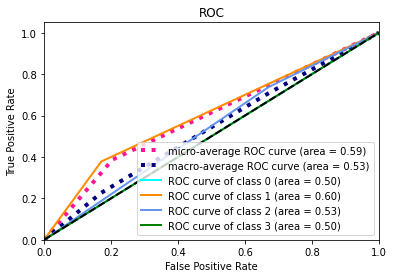

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 115  54   5]
 [  0  33  27   5]
 [  0   2  10   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575475 (macro),
0.598969 (weighted by prevalence)


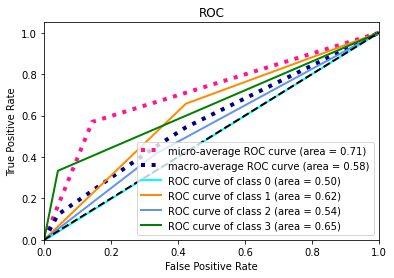

Accuracy: 48.0
Confusion matrix: 
[[ 0  4  1  0]
 [ 0 97 87  0]
 [ 0 18 29  0]
 [ 0  3 21  0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537939 (macro),
0.579658 (weighted by prevalence)


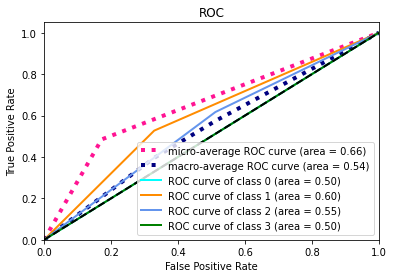

Accuracy: 52.0
Confusion matrix: 
[[  0   2   1   0]
 [  0 108  70   3]
 [  0  21  26   0]
 [  0   7  20   2]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549860 (macro),
0.590018 (weighted by prevalence)


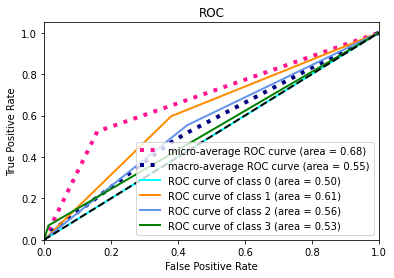

Accuracy: 56.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 113  56  10]
 [  0  20  29   3]
 [  0   4  20   3]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.569740 (macro),
0.628917 (weighted by prevalence)


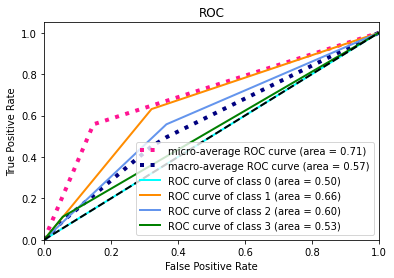

[I 2021-04-20 12:32:57,507] Trial 69 finished with value: 0.5534574721474946 and parameters: {'transformer_alpha': 0.0006463836005042856, 'alpha': 0.0005427277914022547, 'n_layers': 4, 'n_units_layers_0': 35, 'n_units_layers_1': 286, 'n_units_layers_2': 10, 'n_units_layers_3': 306, 'lr': 1.1211795396441614e-05}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 60.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 133  38  13]
 [  0  22  14   6]
 [  0  10  13  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575127 (macro),
0.622867 (weighted by prevalence)


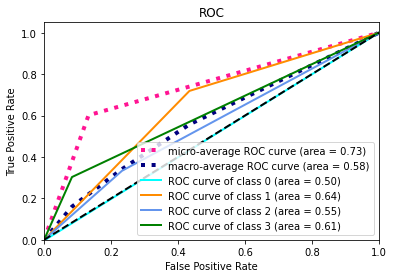

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 131  37   7]
 [  0  35  20  10]
 [  0   6   7   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.567363 (macro),
0.602433 (weighted by prevalence)


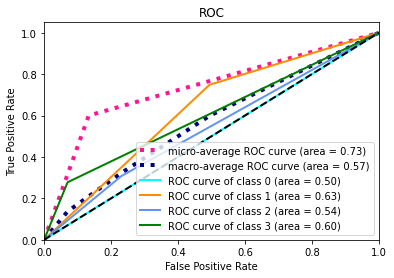

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 133  42   9]
 [  0  27  15   5]
 [  0   8   8   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.570424 (macro),
0.594042 (weighted by prevalence)


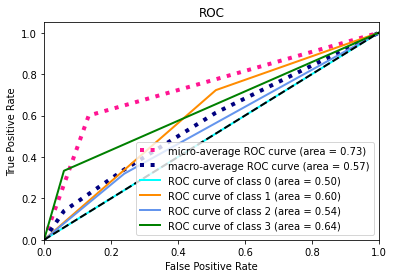

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 118  57   6]
 [  0  22  21   4]
 [  0   9  11   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577021 (macro),
0.603541 (weighted by prevalence)


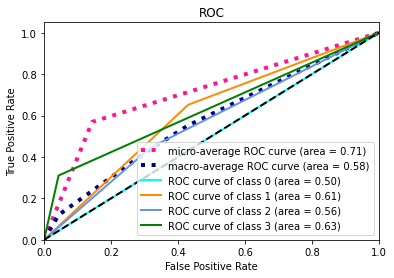

Accuracy: 61.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 124  41  14]
 [  0  18  25   9]
 [  0   5  12  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.610214 (macro),
0.668919 (weighted by prevalence)


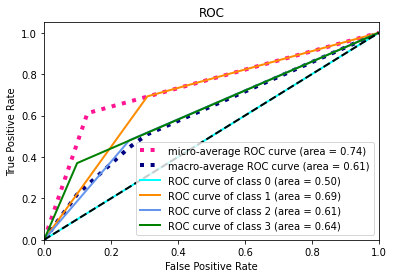

[I 2021-04-20 12:38:43,881] Trial 70 finished with value: 0.5800299420174653 and parameters: {'transformer_alpha': 0.2941390750399397, 'alpha': 8.028514122980237e-05, 'n_layers': 3, 'n_units_layers_0': 485, 'n_units_layers_1': 306, 'n_units_layers_2': 77, 'lr': 5.7632088843578195e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   0   1]
 [  0 126  46  13]
 [  0  22  15   5]
 [  0  15  10   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556846 (macro),
0.587058 (weighted by prevalence)


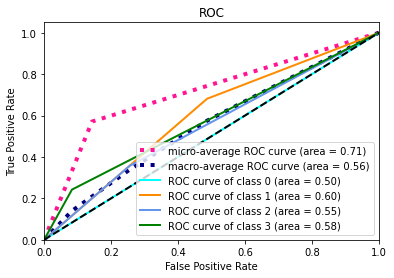

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 134  34   7]
 [  0  34  20  11]
 [  0   4   9   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.574042 (macro),
0.620578 (weighted by prevalence)


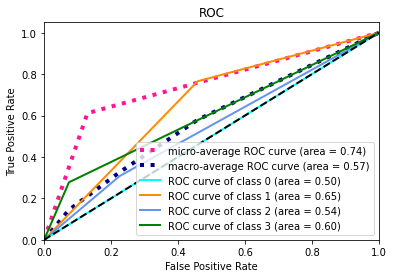

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 127  47  10]
 [  0  17  20  10]
 [  0   4  10  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.605803 (macro),
0.657003 (weighted by prevalence)


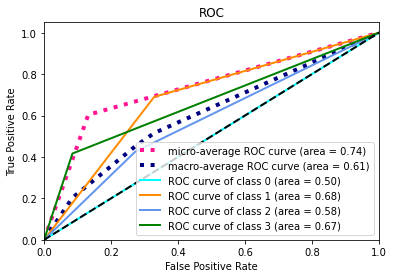

Accuracy: 61.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 131  43   7]
 [  0  24  20   3]
 [  0  11  11   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.576606 (macro),
0.611088 (weighted by prevalence)


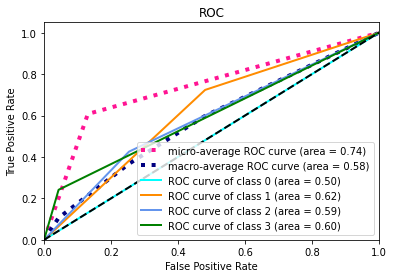

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 127  40  12]
 [  0  22  23   7]
 [  0   5  14   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.594557 (macro),
0.654176 (weighted by prevalence)


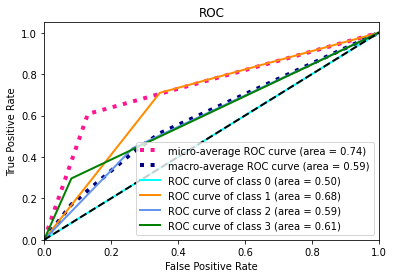

[I 2021-04-20 12:45:50,303] Trial 71 finished with value: 0.5815706336820969 and parameters: {'transformer_alpha': 0.27557879681678704, 'alpha': 4.957384726327777e-05, 'n_layers': 3, 'n_units_layers_0': 485, 'n_units_layers_1': 304, 'n_units_layers_2': 82, 'lr': 5.708894418093055e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 62.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 135  42   8]
 [  0  18  20   4]
 [  0   9  17   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.592022 (macro),
0.659066 (weighted by prevalence)


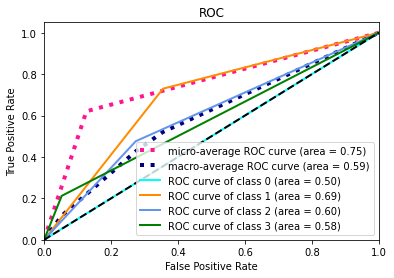

Accuracy: 48.0
Confusion matrix: 
[[ 0  1  1  0]
 [ 1 93 68 13]
 [ 0 28 27 10]
 [ 0  3  9  6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550595 (macro),
0.562306 (weighted by prevalence)


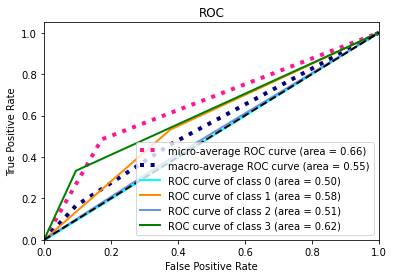

Accuracy: 48.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 100  75   9]
 [  0  19  19   9]
 [  0   6  12   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540842 (macro),
0.564502 (weighted by prevalence)


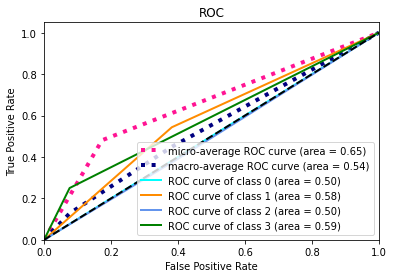

Accuracy: 62.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 149  23   9]
 [  0  37   6   4]
 [  0  18   6   5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.524584 (macro),
0.536698 (weighted by prevalence)


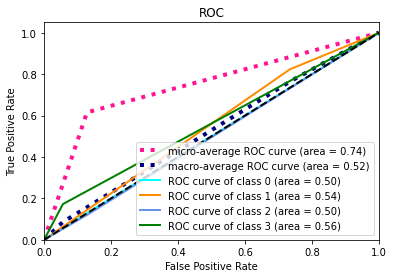

Accuracy: 52.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 106  61  12]
 [  0  20  24   8]
 [  0   6  16   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.554649 (macro),
0.599146 (weighted by prevalence)


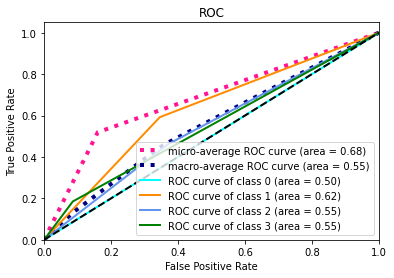

[I 2021-04-20 12:49:47,346] Trial 72 finished with value: 0.5525384523596069 and parameters: {'transformer_alpha': 0.22412984648946957, 'alpha': 7.399251766484618e-05, 'n_layers': 3, 'n_units_layers_0': 481, 'n_units_layers_1': 306, 'n_units_layers_2': 38, 'lr': 2.4903282805733826e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 128  47  10]
 [  0  19  17   6]
 [  0  12  11  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.581526 (macro),
0.626262 (weighted by prevalence)


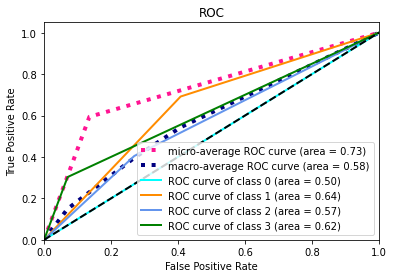

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 132  35   8]
 [  0  29  27   9]
 [  0   4   8   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.600889 (macro),
0.652056 (weighted by prevalence)


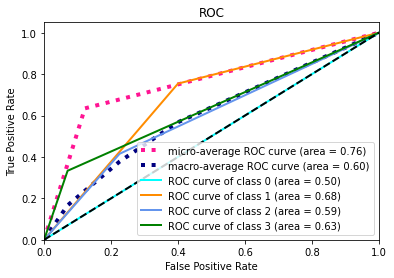

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 132  46   6]
 [  0  20  18   9]
 [  0   7  11   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575827 (macro),
0.628123 (weighted by prevalence)


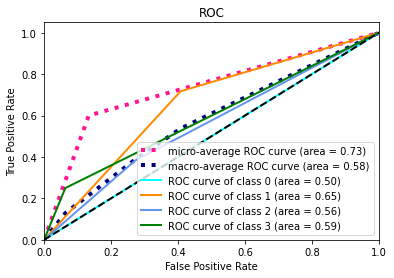

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 133  41   7]
 [  0  27  18   2]
 [  0  12  11   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.563743 (macro),
0.592631 (weighted by prevalence)


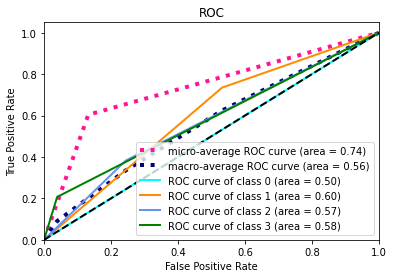

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 121  42  15]
 [  0  23  18  11]
 [  0   7  11   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573766 (macro),
0.617333 (weighted by prevalence)


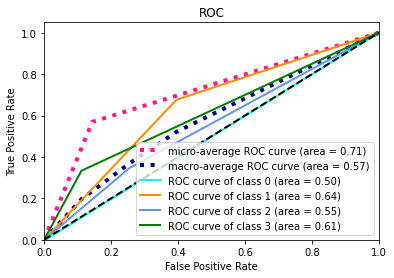

[I 2021-04-20 12:56:50,386] Trial 73 finished with value: 0.5791503258998857 and parameters: {'transformer_alpha': 0.2905181646462097, 'alpha': 1.709312191927709e-05, 'n_layers': 3, 'n_units_layers_0': 498, 'n_units_layers_1': 339, 'n_units_layers_2': 80, 'lr': 6.214110643610192e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 64.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 143  36   6]
 [  0  26  12   4]
 [  0  15   7  11]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.574898 (macro),
0.603581 (weighted by prevalence)


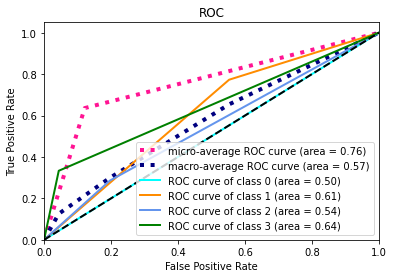

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 132  33  10]
 [  0  33  23   9]
 [  0   4  10   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572393 (macro),
0.624394 (weighted by prevalence)


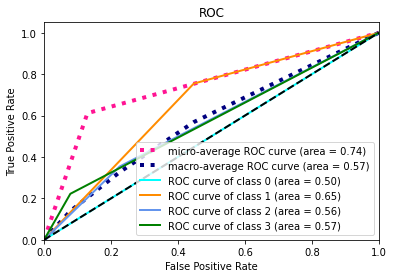

Accuracy: 62.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 135  42   6]
 [  0  20  15  12]
 [  0   8   5  11]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.598073 (macro),
0.636701 (weighted by prevalence)


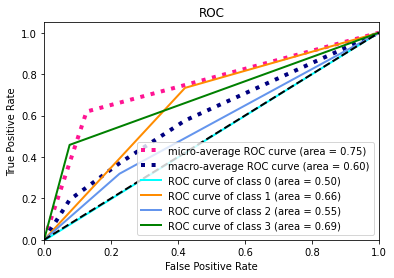

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 122  53   6]
 [  0  24  20   3]
 [  0   6  16   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.570040 (macro),
0.609687 (weighted by prevalence)


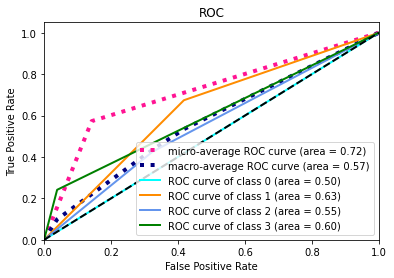

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 123  44  12]
 [  0  28  15   9]
 [  0  10  12   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.539394 (macro),
0.577176 (weighted by prevalence)


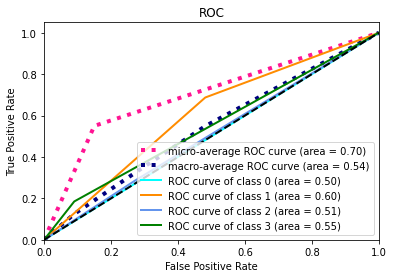

[I 2021-04-20 13:04:51,006] Trial 74 finished with value: 0.5709592904142753 and parameters: {'transformer_alpha': 0.2922049184100629, 'alpha': 1.2404891702178974e-05, 'n_layers': 3, 'n_units_layers_0': 500, 'n_units_layers_1': 330, 'n_units_layers_2': 81, 'lr': 6.477441390785964e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 56.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 128  43  14]
 [  0  24  15   3]
 [  0  12  18   3]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537500 (macro),
0.580029 (weighted by prevalence)


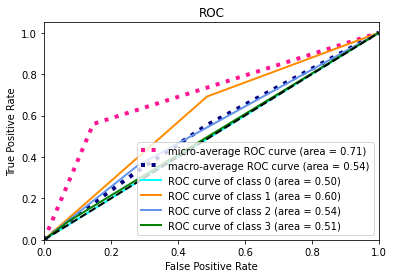

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 129  38   8]
 [  0  36  19  10]
 [  0   5  10   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.547042 (macro),
0.590110 (weighted by prevalence)


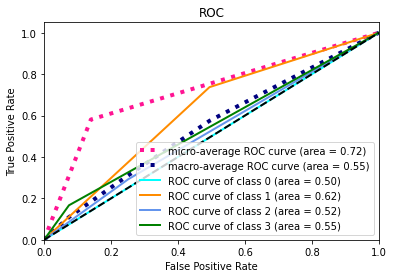

Accuracy: 51.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 101  78   5]
 [  0  15  25   7]
 [  0   4  14   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.567591 (macro),
0.604951 (weighted by prevalence)


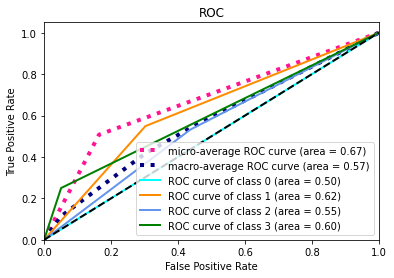

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 126  46   9]
 [  0  27  18   2]
 [  0   9   9  11]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.582364 (macro),
0.600247 (weighted by prevalence)


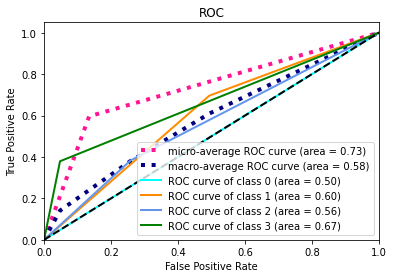

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 117  50  12]
 [  0  20  23   9]
 [  0   5  13   9]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.588808 (macro),
0.640596 (weighted by prevalence)


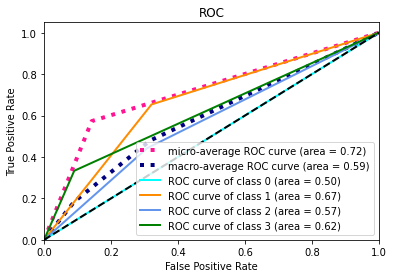

[I 2021-04-20 13:11:40,142] Trial 75 finished with value: 0.564661185376107 and parameters: {'transformer_alpha': 0.2605481462611733, 'alpha': 3.323023592797785e-05, 'n_layers': 3, 'n_units_layers_0': 449, 'n_units_layers_1': 379, 'n_units_layers_2': 67, 'lr': 3.7796626459669376e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 62.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 135  41   9]
 [  0  21  17   4]
 [  0  10  13  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.590184 (macro),
0.641973 (weighted by prevalence)


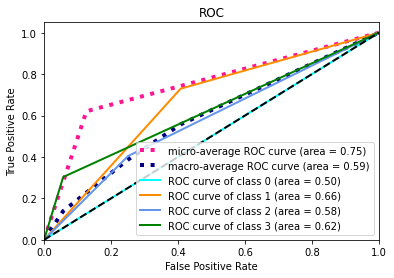

Accuracy: 59.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 127  39   8]
 [  0  36  22   7]
 [  0   4  10   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560222 (macro),
0.597689 (weighted by prevalence)


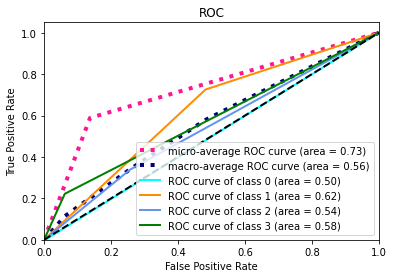

Accuracy: 61.0
Confusion matrix: 
[[  0   4   0   1]
 [  0 132  43   9]
 [  0  19  18  10]
 [  0   8   8   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.587703 (macro),
0.633961 (weighted by prevalence)


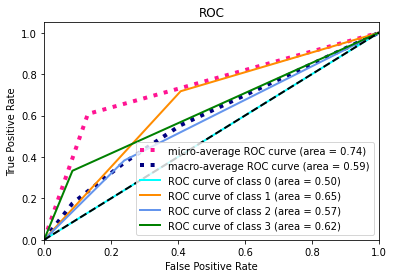

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 130  43   8]
 [  0  26  20   1]
 [  0  12  11   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.567399 (macro),
0.594265 (weighted by prevalence)


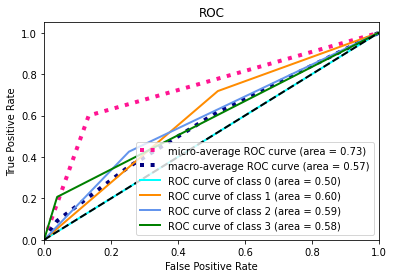

Accuracy: 59.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 127  42  10]
 [  0  24  18  10]
 [  0   5  14   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577713 (macro),
0.634877 (weighted by prevalence)


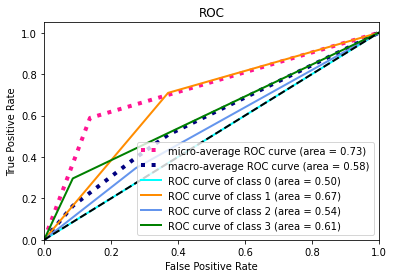

[I 2021-04-20 13:19:35,133] Trial 76 finished with value: 0.5766440591390868 and parameters: {'transformer_alpha': 0.3561955031470646, 'alpha': 3.946480379741e-05, 'n_layers': 3, 'n_units_layers_0': 475, 'n_units_layers_1': 348, 'n_units_layers_2': 40, 'lr': 5.39542499024625e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 60.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 138  39   7]
 [  0  26  13   3]
 [  0  13  14   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553731 (macro),
0.596280 (weighted by prevalence)


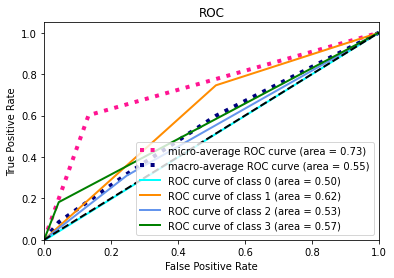

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 131  40   4]
 [  0  34  28   3]
 [  0   5  13   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550363 (macro),
0.611782 (weighted by prevalence)


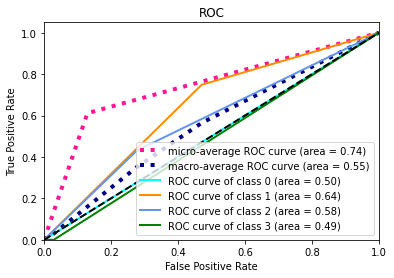

Accuracy: 41.0
Confusion matrix: 
[[  0   1   4   0]
 [  8  68 100   8]
 [  5   5  35   2]
 [  2   4  15   3]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555973 (macro),
0.604270 (weighted by prevalence)


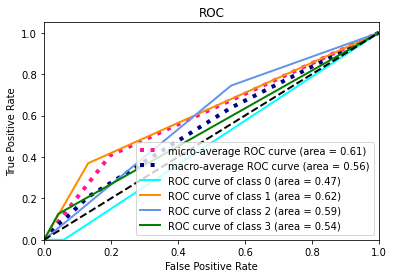

Accuracy: 52.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 113  57  11]
 [  1  23  19   4]
 [  0  10  15   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537993 (macro),
0.568725 (weighted by prevalence)


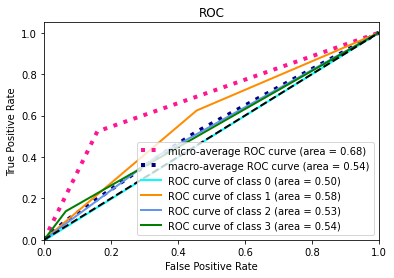

Accuracy: 55.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 110  61   8]
 [  0  19  25   8]
 [  0   3  17   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577766 (macro),
0.633786 (weighted by prevalence)


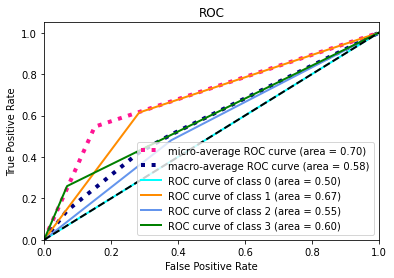

[I 2021-04-20 13:25:50,380] Trial 77 finished with value: 0.5551652234937963 and parameters: {'transformer_alpha': 0.39781056110232615, 'alpha': 1.638014787214291e-05, 'n_layers': 3, 'n_units_layers_0': 478, 'n_units_layers_1': 358, 'n_units_layers_2': 41, 'lr': 2.460320598343113e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 124  47  14]
 [  0  21  15   6]
 [  0   7  17   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.568400 (macro),
0.623528 (weighted by prevalence)


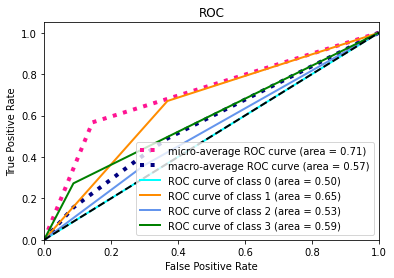

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 133  38   4]
 [  0  33  24   8]
 [  0   5   7   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.589782 (macro),
0.627846 (weighted by prevalence)


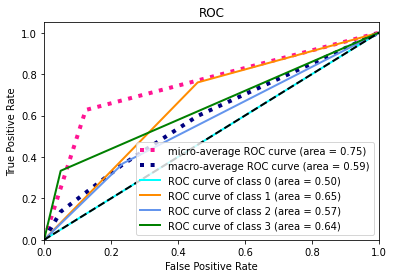

Accuracy: 58.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 129  48   7]
 [  0  22  17   8]
 [  0   9   9   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564550 (macro),
0.601807 (weighted by prevalence)


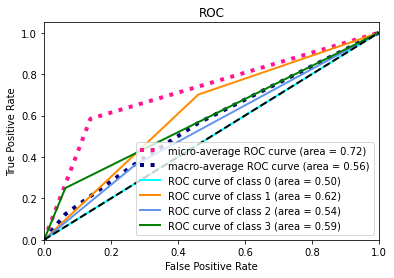

Accuracy: 58.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 124  48   9]
 [  0  25  19   3]
 [  0   8  13   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.571396 (macro),
0.602985 (weighted by prevalence)


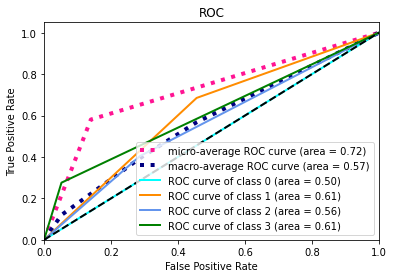

Accuracy: 60.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 127  38  14]
 [  0  22  20  10]
 [  0   5  12  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.595384 (macro),
0.649293 (weighted by prevalence)


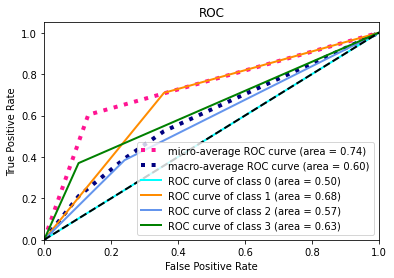

[I 2021-04-20 13:31:10,838] Trial 78 finished with value: 0.5779024031675897 and parameters: {'transformer_alpha': 0.33638341066932603, 'alpha': 4.199003902182641e-05, 'n_layers': 3, 'n_units_layers_0': 453, 'n_units_layers_1': 324, 'n_units_layers_2': 16, 'lr': 5.8611214572641e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 56.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 117  56  12]
 [  0  18  21   3]
 [  0   9  15   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.581917 (macro),
0.625090 (weighted by prevalence)


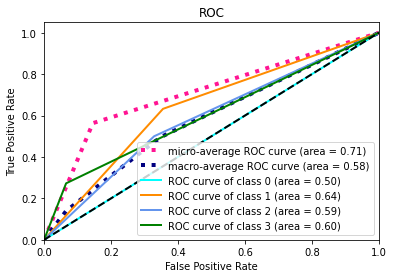

Accuracy: 63.0
Confusion matrix: 
[[  0   0   2   0]
 [  0 134  34   7]
 [  0  34  25   6]
 [  0   4  10   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.579485 (macro),
0.631662 (weighted by prevalence)


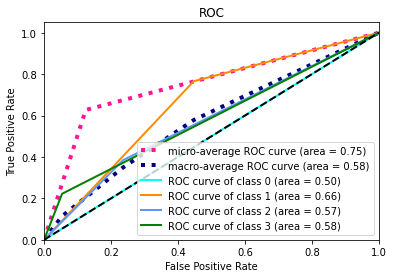

Accuracy: 57.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 119  59   6]
 [  0  17  22   8]
 [  0   6  12   6]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.576526 (macro),
0.623693 (weighted by prevalence)


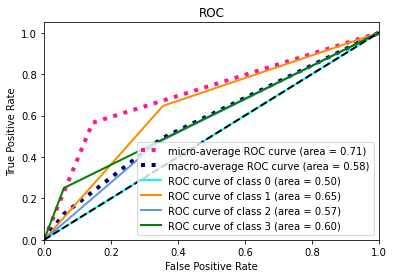

Accuracy: 56.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 122  52   7]
 [  0  25  20   2]
 [  0  10  15   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550371 (macro),
0.582736 (weighted by prevalence)


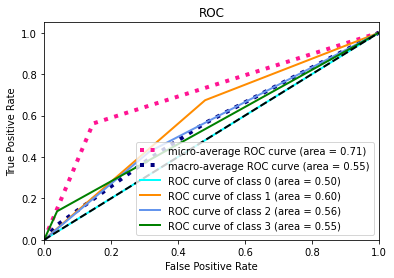

Accuracy: 53.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 108  65   6]
 [  0  24  25   3]
 [  0   6  16   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555774 (macro),
0.588444 (weighted by prevalence)


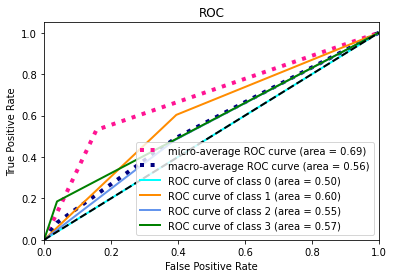

[I 2021-04-20 13:34:53,761] Trial 79 finished with value: 0.5688147704603553 and parameters: {'transformer_alpha': 0.3416640662126111, 'alpha': 5.7746884608195315e-05, 'n_layers': 3, 'n_units_layers_0': 453, 'n_units_layers_1': 345, 'n_units_layers_2': 17, 'lr': 5.2402190464587286e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 119  59   7]
 [  0  17  22   3]
 [  0   5  21   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.584497 (macro),
0.648402 (weighted by prevalence)


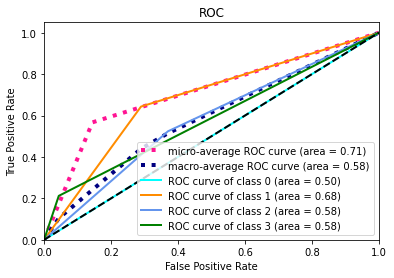

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 135  40   0]
 [  1  38  26   0]
 [  1   7  10   0]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545120 (macro),
0.594767 (weighted by prevalence)


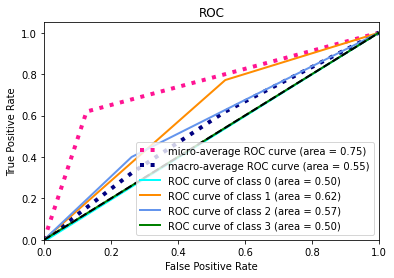

Accuracy: 54.0
Confusion matrix: 
[[  0   4   1   0]
 [  1 109  71   3]
 [  0  16  28   3]
 [  0   7  14   3]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565596 (macro),
0.605818 (weighted by prevalence)


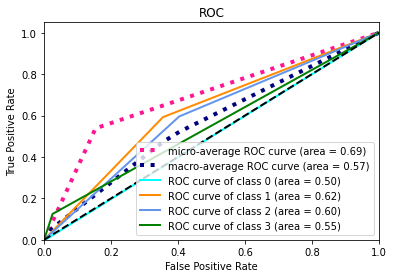

Accuracy: 60.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 126  44  11]
 [  0  22  23   2]
 [  0   9  14   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.579179 (macro),
0.620521 (weighted by prevalence)


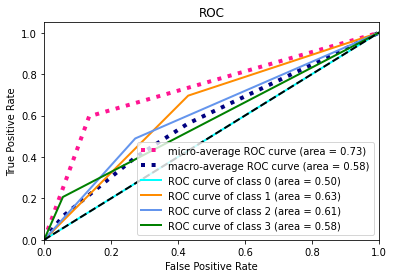

Accuracy: 49.0
Confusion matrix: 
[[ 0  1  1  0]
 [ 0 97 76  6]
 [ 0 20 30  2]
 [ 0  3 23  1]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.543057 (macro),
0.594300 (weighted by prevalence)


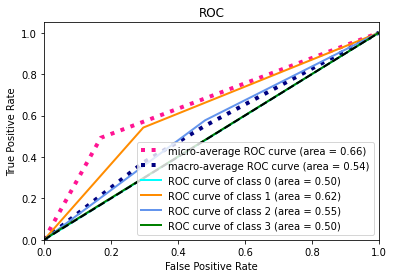

[I 2021-04-20 13:41:12,313] Trial 80 finished with value: 0.5634900959251405 and parameters: {'transformer_alpha': 0.42953946950836225, 'alpha': 3.7531210986728255e-05, 'n_layers': 3, 'n_units_layers_0': 498, 'n_units_layers_1': 326, 'n_units_layers_2': 22, 'lr': 2.035287142310665e-06}. Best is trial 67 with value: 0.5845695333848809.


Accuracy: 62.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 135  41   9]
 [  0  18  19   5]
 [  0   6  18   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.600459 (macro),
0.674417 (weighted by prevalence)


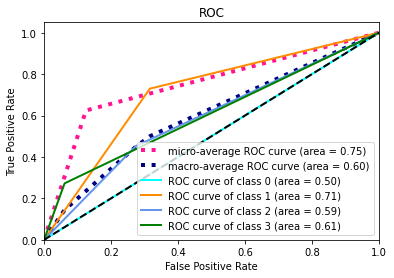

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 130  39   5]
 [  0  33  29   3]
 [  0   0  16   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572001 (macro),
0.637943 (weighted by prevalence)


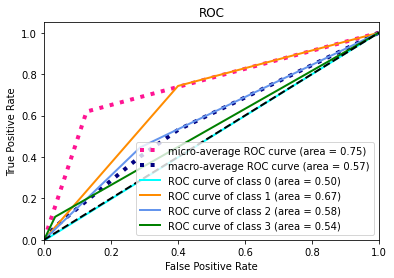

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 125  50   9]
 [  0  16  22   9]
 [  0   6  10   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.597001 (macro),
0.647619 (weighted by prevalence)


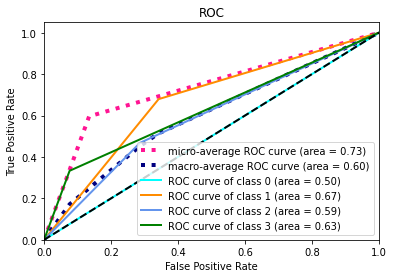

Accuracy: 56.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 116  54  11]
 [  0  20  23   4]
 [  0   8  15   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.569482 (macro),
0.609358 (weighted by prevalence)


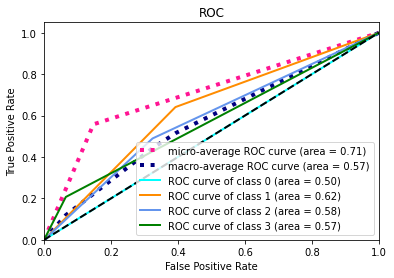

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 114  50  15]
 [  0  22  23   7]
 [  0   5  12  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.587378 (macro),
0.624739 (weighted by prevalence)


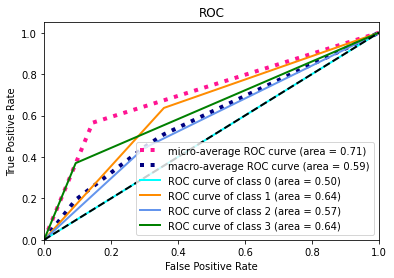

[I 2021-04-20 13:45:55,009] Trial 81 finished with value: 0.5852642949837652 and parameters: {'transformer_alpha': 0.28680208711753563, 'alpha': 9.704325532215102e-05, 'n_layers': 3, 'n_units_layers_0': 438, 'n_units_layers_1': 343, 'n_units_layers_2': 82, 'lr': 4.319404041609115e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 58.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 134  44   7]
 [  0  27  11   4]
 [  0  13  14   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540510 (macro),
0.578016 (weighted by prevalence)


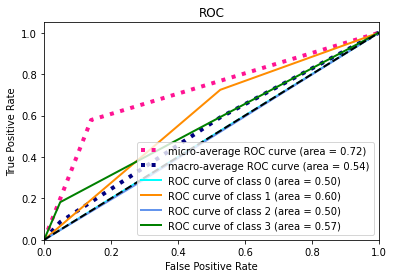

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 134  34   7]
 [  0  40  19   6]
 [  0   5  11   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.542293 (macro),
0.584604 (weighted by prevalence)


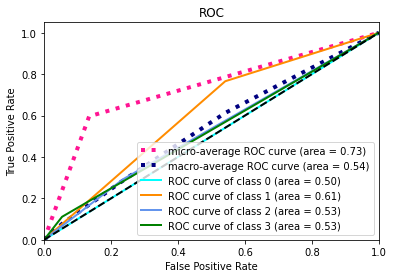

Accuracy: 61.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 134  39  11]
 [  0  25  15   7]
 [  0   6   8  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.587741 (macro),
0.618925 (weighted by prevalence)


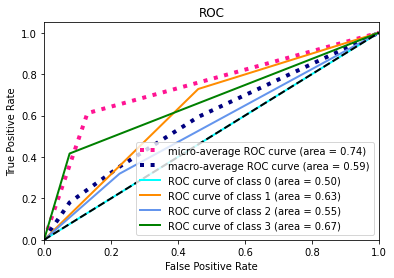

Accuracy: 59.0
Confusion matrix: 
[[  0   3   0   0]
 [  2 133  40   6]
 [  0  30  15   2]
 [  0  10  13   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553163 (macro),
0.582228 (weighted by prevalence)


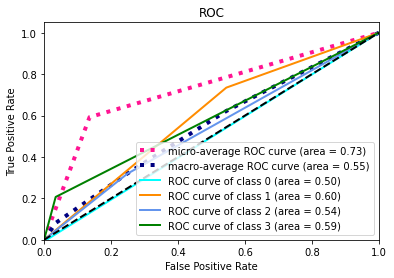

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 119  47  13]
 [  0  28  18   6]
 [  0   5  12  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573004 (macro),
0.601351 (weighted by prevalence)


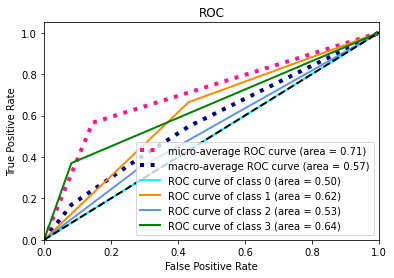

[I 2021-04-20 13:55:57,591] Trial 82 finished with value: 0.5593421351734674 and parameters: {'transformer_alpha': 0.30955965496576343, 'alpha': 0.00010607347874076169, 'n_layers': 3, 'n_units_layers_0': 443, 'n_units_layers_1': 376, 'n_units_layers_2': 57, 'lr': 4.365732851455664e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 61.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 138  40   7]
 [  0  26  12   4]
 [  0  14   9  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566477 (macro),
0.598564 (weighted by prevalence)


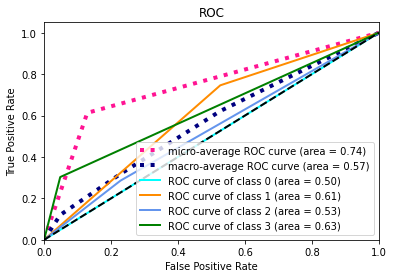

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 136  29  10]
 [  0  36  23   6]
 [  0   7   6   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.580049 (macro),
0.615811 (weighted by prevalence)


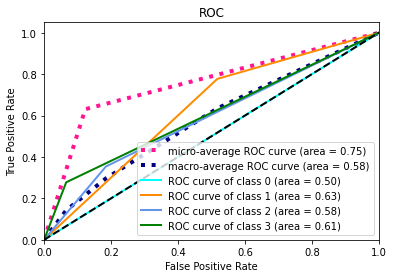

Accuracy: 56.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 122  56   6]
 [  0  23  14  10]
 [  0   3  11  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.574475 (macro),
0.609109 (weighted by prevalence)


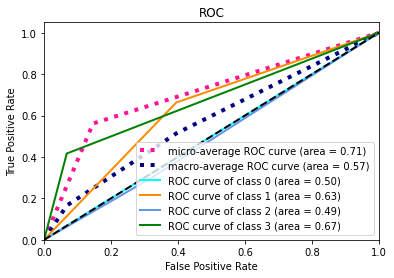

Accuracy: 61.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 130  45   6]
 [  1  26  18   2]
 [  0  12   7  10]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.580550 (macro),
0.599179 (weighted by prevalence)


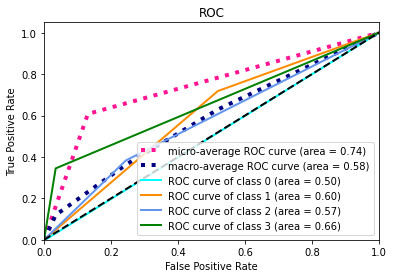

Accuracy: 57.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 115  49  14]
 [  0  20  24   8]
 [  0   3  14  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.596510 (macro),
0.648857 (weighted by prevalence)


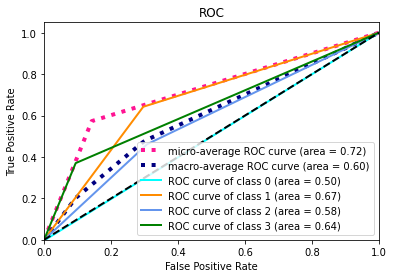

[I 2021-04-20 14:04:00,951] Trial 83 finished with value: 0.579612142714646 and parameters: {'transformer_alpha': 0.27952303113312343, 'alpha': 1.9358305551884575e-05, 'n_layers': 3, 'n_units_layers_0': 466, 'n_units_layers_1': 402, 'n_units_layers_2': 39, 'lr': 6.424847405360518e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 126  50   9]
 [  0  23  15   4]
 [  0  11  13   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564291 (macro),
0.601688 (weighted by prevalence)


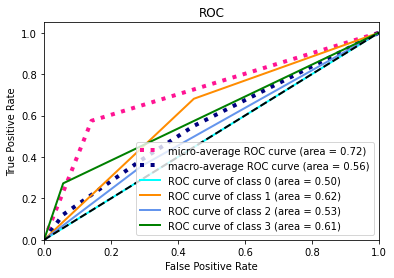

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 125  42   8]
 [  0  34  22   9]
 [  0   3  11   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560092 (macro),
0.602885 (weighted by prevalence)


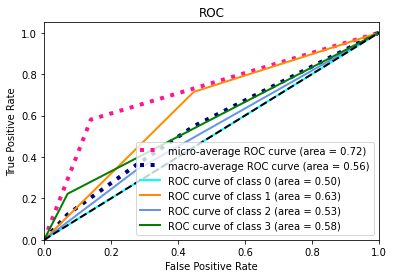

Accuracy: 54.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 120  53  11]
 [  0  24  13  10]
 [  0   8   9   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.545249 (macro),
0.570779 (weighted by prevalence)


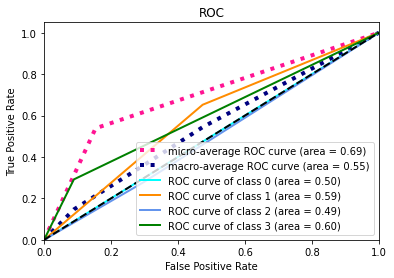

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 107  66   8]
 [  0  19  23   5]
 [  0   6  16   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565777 (macro),
0.602158 (weighted by prevalence)


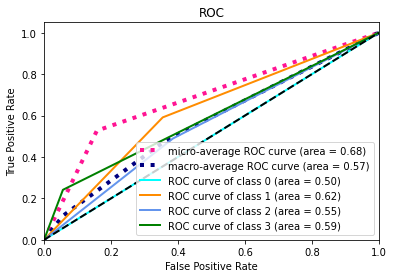

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 113  55  11]
 [  0  23  21   8]
 [  0   3  16   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.570357 (macro),
0.615715 (weighted by prevalence)


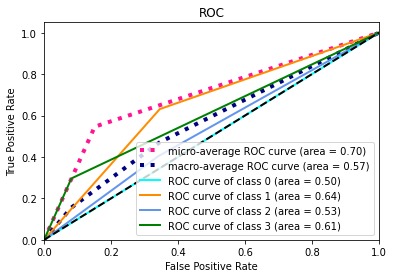

[I 2021-04-20 14:11:45,118] Trial 84 finished with value: 0.5611534066568667 and parameters: {'transformer_alpha': 0.2832119424700622, 'alpha': 6.541991536854352e-06, 'n_layers': 3, 'n_units_layers_0': 431, 'n_units_layers_1': 401, 'n_units_layers_2': 82, 'lr': 3.0598859537506206e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 136  41   8]
 [  0  25  11   6]
 [  0  13  13   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549577 (macro),
0.593727 (weighted by prevalence)


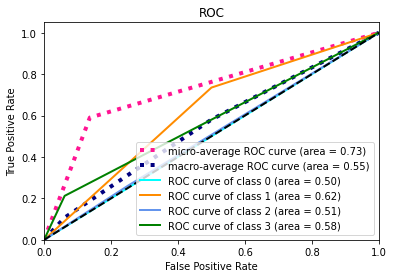

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 128  39   7]
 [  0  32  25   8]
 [  0   2  14   2]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.559076 (macro),
0.622726 (weighted by prevalence)


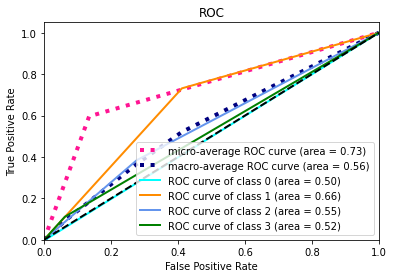

Accuracy: 61.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 138  39   7]
 [  0  24  13  10]
 [  0  10   7   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565696 (macro),
0.603654 (weighted by prevalence)


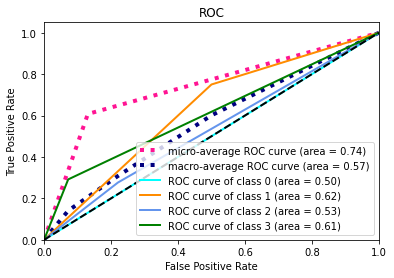

Accuracy: 56.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 116  55  10]
 [  0  23  21   3]
 [  0   8  13   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.569706 (macro),
0.597047 (weighted by prevalence)


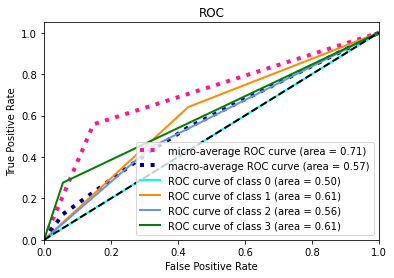

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 129  39  11]
 [  0  31  13   8]
 [  0  11  11   5]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.536340 (macro),
0.567430 (weighted by prevalence)


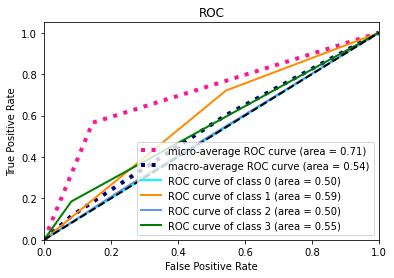

[I 2021-04-20 14:20:27,561] Trial 85 finished with value: 0.5560790019062455 and parameters: {'transformer_alpha': 0.2705445998260196, 'alpha': 2.0270221758735992e-05, 'n_layers': 3, 'n_units_layers_0': 463, 'n_units_layers_1': 427, 'n_units_layers_2': 122, 'lr': 6.792067671381129e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 64.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 149  29   7]
 [  0  27  11   4]
 [  0  15  10   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564702 (macro),
0.603941 (weighted by prevalence)


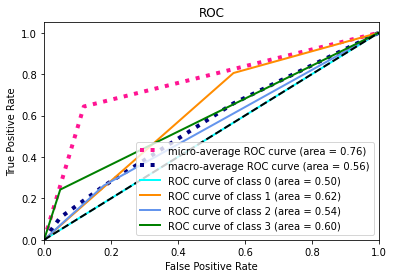

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 131  35   9]
 [  0  32  27   6]
 [  0   5  10   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573210 (macro),
0.627530 (weighted by prevalence)


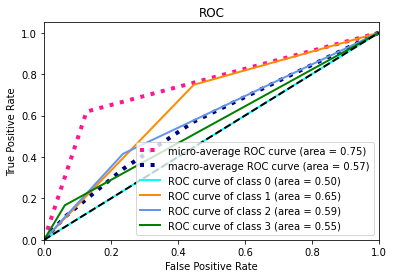

Accuracy: 52.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 116  55  13]
 [  0  20  19   8]
 [  0   7  16   1]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.529123 (macro),
0.578315 (weighted by prevalence)


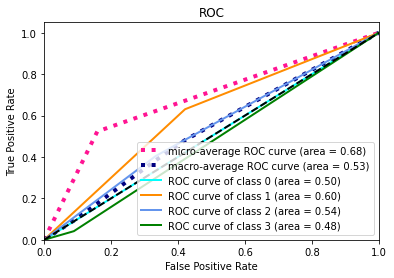

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 124  47  10]
 [  0  30  15   2]
 [  0   8  13   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553434 (macro),
0.573687 (weighted by prevalence)


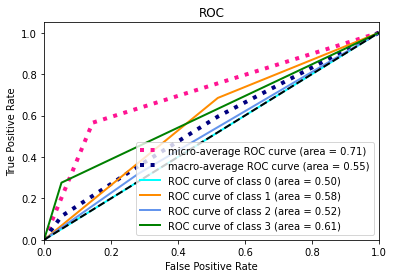

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 125  40  14]
 [  0  25  21   6]
 [  0   5  16   6]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.571783 (macro),
0.624935 (weighted by prevalence)


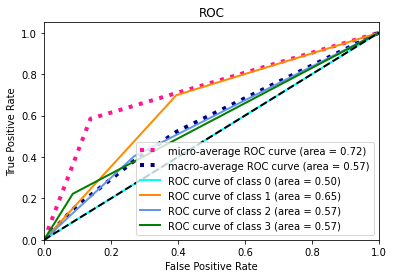

[I 2021-04-20 14:25:27,883] Trial 86 finished with value: 0.5584504799359158 and parameters: {'transformer_alpha': 0.3212481769915669, 'alpha': 1.02512898446447e-05, 'n_layers': 3, 'n_units_layers_0': 490, 'n_units_layers_1': 318, 'n_units_layers_2': 67, 'lr': 9.009817579899328e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 56.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 127  47  11]
 [  0  25  10   7]
 [  0   9  14  10]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552274 (macro),
0.595290 (weighted by prevalence)


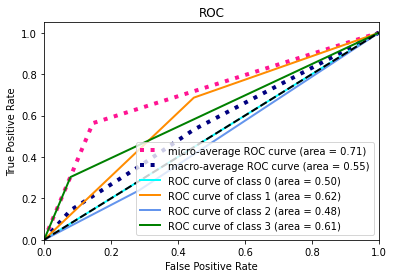

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 124  43   7]
 [  0  34  25   6]
 [  0   3  12   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558503 (macro),
0.604083 (weighted by prevalence)


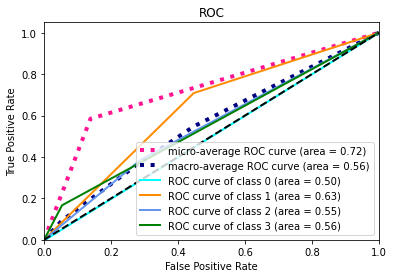

Accuracy: 54.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 113  62   9]
 [  0  21  20   6]
 [  0   5  12   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.565115 (macro),
0.594796 (weighted by prevalence)


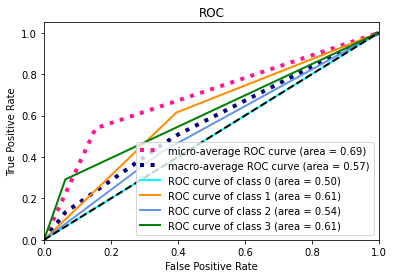

Accuracy: 47.0
Confusion matrix: 
[[ 0  2  1  0]
 [ 0 93 82  6]
 [ 0 17 25  5]
 [ 0  3 23  3]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540678 (macro),
0.588124 (weighted by prevalence)


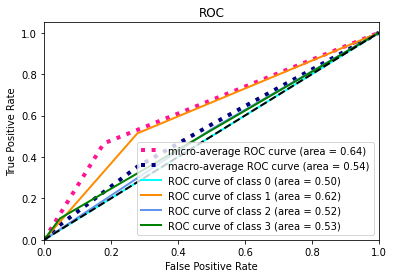

Accuracy: 56.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 109  58  12]
 [  0  19  25   8]
 [  0   5  11  11]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.594820 (macro),
0.630722 (weighted by prevalence)


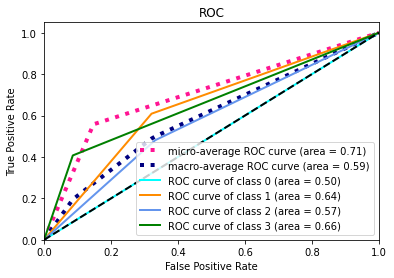

[I 2021-04-20 14:29:09,446] Trial 87 finished with value: 0.5622778529330137 and parameters: {'transformer_alpha': 0.23630291067006098, 'alpha': 5.011919198814424e-05, 'n_layers': 3, 'n_units_layers_0': 398, 'n_units_layers_1': 297, 'n_units_layers_2': 93, 'lr': 3.872619800911986e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 131  43  11]
 [  0  23  14   5]
 [  0  11  14   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562685 (macro),
0.608808 (weighted by prevalence)


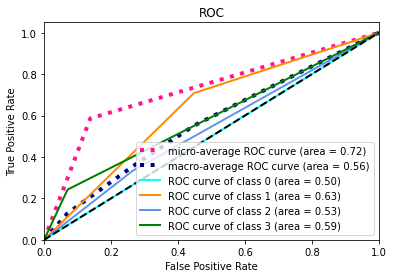

Accuracy: 55.0
Confusion matrix: 
[[  0   1   0   1]
 [  1 120  48   6]
 [  0  34  22   9]
 [  0   2  15   1]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.531421 (macro),
0.585819 (weighted by prevalence)


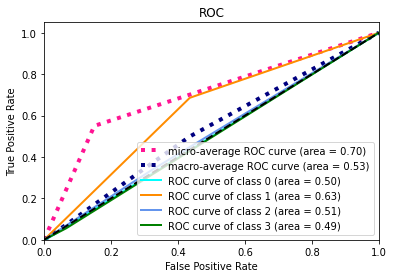

Accuracy: 61.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 133  44   7]
 [  0  21  16  10]
 [  0   6   9   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.588100 (macro),
0.633275 (weighted by prevalence)


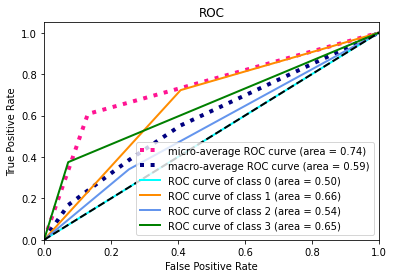

Accuracy: 58.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 128  45   8]
 [  0  29  17   1]
 [  0   9  14   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555105 (macro),
0.582528 (weighted by prevalence)


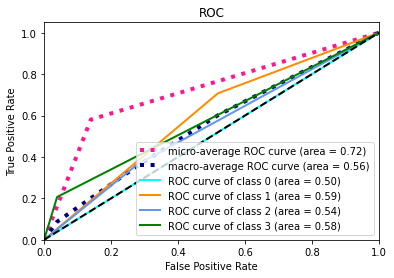

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 110  60   9]
 [  0  19  26   7]
 [  0   5  16   6]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572713 (macro),
0.622479 (weighted by prevalence)


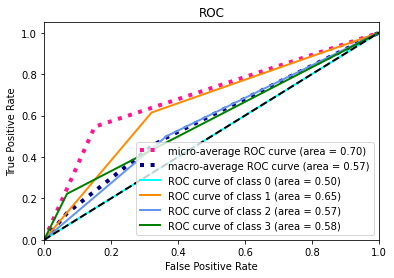

[I 2021-04-20 14:33:56,484] Trial 88 finished with value: 0.5620048761070062 and parameters: {'transformer_alpha': 0.46065110019897004, 'alpha': 0.00010345714006996246, 'n_layers': 3, 'n_units_layers_0': 419, 'n_units_layers_1': 274, 'n_units_layers_2': 51, 'lr': 3.026565791062225e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 42.0
Confusion matrix: 
[[  0   0   1   0]
 [  0  76 109   0]
 [  0   9  33   0]
 [  0   2  31   0]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550994 (macro),
0.605714 (weighted by prevalence)


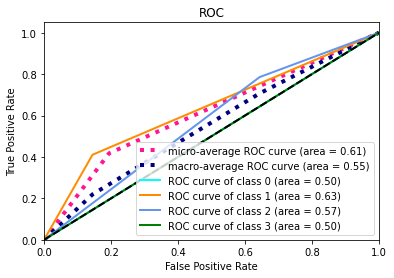

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  2 121  50   2]
 [  0  26  38   1]
 [  0   7  10   1]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.574829 (macro),
0.633515 (weighted by prevalence)


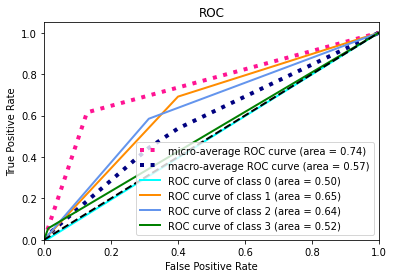

Accuracy: 71.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 184   0   0]
 [  0  47   0   0]
 [  0  24   0   0]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.500000 (macro),
0.500000 (weighted by prevalence)


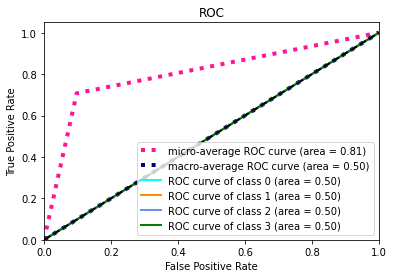

Accuracy: 47.0
Confusion matrix: 
[[  0   2   0   1]
 [  1 102  47  31]
 [  0  21   9  17]
 [  0   8   9  12]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.537186 (macro),
0.564336 (weighted by prevalence)


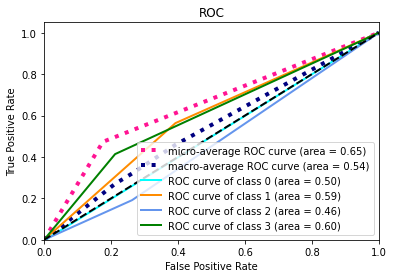

Accuracy: 59.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 132  34  12]
 [  0  34  12   6]
 [  0  11   6  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560611 (macro),
0.573158 (weighted by prevalence)


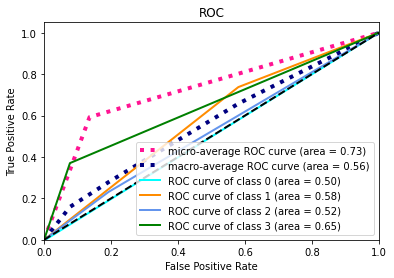

[I 2021-04-20 14:35:02,489] Trial 89 finished with value: 0.5447239808042175 and parameters: {'transformer_alpha': 0.3943136534588105, 'alpha': 2.185192549533031e-05, 'n_layers': 3, 'n_units_layers_0': 461, 'n_units_layers_1': 367, 'n_units_layers_2': 32, 'lr': 0.02425683712860621}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 59.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 139  38   8]
 [  0  29   8   5]
 [  0  14  11   8]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.540568 (macro),
0.570145 (weighted by prevalence)


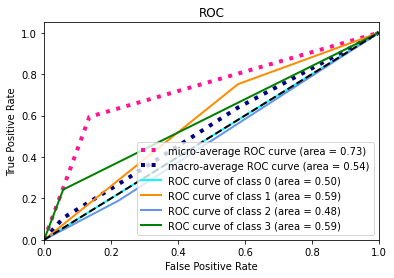

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  1 123  41  10]
 [  0  34  24   7]
 [  0   5   9   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.561007 (macro),
0.596875 (weighted by prevalence)


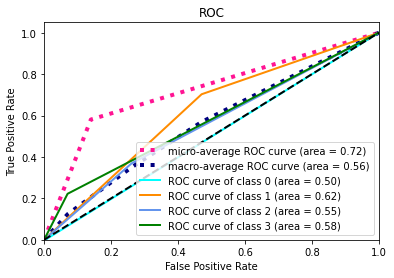

Accuracy: 63.0
Confusion matrix: 
[[  0   4   0   1]
 [  0 139  33  12]
 [  0  22  14  11]
 [  0   9   5  10]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.591169 (macro),
0.629688 (weighted by prevalence)


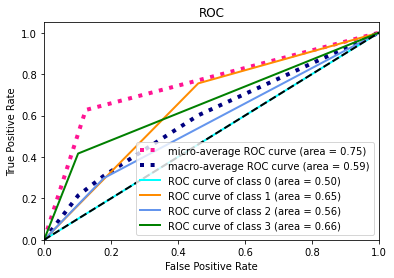

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 121  53   7]
 [  0  27  17   3]
 [  0  11   9   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560900 (macro),
0.573321 (weighted by prevalence)


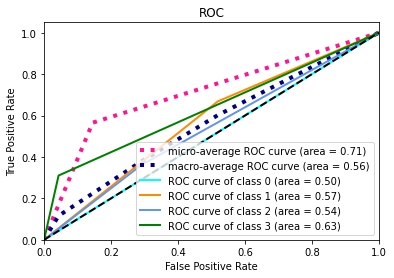

Accuracy: 56.0
Confusion matrix: 
[[  0   2   0   0]
 [  1 122  40  16]
 [  0  26  18   8]
 [  0  10  11   6]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553591 (macro),
0.589396 (weighted by prevalence)


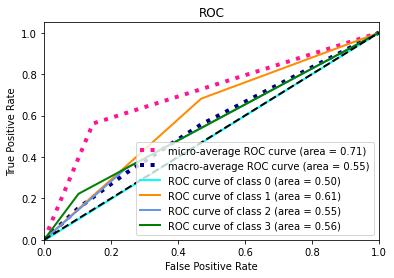

[I 2021-04-20 14:42:28,190] Trial 90 finished with value: 0.5614470226395014 and parameters: {'transformer_alpha': 0.2939550166102279, 'alpha': 5.288769799365785e-06, 'n_layers': 3, 'n_units_layers_0': 500, 'n_units_layers_1': 284, 'n_units_layers_2': 10, 'lr': 9.897928267268436e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 65.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 146  31   8]
 [  0  25  13   4]
 [  0  13   9  11]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.586525 (macro),
0.630077 (weighted by prevalence)


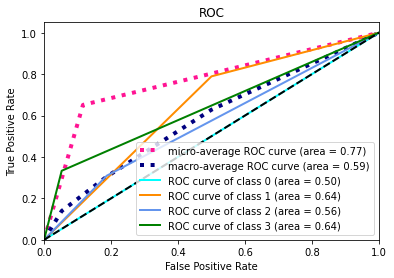

Accuracy: 60.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 127  42   6]
 [  1  34  24   6]
 [  0   5   8   5]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572562 (macro),
0.603887 (weighted by prevalence)


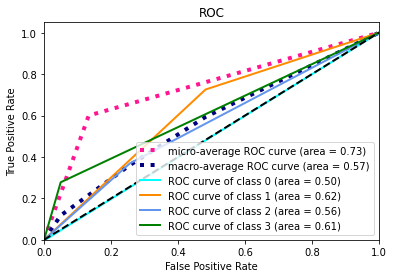

Accuracy: 58.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 121  54   9]
 [  0  18  20   9]
 [  0   6   9   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.589122 (macro),
0.627419 (weighted by prevalence)


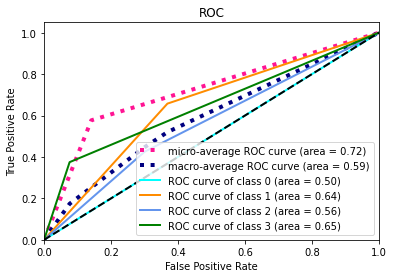

Accuracy: 59.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 131  40  10]
 [  0  31  14   2]
 [  0  11  10   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555148 (macro),
0.571845 (weighted by prevalence)


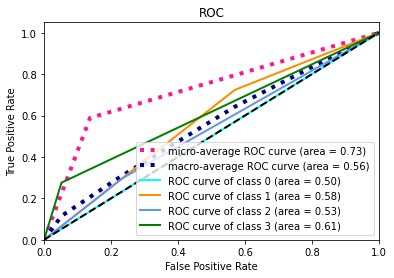

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 121  46  12]
 [  0  22  21   9]
 [  0   4  16   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575650 (macro),
0.633058 (weighted by prevalence)


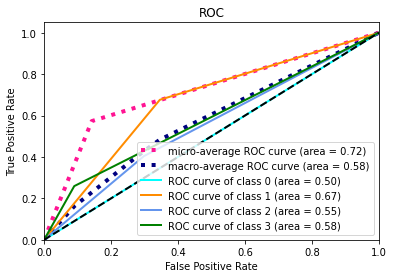

[I 2021-04-20 14:49:08,653] Trial 91 finished with value: 0.5758013880171038 and parameters: {'transformer_alpha': 0.3438723579916163, 'alpha': 4.1693737939270076e-05, 'n_layers': 3, 'n_units_layers_0': 478, 'n_units_layers_1': 339, 'n_units_layers_2': 41, 'lr': 5.659479096351189e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 63.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 133  41  11]
 [  0  20  18   4]
 [  0  12   8  13]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.603285 (macro),
0.642424 (weighted by prevalence)


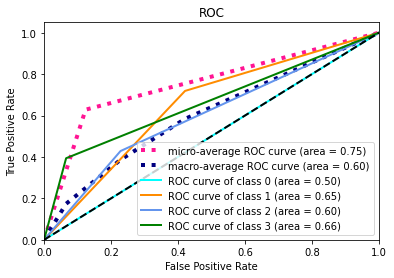

Accuracy: 61.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 131  37   7]
 [  0  37  24   4]
 [  0   5  10   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560872 (macro),
0.601255 (weighted by prevalence)


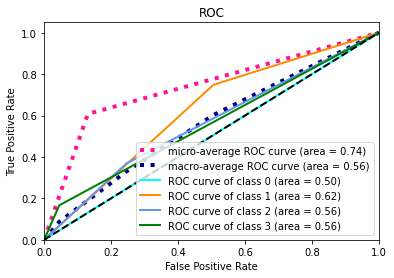

Accuracy: 57.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 124  52   8]
 [  0  23  16   8]
 [  0   5  10   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575589 (macro),
0.607688 (weighted by prevalence)


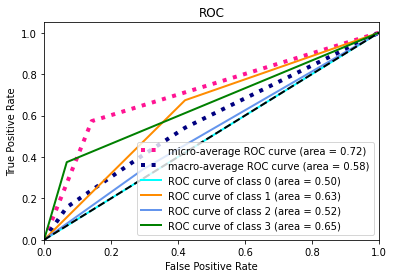

Accuracy: 59.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 123  48  10]
 [  0  23  24   0]
 [  0   9  14   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577461 (macro),
0.611296 (weighted by prevalence)


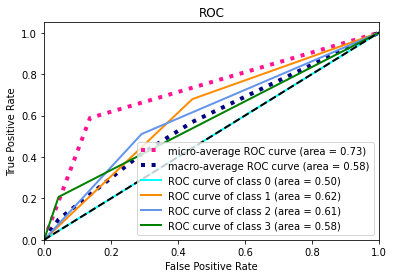

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 127  39  13]
 [  0  22  20  10]
 [  0   7  12   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.583916 (macro),
0.640459 (weighted by prevalence)


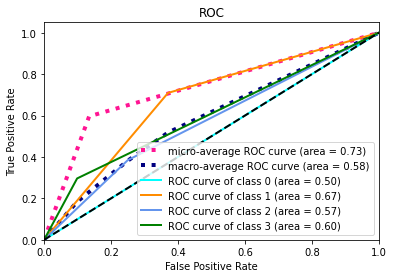

[I 2021-04-20 14:57:04,246] Trial 92 finished with value: 0.5802245260229875 and parameters: {'transformer_alpha': 0.3641859562735584, 'alpha': 2.5579053400509092e-05, 'n_layers': 3, 'n_units_layers_0': 475, 'n_units_layers_1': 346, 'n_units_layers_2': 75, 'lr': 4.919679308413465e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 142  34   9]
 [  0  26  12   4]
 [  0  17  10   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549778 (macro),
0.581561 (weighted by prevalence)


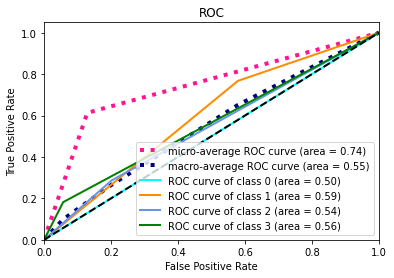

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 139  29   7]
 [  0  39  18   8]
 [  0   8   7   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.552680 (macro),
0.591784 (weighted by prevalence)


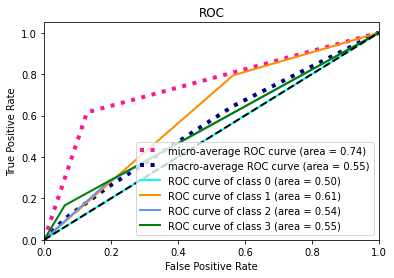

Accuracy: 59.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 131  41  12]
 [  0  21  16  10]
 [  0   9   8   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.571090 (macro),
0.612335 (weighted by prevalence)


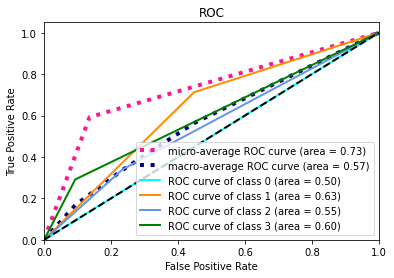

Accuracy: 58.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 125  49   7]
 [  1  24  19   3]
 [  0  10  11   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.571687 (macro),
0.601387 (weighted by prevalence)


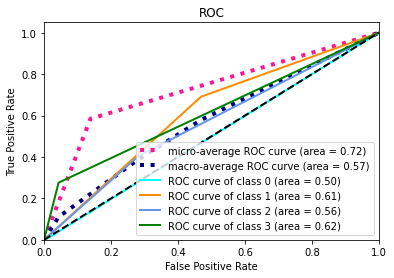

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 120  45  14]
 [  0  23  21   8]
 [  0   2  15  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.591049 (macro),
0.641892 (weighted by prevalence)


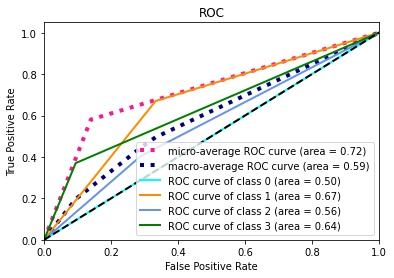

[I 2021-04-20 15:05:52,294] Trial 93 finished with value: 0.567256853565014 and parameters: {'transformer_alpha': 0.37545549352070534, 'alpha': 2.5249011432274047e-05, 'n_layers': 3, 'n_units_layers_0': 491, 'n_units_layers_1': 315, 'n_units_layers_2': 80, 'lr': 7.130488154211591e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   0]
 [  0 143  40   2]
 [  0  25  17   0]
 [  0  11  19   3]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562953 (macro),
0.617490 (weighted by prevalence)


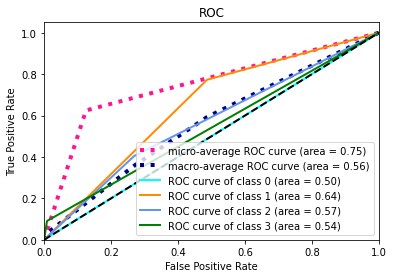

Accuracy: 61.0
Confusion matrix: 
[[  0   1   0   1]
 [  0 132  37   6]
 [  0  36  23   6]
 [  0   7   7   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566668 (macro),
0.601496 (weighted by prevalence)


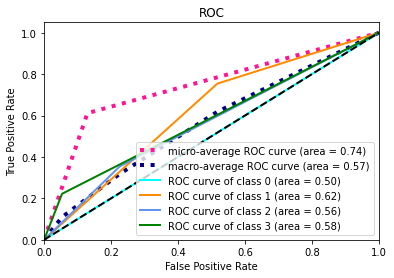

Accuracy: 58.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 126  49   9]
 [  0  23  17   7]
 [  0   4  12   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575573 (macro),
0.612383 (weighted by prevalence)


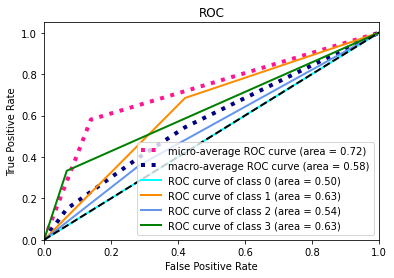

Accuracy: 57.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 119  52  10]
 [  0  23  23   1]
 [  0   6  16   7]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.577034 (macro),
0.614034 (weighted by prevalence)


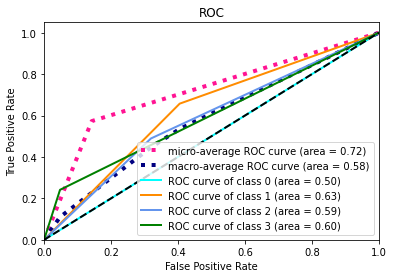

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 114  53  12]
 [  0  22  23   7]
 [  0   4  13  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.588127 (macro),
0.627734 (weighted by prevalence)


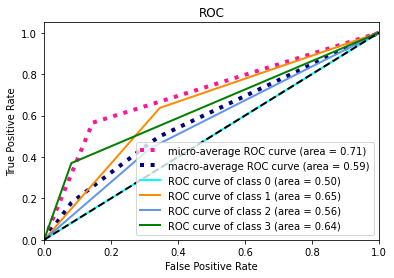

[I 2021-04-20 15:14:37,720] Trial 94 finished with value: 0.574071015072187 and parameters: {'transformer_alpha': 0.24101721036118812, 'alpha': 1.0725946884199402e-05, 'n_layers': 3, 'n_units_layers_0': 440, 'n_units_layers_1': 389, 'n_units_layers_2': 102, 'lr': 2.599485862946994e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 133  44   8]
 [  0  22  16   4]
 [  0  13  14   6]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.562391 (macro),
0.608718 (weighted by prevalence)


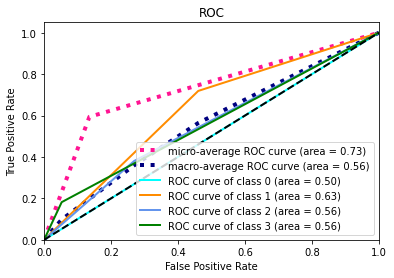

Accuracy: 58.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 125  45   5]
 [  1  35  22   7]
 [  0   4  10   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557967 (macro),
0.594385 (weighted by prevalence)


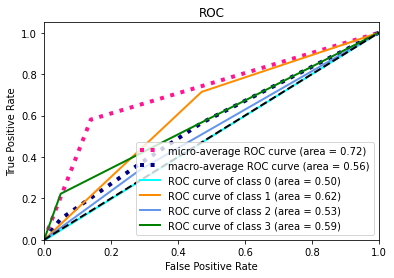

Accuracy: 58.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 128  45  11]
 [  0  21  15  11]
 [  0   6   9   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.578809 (macro),
0.620334 (weighted by prevalence)


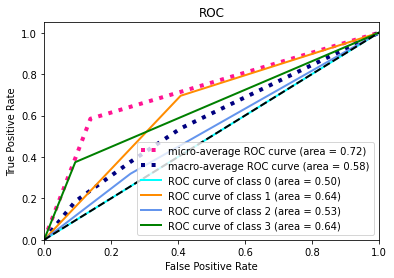

Accuracy: 55.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 114  60   7]
 [  0  25  19   3]
 [  0  10  10   9]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.561437 (macro),
0.573529 (weighted by prevalence)


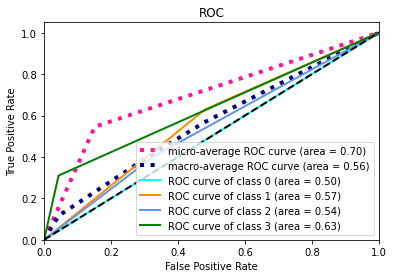

Accuracy: 57.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 120  47  12]
 [  0  24  20   8]
 [  0   6  14   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.567512 (macro),
0.612916 (weighted by prevalence)


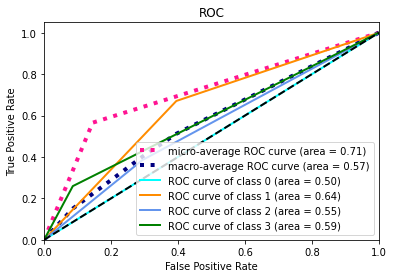

[I 2021-04-20 15:23:18,661] Trial 95 finished with value: 0.5656231327679854 and parameters: {'transformer_alpha': 0.306231274832458, 'alpha': 0.00014720866932437895, 'n_layers': 3, 'n_units_layers_0': 470, 'n_units_layers_1': 415, 'n_units_layers_2': 112, 'lr': 4.333574247828325e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 60.0
Confusion matrix: 
[[  0   0   1   0]
 [  1 135  43   6]
 [  0  24  15   3]
 [  0  12  14   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.564644 (macro),
0.609078 (weighted by prevalence)


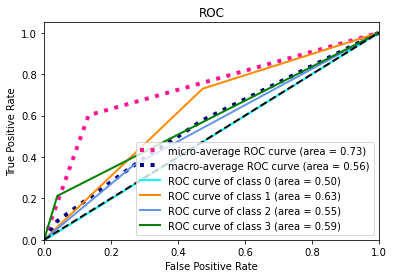

Accuracy: 59.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 123  49   3]
 [  0  35  27   3]
 [  0   5  10   3]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.558759 (macro),
0.592581 (weighted by prevalence)


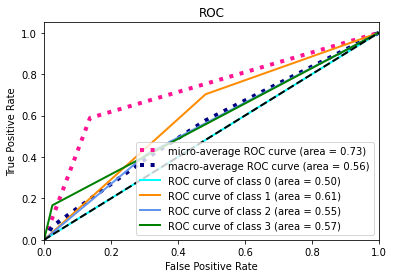

Accuracy: 56.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 121  54   9]
 [  0  23  18   6]
 [  0   4  13   7]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566636 (macro),
0.600417 (weighted by prevalence)


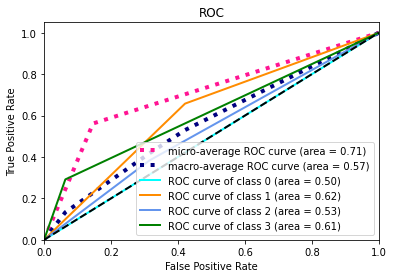

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 110  65   6]
 [  0  22  23   2]
 [  0   7  18   4]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.550708 (macro),
0.585317 (weighted by prevalence)


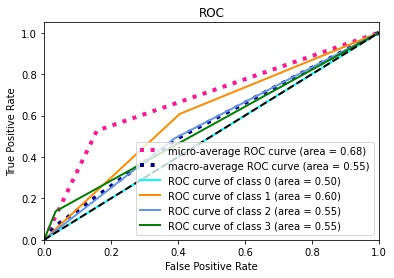

Accuracy: 54.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 114  55  10]
 [  0  24  20   8]
 [  0   5  15   7]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.560530 (macro),
0.601746 (weighted by prevalence)


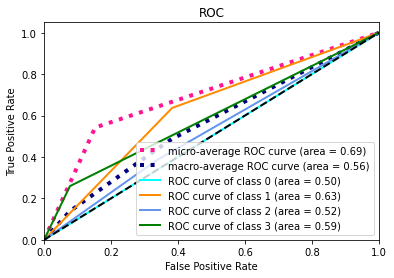

[I 2021-04-20 15:30:08,708] Trial 96 finished with value: 0.560255169382202 and parameters: {'transformer_alpha': 0.21074302095694541, 'alpha': 7.16296757131359e-05, 'n_layers': 3, 'n_units_layers_0': 455, 'n_units_layers_1': 306, 'n_units_layers_2': 129, 'lr': 2.103032467584953e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 62.0
Confusion matrix: 
[[  0   1   0   0]
 [  1 144  36   4]
 [  0  29   9   4]
 [  0  15   9   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.553609 (macro),
0.581741 (weighted by prevalence)


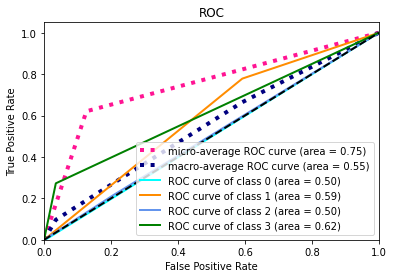

Accuracy: 62.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 144  24   7]
 [  0  41  14  10]
 [  0   9   5   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.554546 (macro),
0.587953 (weighted by prevalence)


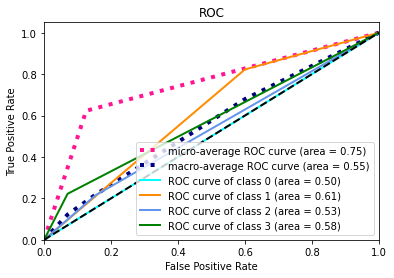

Accuracy: 60.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 132  44   8]
 [  0  21  15  11]
 [  0   9   6   9]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.580528 (macro),
0.616343 (weighted by prevalence)


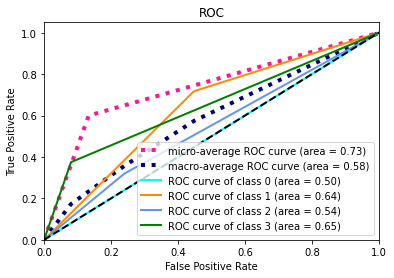

Accuracy: 59.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 130  42   9]
 [  0  26  17   4]
 [  0  12  11   6]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.557843 (macro),
0.587955 (weighted by prevalence)


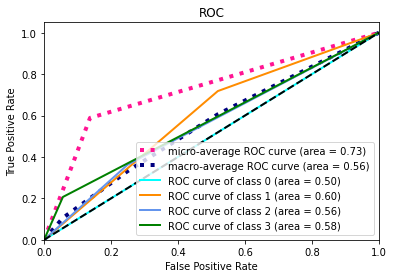

Accuracy: 61.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 135  34  10]
 [  0  25  14  13]
 [  0   7  10  10]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.582973 (macro),
0.634998 (weighted by prevalence)


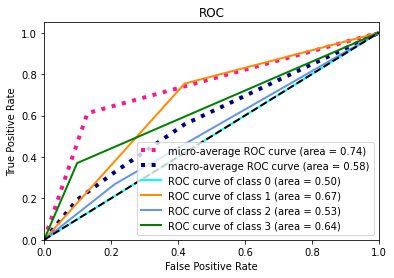

[I 2021-04-20 15:41:55,499] Trial 97 finished with value: 0.5658999129704323 and parameters: {'transformer_alpha': 0.4157951941023086, 'alpha': 1.7526615940919496e-05, 'n_layers': 3, 'n_units_layers_0': 424, 'n_units_layers_1': 453, 'n_units_layers_2': 62, 'lr': 6.923901909873624e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 57.0
Confusion matrix: 
[[  0   0   0   1]
 [  0 121  51  13]
 [  0  18  20   4]
 [  0   9  17   7]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.574707 (macro),
0.627644 (weighted by prevalence)


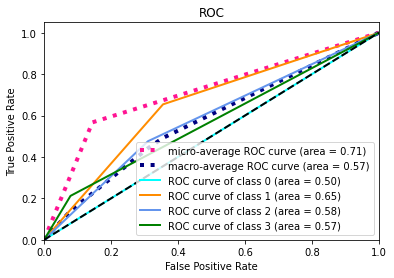

Accuracy: 60.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 125  46   4]
 [  1  30  27   7]
 [  0   3  11   4]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.575641 (macro),
0.626617 (weighted by prevalence)


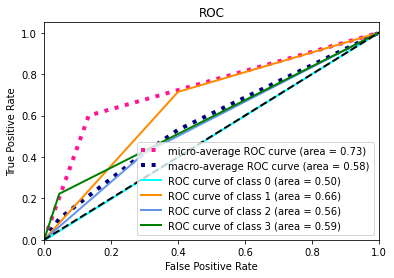

Accuracy: 57.0
Confusion matrix: 
[[  0   4   1   0]
 [  0 123  52   9]
 [  0  22  17   8]
 [  0   4  12   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.573947 (macro),
0.614032 (weighted by prevalence)


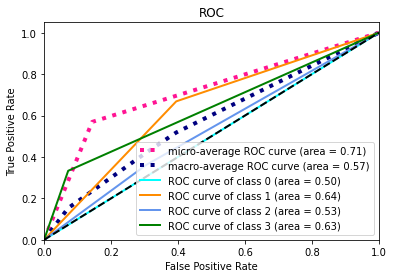

Accuracy: 53.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 114  62   5]
 [  0  25  18   4]
 [  0   4  20   5]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.544528 (macro),
0.585500 (weighted by prevalence)


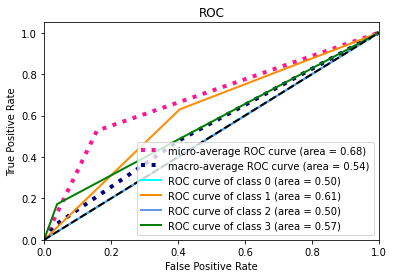

Accuracy: 55.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 116  49  14]
 [  0  26  20   6]
 [  0   5  16   6]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.556142 (macro),
0.597128 (weighted by prevalence)


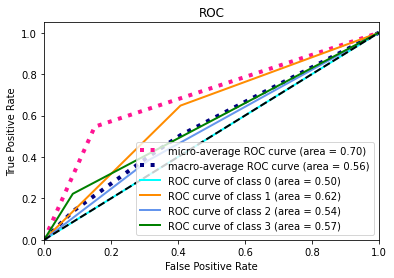

[I 2021-04-20 15:45:10,828] Trial 98 finished with value: 0.5649930408045988 and parameters: {'transformer_alpha': 0.33000007049797353, 'alpha': 2.8179391708502974e-05, 'n_layers': 3, 'n_units_layers_0': 357, 'n_units_layers_1': 322, 'n_units_layers_2': 86, 'lr': 3.280607194865458e-06}. Best is trial 81 with value: 0.5852642949837652.


Accuracy: 59.0
Confusion matrix: 
[[  0   0   1   0]
 [  0 135  41   9]
 [  0  27  10   5]
 [  0  15   9   9]]
Value counts in labels:
1    185
2     42
3     33
0      1
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.549205 (macro),
0.576544 (weighted by prevalence)


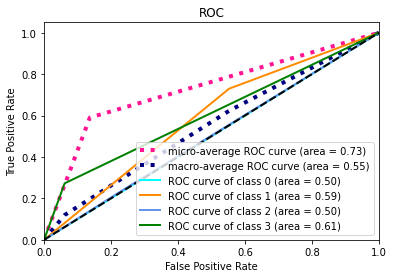

Accuracy: 63.0
Confusion matrix: 
[[  0   1   1   0]
 [  0 141  29   5]
 [  0  40  16   9]
 [  0   7   5   6]]
Value counts in labels:
1    175
2     65
3     18
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.572895 (macro),
0.598978 (weighted by prevalence)


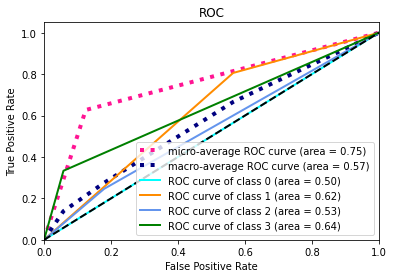

Accuracy: 63.0
Confusion matrix: 
[[  0   5   0   0]
 [  0 145  26  13]
 [  0  27  11   9]
 [  0  10   6   8]]
Value counts in labels:
1    184
2     47
3     24
0      5
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.569917 (macro),
0.601957 (weighted by prevalence)


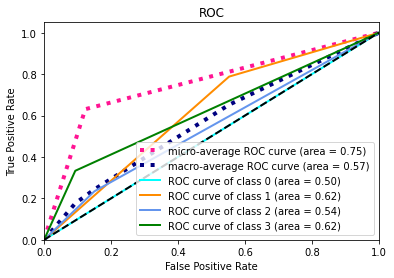

Accuracy: 58.0
Confusion matrix: 
[[  0   3   0   0]
 [  0 129  40  12]
 [  0  29  14   4]
 [  0  10  11   8]]
Value counts in labels:
1    181
2     47
3     29
0      3
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.555762 (macro),
0.579827 (weighted by prevalence)


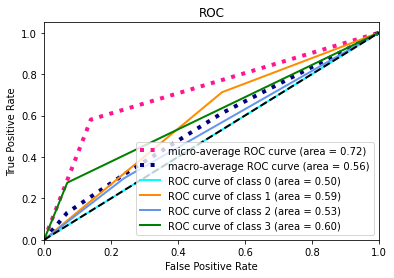

Accuracy: 58.0
Confusion matrix: 
[[  0   2   0   0]
 [  0 125  44  10]
 [  0  28  17   7]
 [  0   6  13   8]]
Value counts in labels:
1    179
2     52
3     27
0      2
Name: hs_bmi_c_cat, dtype: int64
One-vs-Rest ROC AUC scores:
0.566262 (macro),
0.604278 (weighted by prevalence)


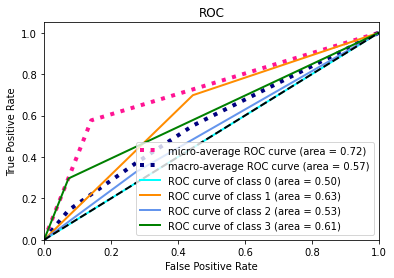

[I 2021-04-20 15:54:47,523] Trial 99 finished with value: 0.5628081189642117 and parameters: {'transformer_alpha': 0.26909779223879193, 'alpha': 1.383784115906521e-05, 'n_layers': 3, 'n_units_layers_0': 488, 'n_units_layers_1': 348, 'n_units_layers_2': 52, 'lr': 1.0430836690093157e-05}. Best is trial 81 with value: 0.5852642949837652.


Study statistics: 
  Number of finished trials:  100
  Number of pruned trials:  0
  Number of complete trials:  100
Best trial:
  Value:  0.5852642949837652
  Params: 
    transformer_alpha: 0.28680208711753563
    alpha: 9.704325532215102e-05
    n_layers: 3
    n_units_layers_0: 438
    n_units_layers_1: 343
    n_units_layers_2: 82
    lr: 4.319404041609115e-06


In [9]:
from optuna.trial import TrialState

direction = 'maximize'
if TARGET != Phenotypes.BODY_MASS_INDEX_CATEGORICAL and TARGET != Phenotypes.DIAGNOSED_ASTHMA:
    direction = 'minimize'
    
study = optuna.create_study(direction=direction)
study.optimize(objective_cv, n_trials=100, timeout=None, n_jobs=1, gc_after_trial=False)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

print("Best trial:")
trial = study.best_trial

print("  Value: ", trial.value)

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

### Save parameters

In [10]:
import configparser

config = configparser.ConfigParser()
config.read('config/config_mlp.ini')

n_layers = dict(trial.params.items())['n_layers']
n_units = ""
for i in range(n_layers):
    n_units = n_units + str(dict(trial.params.items())[f"n_units_layers_{i}"]) + ', '

params = {
    'n_layers' : n_layers,
    'n_units' : n_units,
    'learning_rate' : dict(trial.params.items())['lr'],
    'alpha': dict(trial.params.items())['alpha'],
    'transformer_alpha': dict(trial.params.items())['transformer_alpha'],
    'value' : trial.value
}
print(params)
config['BODY_MASS_INDEX_CATEGORICAL'] = params

with open('config/config_mlp.ini', 'w') as configfile:
    config.write(configfile)

{'n_layers': 3, 'n_units': '438, 343, 82, ', 'learning_rate': 4.319404041609115e-06, 'alpha': 9.704325532215102e-05, 'value': 0.5852642949837652}
